<a class="anchor" id='import'>
<font color = '#A3D5FF'>
    
# **0. Import Statement** 🔍</font>
</a>

In [ ]:
!pip install imbalanced-learn

import numpy as np
import pandas as pd
from scipy import stats
import matplotlib.pyplot as plt
import seaborn as sns
import math
import shap
from scipy.stats import (
    pearsonr, spearmanr, kendalltau, stats, probplot, shapiro,
    ttest_ind, mannwhitneyu, chi2_contingency, f_oneway, gaussian_kde
    )
from typing import Tuple, Dict, Any
from sklearn.preprocessing import PowerTransformer, RobustScaler, StandardScaler, OrdinalEncoder, OneHotEncoder
from itertools import combinations
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.pipeline import make_pipeline
from sklearn.svm import SVC
from xgboost import XGBClassifier
from sklearn.metrics import (
    classification_report,
    confusion_matrix,
    roc_auc_score,
    RocCurveDisplay,
    f1_score,
    average_precision_score,
    ConfusionMatrixDisplay,
    precision_recall_fscore_support,
)
from sklearn.utils.class_weight import compute_sample_weight
from sklearn.utils.validation import has_fit_parameter
from sklearn.utils import resample
from scipy.special import expit
from sklearn.impute import SimpleImputer
from sklearn.base import clone
import joblib
import warnings
from sklearn.exceptions import ConvergenceWarning
import os
import tensorflow as tf
from tensorflow.keras import layers, models, optimizers, callbacks
import random
from sklearn.utils import class_weight
from imblearn.over_sampling import SMOTE
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau, Callback
from sklearn.utils.class_weight import compute_class_weight
from sklearn.inspection import permutation_importance
from sklearn.svm import SVC

Let's download required files for plotting directly from the GitHub repository to make access easier for everyone, both now and in the future.

In [ ]:
!git clone https://github.com/CarlosBIOS/Bootcamp_NovaIMS.git

%cd Bootcamp_NovaIMS
!ls

Cloning into 'Bootcamp_NovaIMS'...
remote: Enumerating objects: 49, done.
remote: Counting objects: 100% (49/49), done.
remote: Compressing objects: 100% (46/46), done.
remote: Total 49 (delta 20), reused 7 (delta 3), pack-reused 0 (from 0)
Receiving objects: 100% (49/49), 35.72 MiB | 9.80 MiB/s, done.
Resolving deltas: 100% (20/20), done.
/content/Bootcamp_NovaIMS
BOOT_PROJ.ipynb		  X_train_one_hot.csv  y_train.csv
HR_Attrition_Dataset.csv  X_train_smote.csv    y_train_smote.csv
Project.ipynb		  X_val_one_hot.csv    y_val.csv
X_test_one_hot.csv	  y_test.csv


<a class="anchor" id='import'>
<font color = '#A3D5FF'>
    
# **1. Data Exploration** 🔍</font>
</a>

In this section, we begin our **exploratory data analysis** by importing the dataset and performing an initial inspection.

## 1.1 Gather basic information on the Dataset

In this section, we begin our **exploratory data analysis** by importing the dataset and performing an initial inspection. We load the HR Attrition Dataset from a CSV file and display the first few rows to gain an overview of its structure. We then examine the column names and retrieve basic information such as the dataset's shape and data types.

In [ ]:
hr_df = pd.read_csv('/content/Bootcamp_NovaIMS/HR_Attrition_Dataset.csv')
pd.set_option('display.max_columns', None)
hr_df

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,EnvironmentSatisfaction,Gender,HourlyRate,JobInvolvement,JobLevel,JobRole,JobSatisfaction,MaritalStatus,MonthlyIncome,MonthlyRate,NumCompaniesWorked,Over18,OverTime,PercentSalaryHike,PerformanceRating,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,Yes,Travel_Rarely,1102,Sales,1,2,Life Sciences,1,1,2,Female,94,3,2,Sales Executive,4,Single,5993,19479,8,Y,Yes,11,3,1,80,0,8,0,1,6,4,0,5
1,49,No,Travel_Frequently,279,Research & Development,8,1,Life Sciences,1,2,3,Male,61,2,2,Research Scientist,2,Married,5130,24907,1,Y,No,23,4,4,80,1,10,3,3,10,7,1,7
2,37,Yes,Travel_Rarely,1373,Research & Development,2,2,Other,1,4,4,Male,92,2,1,Laboratory Technician,3,Single,2090,2396,6,Y,Yes,15,3,2,80,0,7,3,3,0,0,0,0
3,33,No,Travel_Frequently,1392,Research & Development,3,4,Life Sciences,1,5,4,Female,56,3,1,Research Scientist,3,Married,2909,23159,1,Y,Yes,11,3,3,80,0,8,3,3,8,7,3,0
4,27,No,Travel_Rarely,591,Research & Development,2,1,Medical,1,7,1,Male,40,3,1,Laboratory Technician,2,Married,3468,16632,9,Y,No,12,3,4,80,1,6,3,3,2,2,2,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1465,36,No,Travel_Frequently,884,Research & Development,23,2,Medical,1,2061,3,Male,41,4,2,Laboratory Technician,4,Married,2571,12290,4,Y,No,17,3,3,80,1,17,3,3,5,2,0,3
1466,39,No,Travel_Rarely,613,Research & Development,6,1,Medical,1,2062,4,Male,42,2,3,Healthcare Representative,1,Married,9991,21457,4,Y,No,15,3,1,80,1,9,5,3,7,7,1,7
1467,27,No,Travel_Rarely,155,Research & Development,4,3,Life Sciences,1,2064,2,Male,87,4,2,Manufacturing Director,2,Married,6142,5174,1,Y,Yes,20,4,2,80,1,6,0,3,6,2,0,3
1468,49,No,Travel_Frequently,1023,Sales,2,3,Medical,1,2065,4,Male,63,2,2,Sales Executive,2,Married,5390,13243,2,Y,No,14,3,4,80,0,17,3,2,9,6,0,8


In [ ]:
hr_df.duplicated().sum()

np.int64(0)

Therefore, there are no duplicates in your dataframe. Having no duplicates ensures data integrity, prevents biased results, and improves model reliability.

To get a better understanding of the data, we will examine the various columns to identify potential relationships between them.

In [ ]:
hr_df.columns

Index(['Age', 'Attrition', 'BusinessTravel', 'DailyRate', 'Department',
       'DistanceFromHome', 'Education', 'EducationField', 'EmployeeCount',
       'EmployeeNumber', 'EnvironmentSatisfaction', 'Gender', 'HourlyRate',
       'JobInvolvement', 'JobLevel', 'JobRole', 'JobSatisfaction',
       'MaritalStatus', 'MonthlyIncome', 'MonthlyRate', 'NumCompaniesWorked',
       'Over18', 'OverTime', 'PercentSalaryHike', 'PerformanceRating',
       'RelationshipSatisfaction', 'StandardHours', 'StockOptionLevel',
       'TotalWorkingYears', 'TrainingTimesLastYear', 'WorkLifeBalance',
       'YearsAtCompany', 'YearsInCurrentRole', 'YearsSinceLastPromotion',
       'YearsWithCurrManager'],
      dtype='object')

In [ ]:
hr_df['EmployeeNumber']

,EmployeeNumber
0,1
1,2
2,4
3,5
4,7
...,...
1465,2061
1466,2062
1467,2064
1468,2065


In [ ]:
hr_df['EmployeeNumber'].duplicated().any()

np.False_

We choose `EmployeeNumber` as the index because it is a unique identifier for each employee. Using it as the index improves data organization, makes it easier to locate specific records, and avoids confusion when merging or joining datasets. Since it carries no predictive value, it will not affect the modeling process.

In [ ]:
hr_df.set_index("EmployeeNumber", inplace=True)
hr_df

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EnvironmentSatisfaction,Gender,HourlyRate,JobInvolvement,JobLevel,JobRole,JobSatisfaction,MaritalStatus,MonthlyIncome,MonthlyRate,NumCompaniesWorked,Over18,OverTime,PercentSalaryHike,PerformanceRating,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
EmployeeNumber,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1,41,Yes,Travel_Rarely,1102,Sales,1,2,Life Sciences,1,2,Female,94,3,2,Sales Executive,4,Single,5993,19479,8,Y,Yes,11,3,1,80,0,8,0,1,6,4,0,5
2,49,No,Travel_Frequently,279,Research & Development,8,1,Life Sciences,1,3,Male,61,2,2,Research Scientist,2,Married,5130,24907,1,Y,No,23,4,4,80,1,10,3,3,10,7,1,7
4,37,Yes,Travel_Rarely,1373,Research & Development,2,2,Other,1,4,Male,92,2,1,Laboratory Technician,3,Single,2090,2396,6,Y,Yes,15,3,2,80,0,7,3,3,0,0,0,0
5,33,No,Travel_Frequently,1392,Research & Development,3,4,Life Sciences,1,4,Female,56,3,1,Research Scientist,3,Married,2909,23159,1,Y,Yes,11,3,3,80,0,8,3,3,8,7,3,0
7,27,No,Travel_Rarely,591,Research & Development,2,1,Medical,1,1,Male,40,3,1,Laboratory Technician,2,Married,3468,16632,9,Y,No,12,3,4,80,1,6,3,3,2,2,2,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2061,36,No,Travel_Frequently,884,Research & Development,23,2,Medical,1,3,Male,41,4,2,Laboratory Technician,4,Married,2571,12290,4,Y,No,17,3,3,80,1,17,3,3,5,2,0,3
2062,39,No,Travel_Rarely,613,Research & Development,6,1,Medical,1,4,Male,42,2,3,Healthcare Representative,1,Married,9991,21457,4,Y,No,15,3,1,80,1,9,5,3,7,7,1,7
2064,27,No,Travel_Rarely,155,Research & Development,4,3,Life Sciences,1,2,Male,87,4,2,Manufacturing Director,2,Married,6142,5174,1,Y,Yes,20,4,2,80,1,6,0,3,6,2,0,3


Finally, we use `.info()` to get a concise summary of the dataset, including data types, non-null counts, and memory usage.

In [ ]:
hr_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1470 entries, 1 to 2068
Data columns (total 34 columns):
 #   Column                    Non-Null Count  Dtype 
---  ------                    --------------  ----- 
 0   Age                       1470 non-null   int64 
 1   Attrition                 1470 non-null   object
 2   BusinessTravel            1470 non-null   object
 3   DailyRate                 1470 non-null   int64 
 4   Department                1470 non-null   object
 5   DistanceFromHome          1470 non-null   int64 
 6   Education                 1470 non-null   int64 
 7   EducationField            1470 non-null   object
 8   EmployeeCount             1470 non-null   int64 
 9   EnvironmentSatisfaction   1470 non-null   int64 
 10  Gender                    1470 non-null   object
 11  HourlyRate                1470 non-null   int64 
 12  JobInvolvement            1470 non-null   int64 
 13  JobLevel                  1470 non-null   int64 
 14  JobRole                   147

The dataset contains 1,470 employees and 34 features, combining both numerical and categorical variables. **There are no missing values**, and each record is uniquely identified by `EmployeeNumber`. Most columns are numerical (25), while 9 are categorical, covering demographics, job characteristics, satisfaction levels, and compensation. This clean and well-structured dataset provides a solid foundation for exploratory analysis and predictive modeling of employee attrition.

## 1.2 Statistical Analysis

After gathering and inspecting the datasets, we proceed with a deeper statistical examination to uncover meaningful insights. This section focuses on descriptive statistics and identifying key trends across multiple tables.

This statistical exploration serves as a **foundation** for the subsequent steps in our study, guiding us toward effective preprocessing, normalization techniques, and deeper correlation assessments.

We begin by using the `.describe()` method to generate summary statistics for all numerical variables, including metrics such as count, mean, standard deviation, and range.

Additionally, we analyze the categorical variables by including `include='O'` and transposing the result for improved readability. This allows us to inspect the number of unique values, most frequent categories, and their frequencies across the dataset.

In [ ]:
hr_df.describe().T # transpose table to check all variables

,count,mean,std,min,25%,50%,75%,max
Age,1470.0,36.923810,9.135373,18.0,30.0,36.0,43.00,60.0
DailyRate,1470.0,802.485714,403.509100,102.0,465.0,802.0,1157.00,1499.0
DistanceFromHome,1470.0,9.192517,8.106864,1.0,2.0,7.0,14.00,29.0
Education,1470.0,2.912925,1.024165,1.0,2.0,3.0,4.00,5.0
EmployeeCount,1470.0,1.000000,0.000000,1.0,1.0,1.0,1.00,1.0
EnvironmentSatisfaction,1470.0,2.721769,1.093082,1.0,2.0,3.0,4.00,4.0
HourlyRate,1470.0,65.891156,20.329428,30.0,48.0,66.0,83.75,100.0
JobInvolvement,1470.0,2.729932,0.711561,1.0,2.0,3.0,3.00,4.0
JobLevel,1470.0,2.063946,1.106940,1.0,1.0,2.0,3.00,5.0
JobSatisfaction,1470.0,2.728571,1.102846,1.0,2.0,3.0,4.00,4.0


The dataset shows that employees are, on average, 37 years old, with most living relatively close to work (median of 7 km). Monthly income varies widely, with a median of around 4,900 and a maximum near 20,000, reflecting diverse job levels.

Job satisfaction, involvement, and work-life balance ratings cluster around medium values, while performance ratings are consistently high, mostly at level 3. Employees typically have around 11 years of total work experience, 7 years at the company, and 4 years in their current role.

Some variables such as `EmployeeCount` and `StandardHours` are constant, offering no predictive value. Overall, the statistics indicate a workforce with moderate tenure, stable satisfaction levels, and a broad income distribution.

The variable `PerformanceRating` shows very low variability in the dataset. Out of 1,470 observations, the mean is 3.15 with a standard deviation of only 0.36. The minimum value is 3.0 and the maximum is 4.0, meaning that all employees are rated either Excellent (3) or Outstanding (4). Since there are no records of lower ratings (1 = Low or 2 = Good), this feature provides limited discriminative power. For predictive modeling purposes, such a variable is unlikely to contribute useful information and may even introduce noise. Therefore, it is reasonable to either remove this feature entirely.

In [ ]:
hr_df.describe(include='O').T

,count,unique,top,freq
Attrition,1470,2,No,1233
BusinessTravel,1470,3,Travel_Rarely,1043
Department,1470,3,Research & Development,961
EducationField,1470,6,Life Sciences,606
Gender,1470,2,Male,882
JobRole,1470,9,Sales Executive,326
MaritalStatus,1470,3,Married,673
Over18,1470,1,Y,1470
OverTime,1470,2,No,1054


Most employees in the dataset have not left the company (1233 vs. 237). Business travel is predominantly rare, and the majority works in Research & Development, particularly within Life Sciences. Males are slightly more represented than females, and the most common job role is Sales Executive. Most employees are married, and overtime is not the norm. The `Over18` column provides no information since all employees are above 18.

In [ ]:
hr_df[hr_df['Attrition'] == 'Yes'].describe().T

,count,mean,std,min,25%,50%,75%,max
Age,237.0,33.607595,9.689350,18.0,28.0,32.0,39.0,58.0
DailyRate,237.0,750.362869,401.899519,103.0,408.0,699.0,1092.0,1496.0
DistanceFromHome,237.0,10.632911,8.452525,1.0,3.0,9.0,17.0,29.0
Education,237.0,2.839662,1.008244,1.0,2.0,3.0,4.0,5.0
EmployeeCount,237.0,1.000000,0.000000,1.0,1.0,1.0,1.0,1.0
EnvironmentSatisfaction,237.0,2.464135,1.169791,1.0,1.0,3.0,4.0,4.0
HourlyRate,237.0,65.573840,20.099958,31.0,50.0,66.0,84.0,100.0
JobInvolvement,237.0,2.518987,0.773405,1.0,2.0,3.0,3.0,4.0
JobLevel,237.0,1.637131,0.940594,1.0,1.0,1.0,2.0,5.0
JobSatisfaction,237.0,2.468354,1.118058,1.0,1.0,3.0,3.0,4.0


In [ ]:
hr_df[hr_df['Attrition'] == 'No'].describe().T

,count,mean,std,min,25%,50%,75%,max
Age,1233.0,37.561233,8.888360,18.0,31.0,36.0,43.0,60.0
DailyRate,1233.0,812.504461,403.208379,102.0,477.0,817.0,1176.0,1499.0
DistanceFromHome,1233.0,8.915653,8.012633,1.0,2.0,7.0,13.0,29.0
Education,1233.0,2.927007,1.027002,1.0,2.0,3.0,4.0,5.0
EmployeeCount,1233.0,1.000000,0.000000,1.0,1.0,1.0,1.0,1.0
EnvironmentSatisfaction,1233.0,2.771290,1.071132,1.0,2.0,3.0,4.0,4.0
HourlyRate,1233.0,65.952149,20.380754,30.0,48.0,66.0,83.0,100.0
JobInvolvement,1233.0,2.770479,0.692050,1.0,2.0,3.0,3.0,4.0
JobLevel,1233.0,2.145985,1.117933,1.0,1.0,2.0,3.0,5.0
JobSatisfaction,1233.0,2.778589,1.093277,1.0,2.0,3.0,4.0,4.0


We should look at each variable in more detail to check for potential data cleaning targets

In [ ]:
for col in hr_df.columns:
  print(hr_df[col].value_counts(dropna=False, normalize=True), end='\n\n')

Age
35    0.053061
34    0.052381
36    0.046939
31    0.046939
29    0.046259
32    0.041497
30    0.040816
38    0.039456
33    0.039456
40    0.038776
37    0.034014
28    0.032653
27    0.032653
42    0.031293
39    0.028571
45    0.027891
41    0.027211
26    0.026531
44    0.022449
46    0.022449
43    0.021769
50    0.020408
25    0.017687
24    0.017687
49    0.016327
47    0.016327
55    0.014966
48    0.012925
51    0.012925
53    0.012925
54    0.012245
52    0.012245
22    0.010884
56    0.009524
58    0.009524
23    0.009524
21    0.008844
20    0.007483
59    0.006803
19    0.006122
18    0.005442
60    0.003401
57    0.002721
Name: proportion, dtype: float64

Attrition
No     0.838776
Yes    0.161224
Name: proportion, dtype: float64

BusinessTravel
Travel_Rarely        0.709524
Travel_Frequently    0.188435
Non-Travel           0.102041
Name: proportion, dtype: float64

DailyRate
691     0.004082
1082    0.003401
329     0.003401
530     0.003401
408     0.003401
       

The variable `Over18` shows no variability, as all 1,470 employees are marked with the same value ('Y'). Since it does not contribute any meaningful information or predictive power, this feature should be removed from the dataset.

<a class="anchor" id='import'>
<font color = '#A3D5FF'>
    
# **2. Preprocessing Data** 🛠️</font>
</a>

## 2.1 Data Reduction

During the data exploration phase, we identified several variables that provide no useful information for analysis or predictive modeling. Specifically, the columns `Over18`, `EmployeeCount`, and `StandardHours` present constant values across all 1,470 employees. Since these features lack variability, they do not contribute to explaining employee behavior or predicting attrition, and therefore should be removed from the dataset.

By removing these redundant or non-informative features, we reduce noise in the dataset, improve computational efficiency, and ensure that the models focus on variables that genuinely influence employee attrition.

In [ ]:
cols_to_drop = ["Over18", "EmployeeCount", "StandardHours", "PerformanceRating"]
hr_df.drop(columns=cols_to_drop, inplace=True)
hr_df

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EnvironmentSatisfaction,Gender,HourlyRate,JobInvolvement,JobLevel,JobRole,JobSatisfaction,MaritalStatus,MonthlyIncome,MonthlyRate,NumCompaniesWorked,OverTime,PercentSalaryHike,RelationshipSatisfaction,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
EmployeeNumber,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1,41,Yes,Travel_Rarely,1102,Sales,1,2,Life Sciences,2,Female,94,3,2,Sales Executive,4,Single,5993,19479,8,Yes,11,1,0,8,0,1,6,4,0,5
2,49,No,Travel_Frequently,279,Research & Development,8,1,Life Sciences,3,Male,61,2,2,Research Scientist,2,Married,5130,24907,1,No,23,4,1,10,3,3,10,7,1,7
4,37,Yes,Travel_Rarely,1373,Research & Development,2,2,Other,4,Male,92,2,1,Laboratory Technician,3,Single,2090,2396,6,Yes,15,2,0,7,3,3,0,0,0,0
5,33,No,Travel_Frequently,1392,Research & Development,3,4,Life Sciences,4,Female,56,3,1,Research Scientist,3,Married,2909,23159,1,Yes,11,3,0,8,3,3,8,7,3,0
7,27,No,Travel_Rarely,591,Research & Development,2,1,Medical,1,Male,40,3,1,Laboratory Technician,2,Married,3468,16632,9,No,12,4,1,6,3,3,2,2,2,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2061,36,No,Travel_Frequently,884,Research & Development,23,2,Medical,3,Male,41,4,2,Laboratory Technician,4,Married,2571,12290,4,No,17,3,1,17,3,3,5,2,0,3
2062,39,No,Travel_Rarely,613,Research & Development,6,1,Medical,4,Male,42,2,3,Healthcare Representative,1,Married,9991,21457,4,No,15,1,1,9,5,3,7,7,1,7
2064,27,No,Travel_Rarely,155,Research & Development,4,3,Life Sciences,2,Male,87,4,2,Manufacturing Director,2,Married,6142,5174,1,Yes,20,2,1,6,0,3,6,2,0,3


## 2.2 Feature Engineering: Creating new variables

% of career spent at this company

In [ ]:
hr_df['CareerAtCompany_ratio'] = np.where(
hr_df['TotalWorkingYears'] > 0,
hr_df['YearsAtCompany'] / hr_df['TotalWorkingYears'],
0
)

Stability in current role

In [ ]:
hr_df['RoleStability_ratio'] = np.where(
hr_df['YearsAtCompany'] > 0,
hr_df['YearsInCurrentRole'] / hr_df['YearsAtCompany'],
0
)

Stability with current manager

In [ ]:
hr_df['ManagerStability_ratio'] = np.where(
hr_df['YearsAtCompany'] > 0,
hr_df['YearsWithCurrManager'] / hr_df['YearsAtCompany'],
0
)

Career starting age

In [ ]:
hr_df['CareerStart_Age'] = hr_df['Age'] - hr_df['TotalWorkingYears']

Income per year of experience

In [ ]:
hr_df['IncomePerExperience'] = np.where(
hr_df['TotalWorkingYears'] > 0,
hr_df['MonthlyIncome'] / hr_df['TotalWorkingYears'],
hr_df['MonthlyIncome']
)

Burnout risk categories

In [ ]:
hr_df['BurnoutRisk'] = np.where(
(hr_df['WorkLifeBalance'].isin([1, 2])) & (hr_df['OverTime'] == 'Yes'),'High',
np.where((hr_df['WorkLifeBalance'].isin([1, 2])) | (hr_df['OverTime'] == 'Yes'),'Low', 'Medium')
)

Satisfaction Rating

In [ ]:
satisfaction_cols = ['JobSatisfaction', 'EnvironmentSatisfaction', 'RelationshipSatisfaction']
if all(col in hr_df.columns for col in satisfaction_cols):
  hr_df['Satisfaction_Composite'] = hr_df[satisfaction_cols].mean(axis=1)

Stability Indicator

In [ ]:
hr_df['Stability_Score'] = (
hr_df['CareerAtCompany_ratio'] +
hr_df['RoleStability_ratio'] +
hr_df['ManagerStability_ratio']
) / 3

Work Stress Amplifier

In [ ]:
if all(col in hr_df.columns for col in ['OverTime', 'WorkLifeBalance', 'JobSatisfaction']):
  hr_df['Stress_Amplifier'] = (
  (hr_df['OverTime'] == 'Yes').astype(int) * 2 +
  (hr_df['WorkLifeBalance'] <= 2).astype(int) * 2 +
  (hr_df['JobSatisfaction'] <= 2).astype(int) * 1
)

In [ ]:
hr_df

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EnvironmentSatisfaction,Gender,HourlyRate,JobInvolvement,JobLevel,JobRole,JobSatisfaction,MaritalStatus,MonthlyIncome,MonthlyRate,NumCompaniesWorked,OverTime,PercentSalaryHike,RelationshipSatisfaction,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager,CareerAtCompany_ratio,RoleStability_ratio,ManagerStability_ratio,CareerStart_Age,IncomePerExperience,BurnoutRisk,Satisfaction_Composite,Stability_Score,Stress_Amplifier
EmployeeNumber,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1,41,Yes,Travel_Rarely,1102,Sales,1,2,Life Sciences,2,Female,94,3,2,Sales Executive,4,Single,5993,19479,8,Yes,11,1,0,8,0,1,6,4,0,5,0.750000,0.666667,0.833333,33,749.125000,High,2.333333,0.750000,4
2,49,No,Travel_Frequently,279,Research & Development,8,1,Life Sciences,3,Male,61,2,2,Research Scientist,2,Married,5130,24907,1,No,23,4,1,10,3,3,10,7,1,7,1.000000,0.700000,0.700000,39,513.000000,Medium,3.000000,0.800000,1
4,37,Yes,Travel_Rarely,1373,Research & Development,2,2,Other,4,Male,92,2,1,Laboratory Technician,3,Single,2090,2396,6,Yes,15,2,0,7,3,3,0,0,0,0,0.000000,0.000000,0.000000,30,298.571429,Low,3.000000,0.000000,2
5,33,No,Travel_Frequently,1392,Research & Development,3,4,Life Sciences,4,Female,56,3,1,Research Scientist,3,Married,2909,23159,1,Yes,11,3,0,8,3,3,8,7,3,0,1.000000,0.875000,0.000000,25,363.625000,Low,3.333333,0.625000,2
7,27,No,Travel_Rarely,591,Research & Development,2,1,Medical,1,Male,40,3,1,Laboratory Technician,2,Married,3468,16632,9,No,12,4,1,6,3,3,2,2,2,2,0.333333,1.000000,1.000000,21,578.000000,Medium,2.333333,0.777778,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2061,36,No,Travel_Frequently,884,Research & Development,23,2,Medical,3,Male,41,4,2,Laboratory Technician,4,Married,2571,12290,4,No,17,3,1,17,3,3,5,2,0,3,0.294118,0.400000,0.600000,19,151.235294,Medium,3.333333,0.431373,0
2062,39,No,Travel_Rarely,613,Research & Development,6,1,Medical,4,Male,42,2,3,Healthcare Representative,1,Married,9991,21457,4,No,15,1,1,9,5,3,7,7,1,7,0.777778,1.000000,1.000000,30,1110.111111,Medium,2.000000,0.925926,1
2064,27,No,Travel_Rarely,155,Research & Development,4,3,Life Sciences,2,Male,87,4,2,Manufacturing Director,2,Married,6142,5174,1,Yes,20,2,1,6,0,3,6,2,0,3,1.000000,0.333333,0.500000,21,1023.666667,Low,2.000000,0.611111,3


## 2.3 Bining

We will transform numerical variables that are in fact ordinal categories (e.g., JobSatisfaction, Education, WorkLifeBalance) into their corresponding categorical classes with an explicit order. Although these variables are encoded as integers in the dataset, the numbers themselves do not represent continuous quantities. Instead, they express an ordered ranking (for example, 1 = Low, 2 = Medium, 3 = High, 4 = Very High).

This transformation is recommended for two main reasons:

1. Data visualization

  * When plotting, categorical labels such as “Low”, “Medium”, “High” are far more interpretable than raw codes like 1, 2, 3.

  * Ordered categories preserve the natural sequence, so visualizations such as bar plots or box plots will respect the progression from low to high instead of treating the codes as arbitrary numbers.

2. Statistical tests and analysis

  * Many statistical techniques distinguish between nominal, ordinal, and continuous data. By explicitly declaring these features as ordered categories, the analysis will not incorrectly assume equal distances between numeric codes.

  * For example, in hypothesis testing, correlation analysis, or non-parametric tests (like Spearman’s rank correlation or Kruskal–Wallis test), treating these variables as ordered factors produces more accurate and meaningful results.

  * It also reduces the risk of misleading interpretations, such as assuming that the difference between “Low” and “Medium” is the same as between “High” and “Very High,” which may not be true.

3. Modeling benefits

+ In machine learning pipelines, distinguishing ordinal from continuous features allows for better preprocessing (e.g., ordinal encoding instead of standard scaling).

+ This helps models capture the correct relationships and prevents introducing artificial numerical biases.

In short, transforming ordinal numerical codes into ordered categorical variables enhances interpretability, improves visualization, and ensures the correct application of statistical methods.

In [ ]:
ORDINAL_SCALES = {
    "Education": ["Below College", "College", "Bachelor", "Master", "Doctor"],
    "EnvironmentSatisfaction": ["Low", "Medium", "High", "Very High"],
    "JobInvolvement": ["Low", "Medium", "High", "Very High"],
    "JobSatisfaction": ["Low", "Medium", "High", "Very High"],
    "PerformanceRating": ["Low", "Good", "Excellent", "Outstanding"],
    "RelationshipSatisfaction": ["Low", "Medium", "High", "Very High"],
    "WorkLifeBalance": ["Bad", "Good", "Better", "Best"],
    'OverTime': ['Yes', 'No'],
    'StockOptionLevel': ['None', 'One', 'Two', 'Three'],
    'JobLevel': ['HC Rep', 'HR', 'Lab Technician', 'Manager',
                 'Managing Director', 'Research Director']
    }

CODE_MAP = {
    "Education": {1: "Below College", 2: "College", 3: "Bachelor", 4: "Master", 5: "Doctor"},
    "EnvironmentSatisfaction": {1: "Low", 2: "Medium", 3: "High", 4: "Very High"},
    "JobInvolvement": {1: "Low", 2: "Medium", 3: "High", 4: "Very High"},
    "JobSatisfaction": {1: "Low", 2: "Medium", 3: "High", 4: "Very High"},
    "PerformanceRating": {1: "Low", 2: "Good", 3: "Excellent", 4: "Outstanding"},
    "RelationshipSatisfaction": {1: "Low", 2: "Medium", 3: "High", 4: "Very High"},
    "WorkLifeBalance": {1: "Bad", 2: "Good", 3: "Better", 4: "Best"},
    'OverTime': {1: 'Yes', 0: 'No'},
    'StockOptionLevel': {0: 'None', 1: 'One', 2: 'Two', 3: 'Three'},
    'JobLevel': {1: 'HC Rep', 2: 'HR', 3: 'Lab Technician', 4: 'Manager',
                 5: 'Managing Director', 6: 'Research Director'},
    }

def transform_ordinals(df: pd.DataFrame) -> pd.DataFrame:
    """
    Convert numeric ordinal columns into ordered pandas.Categorical with human-readable labels.
    Only transforms columns that exist in the given DataFrame.
    - Unmapped values are preserved as NaN (so you can detect data issues later).
    - The categorical order follows the semantic order in ORDINAL_SCALES.
    """
    out = df.copy()
    for col, ordered_labels in ORDINAL_SCALES.items():
        if col in out.columns:
            mapping = CODE_MAP[col]
            # Map codes -> labels (handles integers or strings of integers)
            out[col] = pd.to_numeric(out[col], errors="coerce").map(mapping)

            # Cast to ordered categorical with the correct semantic order
            dtype = pd.CategoricalDtype(categories=ordered_labels, ordered=True)
            out[col] = out[col].astype(dtype)
    return out


hr_df_with_all_cat = transform_ordinals(hr_df)
hr_df_with_all_cat

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EnvironmentSatisfaction,Gender,HourlyRate,JobInvolvement,JobLevel,JobRole,JobSatisfaction,MaritalStatus,MonthlyIncome,MonthlyRate,NumCompaniesWorked,OverTime,PercentSalaryHike,RelationshipSatisfaction,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager,CareerAtCompany_ratio,RoleStability_ratio,ManagerStability_ratio,CareerStart_Age,IncomePerExperience,BurnoutRisk,Satisfaction_Composite,Stability_Score,Stress_Amplifier
EmployeeNumber,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1,41,Yes,Travel_Rarely,1102,Sales,1,College,Life Sciences,Medium,Female,94,High,HR,Sales Executive,Very High,Single,5993,19479,8,NaN,11,Low,None,8,0,Bad,6,4,0,5,0.750000,0.666667,0.833333,33,749.125000,High,2.333333,0.750000,4
2,49,No,Travel_Frequently,279,Research & Development,8,Below College,Life Sciences,High,Male,61,Medium,HR,Research Scientist,Medium,Married,5130,24907,1,NaN,23,Very High,One,10,3,Better,10,7,1,7,1.000000,0.700000,0.700000,39,513.000000,Medium,3.000000,0.800000,1
4,37,Yes,Travel_Rarely,1373,Research & Development,2,College,Other,Very High,Male,92,Medium,HC Rep,Laboratory Technician,High,Single,2090,2396,6,NaN,15,Medium,None,7,3,Better,0,0,0,0,0.000000,0.000000,0.000000,30,298.571429,Low,3.000000,0.000000,2
5,33,No,Travel_Frequently,1392,Research & Development,3,Master,Life Sciences,Very High,Female,56,High,HC Rep,Research Scientist,High,Married,2909,23159,1,NaN,11,High,None,8,3,Better,8,7,3,0,1.000000,0.875000,0.000000,25,363.625000,Low,3.333333,0.625000,2
7,27,No,Travel_Rarely,591,Research & Development,2,Below College,Medical,Low,Male,40,High,HC Rep,Laboratory Technician,Medium,Married,3468,16632,9,NaN,12,Very High,One,6,3,Better,2,2,2,2,0.333333,1.000000,1.000000,21,578.000000,Medium,2.333333,0.777778,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2061,36,No,Travel_Frequently,884,Research & Development,23,College,Medical,High,Male,41,Very High,HR,Laboratory Technician,Very High,Married,2571,12290,4,NaN,17,High,One,17,3,Better,5,2,0,3,0.294118,0.400000,0.600000,19,151.235294,Medium,3.333333,0.431373,0
2062,39,No,Travel_Rarely,613,Research & Development,6,Below College,Medical,Very High,Male,42,Medium,Lab Technician,Healthcare Representative,Low,Married,9991,21457,4,NaN,15,Low,One,9,5,Better,7,7,1,7,0.777778,1.000000,1.000000,30,1110.111111,Medium,2.000000,0.925926,1
2064,27,No,Travel_Rarely,155,Research & Development,4,Bachelor,Life Sciences,Medium,Male,87,Very High,HR,Manufacturing Director,Medium,Married,6142,5174,1,NaN,20,Medium,One,6,0,Better,6,2,0,3,1.000000,0.333333,0.500000,21,1023.666667,Low,2.000000,0.611111,3


In [ ]:
hr_df_with_all_cat.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1470 entries, 1 to 2068
Data columns (total 39 columns):
 #   Column                    Non-Null Count  Dtype   
---  ------                    --------------  -----   
 0   Age                       1470 non-null   int64   
 1   Attrition                 1470 non-null   object  
 2   BusinessTravel            1470 non-null   object  
 3   DailyRate                 1470 non-null   int64   
 4   Department                1470 non-null   object  
 5   DistanceFromHome          1470 non-null   int64   
 6   Education                 1470 non-null   category
 7   EducationField            1470 non-null   object  
 8   EnvironmentSatisfaction   1470 non-null   category
 9   Gender                    1470 non-null   object  
 10  HourlyRate                1470 non-null   int64   
 11  JobInvolvement            1470 non-null   category
 12  JobLevel                  1470 non-null   category
 13  JobRole                   1470 non-null   object  
 1

## 2.4 Visual Exploration

In this section, we explore the dataset visually by calculating the **Spearman correlation matrix** for numerical variables, excluding irrelevant columns. The *correlation matrix* is displayed using a heatmap to identify relationships between variables.

Additionally, histograms, boxplots, and bar charts are generated to *analyze data distribution*, *detect outliers*, and gain further insights into the dataset.

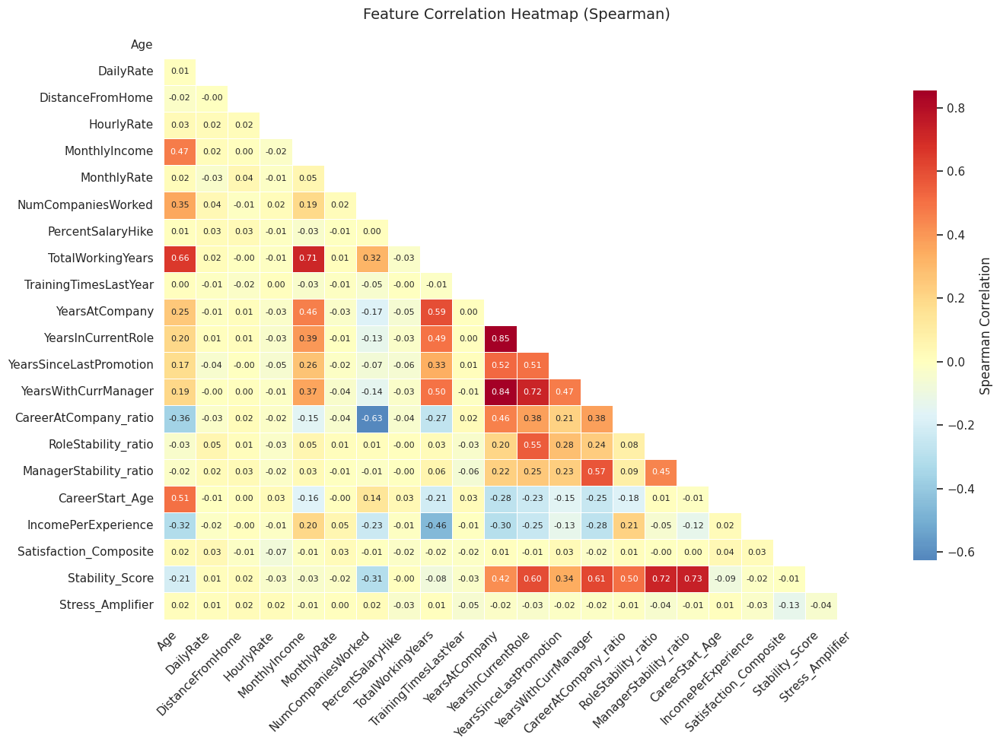

In [ ]:
# select rows with numeric values
hr_df_numeric = hr_df_with_all_cat.select_dtypes(include='number')

import matplotlib.pyplot as plt
import seaborn as sns

# Select numeric columns
hr_df_numeric = hr_df_with_all_cat.select_dtypes(include='number')

# Compute correlation (Spearman is fine for non-linear monotonic relationships)
corr = hr_df_numeric.corr(method='spearman')

# Mask upper triangle to avoid repetition
mask = np.triu(np.ones_like(corr, dtype=bool))

plt.figure(figsize=(14,10))
sns.set_theme(style="white")

# Create heatmap
sns.heatmap(
    corr,
    mask=mask,                 # show only lower triangle
    annot=True,                # show correlation numbers
    fmt=".2f",                 # two decimals
    cmap="RdYlBu_r",           # better diverging color palette
    center=0,                  # center around zero
    cbar_kws={'shrink': 0.8, 'label': 'Spearman Correlation'},
    annot_kws={"size":8},
    linewidths=0.5
)

plt.title("Feature Correlation Heatmap (Spearman)", fontsize=14, pad=12)
plt.xticks(rotation=45, ha='right')
plt.yticks(rotation=0)
plt.tight_layout()
plt.show()

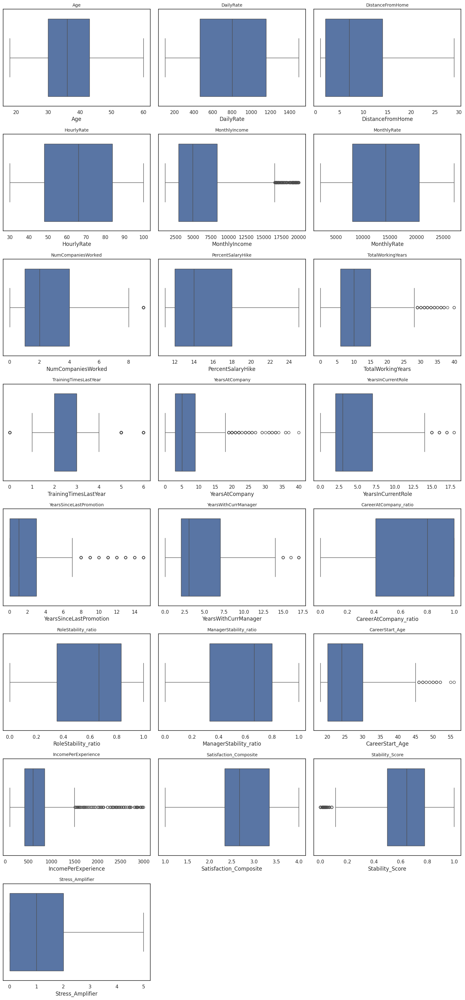

In [ ]:
# Select numeric columns
numeric_cols = hr_df_with_all_cat.select_dtypes(include='number').columns

# Define number of plots per row
n_cols = 3
n_rows = math.ceil(len(numeric_cols) / n_cols)

# Create the figure
fig, axes = plt.subplots(n_rows, n_cols, figsize=(5 * n_cols, 4 * n_rows))
axes = axes.flatten()

# Generate boxplots for each column
for i, col in enumerate(numeric_cols):
    sns.boxplot(ax=axes[i], data=hr_df, x=col)
    axes[i].set_title(col, fontsize=10)

# Remove empty axes if grid is larger than needed
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

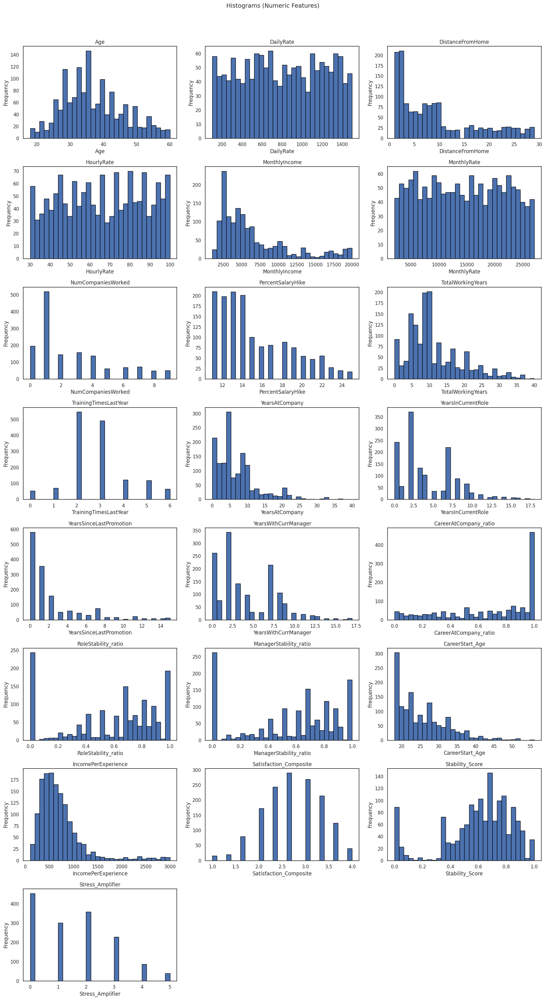

In [ ]:
num_cols = numeric_cols.tolist()
n_cols = 3
n_rows = math.ceil(len(num_cols) / n_cols) if num_cols else 0
if n_rows:
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(6*n_cols, 4*n_rows))
    axes = axes.flatten()
    for i, col in enumerate(num_cols):
        hr_df[col].plot(kind="hist", bins=30, ax=axes[i], edgecolor="black")
        axes[i].set_title(col)
        axes[i].set_xlabel(col)
    for j in range(i+1, len(axes)):
        fig.delaxes(axes[j])
    fig.suptitle("Histograms (Numeric Features)", y=1.02, fontsize=14)
    plt.tight_layout()
    plt.show()

In [ ]:
def plot_variable_distribution_panel(
    df: pd.DataFrame,
    max_categorical_levels: int = 10,
    top_n_large_cat: int = 8,
    verbose: bool = True,
    show_plots: bool = True
) -> Tuple[Dict[str, Dict[str, Any]], pd.DataFrame]:
    """
    Generates diagnostic panels for numeric and categorical variables.

    Numeric (more than 2 distinct values): histogram, density (when meaningful), boxplot, Q-Q plot.
    Categorical or binary: category counts and proportions; if too many levels, shows top N + "Other".

    Parameters
    ----------
    df : pd.DataFrame
        Input DataFrame.
    max_categorical_levels : int
        Threshold above which categorical levels are aggregated.
    top_n_large_cat : int
        Number of top categories to show before grouping the rest into "Other".
    verbose : bool
        Whether to print skip messages.
    show_plots : bool
        Whether to display the matplotlib figures.

    Returns
    -------
    summary_dict : dict
        Per-column diagnostic info and skip reasons.
    summary_df : pd.DataFrame
        Tabular summary (dtype, non-null count, unique, inferred type, skip_reason, additional metrics).
    """
    summary = {}

    for column in df.columns:
        col = df[column]
        non_null = col.dropna()
        n_nonnull = len(non_null)
        uniq = col.nunique(dropna=True)

        col_summary: Dict[str, Any] = {
            "dtype": str(col.dtype),
            "non_null": n_nonnull,
            "unique": uniq,
            "type": None,
            "skip_reason": None,
            # additional diagnostics
            "skewness": None,
            "kurtosis": None,
            "entropy": None,  # for categoricals
            "suppressed_categories": 0,
        }

        if n_nonnull == 0:
            col_summary["skip_reason"] = "all NaN"
            if verbose:
                print(f"Skipped: {column} (all values are NaN)")
            summary[column] = col_summary
            continue

        is_numeric = pd.api.types.is_numeric_dtype(col) and uniq > 2
        is_binary = pd.api.types.is_numeric_dtype(col) and uniq == 2
        is_categorical = (
            isinstance(col.dtype, pd.CategoricalDtype) or
            pd.api.types.is_object_dtype(col) or
            (not is_numeric and uniq > 1)
        )

        if is_numeric and not is_binary:
            col_summary["type"] = "numeric"
            if n_nonnull < 10:
                col_summary["skip_reason"] = f"too few data points ({n_nonnull})"
                if verbose:
                    print(f"Skipped: {column} (too few data points: {n_nonnull})")
                summary[column] = col_summary
                continue

            series_vals = pd.to_numeric(non_null, errors="coerce").dropna()
            # stats
            col_summary["skewness"] = series_vals.skew()
            col_summary["kurtosis"] = series_vals.kurtosis()

            if show_plots:
                fig, axs = plt.subplots(2, 2, figsize=(10, 8), constrained_layout=True)
                fig.suptitle(f"Numeric Distribution: {column}", fontsize=14)

                # Histogram
                discrete = series_vals.nunique() < 10
                bins_arg = series_vals.nunique() if discrete else "auto"
                axs[0, 0].hist(series_vals, bins=bins_arg, edgecolor='black', alpha=0.7)
                axs[0, 0].set_title("Histogram")
                axs[0, 0].set_ylabel("Count")

                # Density/KDE if enough variety (regardless of int/float)
                if series_vals.nunique() > 7:
                    try:
                        vals = series_vals.astype(float)  # garantir tipo float para gaussian_kde
                        density = gaussian_kde(vals)
                        xs = np.linspace(vals.min(), vals.max(), 200)
                        axs[0, 1].plot(xs, density(xs))
                        axs[0, 1].fill_between(xs, density(xs), alpha=0.2)
                        axs[0, 1].set_title("Density Estimate (KDE)")
                    except Exception:
                        axs[0, 1].text(0.5, 0.5, "KDE failed", ha='center', va='center')
                        axs[0, 1].set_title("KDE")
                else:
                    axs[0, 1].text(0.5, 0.5, "Not applicable: {} <= 7".format(series_vals.nunique()), ha='center', va='center')
                    axs[0, 1].set_title("KDE (uninformative)")

                # Boxplot
                axs[1, 0].boxplot(series_vals, vert=False, patch_artist=True)
                axs[1, 0].set_title("Boxplot")

                # Q-Q plot
                if len(series_vals) > 1:
                    probplot(series_vals, dist="norm", plot=axs[1, 1])
                    axs[1, 1].set_title("Q-Q Plot")
                else:
                    axs[1, 1].text(0.5, 0.5, "Insufficient data", ha='center', va='center')
                    axs[1, 1].set_title("Q-Q Plot")

                plt.show()

        elif is_categorical or is_binary:
            col_summary["type"] = "categorical"
            counts = non_null.astype(str).value_counts()
            total = counts.sum()

            # entropy
            props = counts / total
            col_summary["entropy"] = -(props * np.log2(props + 1e-12)).sum()

            # handle high cardinality
            if counts.size > max_categorical_levels:
                top = counts.iloc[:top_n_large_cat]
                others = counts.iloc[top_n_large_cat:].sum()
                display_counts = top.append(pd.Series({'Other': others}))
                col_summary["suppressed_categories"] = counts.size - top_n_large_cat
            else:
                display_counts = counts

            proportions = display_counts / display_counts.sum()

            if show_plots:
                fig, axs = plt.subplots(1, 2, figsize=(10, 5), constrained_layout=True)
                fig.suptitle(f"Categorical Distribution: {column}", fontsize=14, y=1.02)

                # Count bar
                axs[0].bar(display_counts.index, display_counts.values, edgecolor='black', alpha=0.7)
                axs[0].set_title("Category Counts")
                axs[0].set_ylabel("Count")
                plt.setp(axs[0].get_xticklabels(), rotation=45, ha='right')
                # annotate counts
                for idx, val in enumerate(display_counts.values):
                    axs[0].text(idx, val + max(display_counts.values)*0.01, str(val), ha='center', va='bottom', fontsize=8)

                # Proportion visualization: pie if small, else horizontal bar
                if len(proportions) <= 5:
                    axs[1].pie(
                        proportions.values,
                        labels=proportions.index,
                        autopct='%1.1f%%',
                        startangle=90,
                        pctdistance=0.8,
                        labeldistance=1.05
                    )
                    axs[1].set_title("Proportions")
                    axs[1].axis('equal')
                else:
                    axs[1].barh(proportions.index[::-1], proportions.values[::-1], edgecolor='black', alpha=0.7)
                    axs[1].set_title("Proportions")
                    axs[1].set_xlabel("Share")
                    for i, v in enumerate(proportions.values[::-1]):
                        axs[1].text(v + 1e-3, i, f"{v:.2%}", va='center', fontsize=8)

                plt.show()

        else:
            col_summary["type"] = "skipped"
            col_summary["skip_reason"] = "unsupported/ambiguous type"
            if verbose:
                print(f"Skipped: {column} (unsupported or ambiguous type)")

        summary[column] = col_summary

    # build summary DataFrame
    summary_df = pd.DataFrame.from_dict(summary, orient="index")
    return summary, summary_df

In [ ]:
def full_pairwise_multi_stat_tests(df, alpha=0.05, show_plots=True):
  """
  Performs automated pairwise statistical testing across all combinations
  of columns in a DataFrame, using appropriate tests based on variable types.

  The function detects relationships between numeric and/or categorical variables
  using the following statistical tests:

  - Numeric × Numeric:
      - Pearson (linear correlation)
      - Spearman (rank correlation)
  - Categorical × Categorical:
      - Chi-squared (test of independence)
      - Cramér's V (association strength)
  - Categorical × Numeric:
      - T-Test (2 groups with normal data)
      - Mann-Whitney U (2 groups without normality)
      - ANOVA (3 or more groups)

  Parameters
  ----------
  df : pd.DataFrame
      DataFrame containing numeric and/or categorical variables.
      ➤ Columns must be correctly typed:
          - Numeric: int or float
          - Categorical: object or category

  alpha : float, optional (default=0.05)
      Significance level for the statistical tests.
      Results with p-value < alpha are marked as "Significant = True".

  show_plots : bool, optional (default=True)
      Whether to display plots for each tested pair:
          - Scatterplots for numeric × numeric
          - Boxplots for categorical × numeric
          - Stacked bar plots for categorical × categorical
          - Line plots for categorical × numeric, but only when:
              • The categorical variable is **ordered**, or
              • It is numeric with more than 2 unique values
            (This avoids meaningless line plots for nominal categories like "city")

  Returns
  -------
  pd.DataFrame
      A table containing all test results:
          - 'Variable A', 'Variable B': names of the variables compared
          - 'Test': the name of the statistical test performed
          - 'Statistic': the test statistic value
          - 'p-value': the computed p-value
          - 'Significant': True if p < alpha, else False

  Important Requirements
  -----------------------
  - Categorical columns must be of type 'object' or 'category'
  - Numeric columns must be of type 'int' or 'float'
  - Columns must contain more than one unique value
  - Each group (for categorical tests) must have at least 2 observations
  - The function handles missing values (NaN), but too many missing values may affect results

  Example Usage
  -------------
  >>> df['gender'] = df['gender'].astype('category')
  >>> df['city'] = df['city'].astype('category')
  >>> df['salary'] = pd.to_numeric(df['salary'], errors='coerce')
  >>> df['age'] = pd.to_numeric(df['age'], errors='coerce')
  >>> results = full_pairwise_multi_stat_tests(df)
  >>> print(results)
  """
  def cramers_v(x, y):
      table = pd.crosstab(x, y)
      if table.shape[0] < 2 or table.shape[1] < 2:
          return np.nan
      chi2, _, _, _ = chi2_contingency(table)
      n = table.sum().sum()
      phi2 = chi2 / n
      r, k = table.shape
      return np.sqrt(phi2 / min(k - 1, r - 1))

  results = []
  seen_pairs = set()

  for var1, var2 in combinations(df.columns, 2):
      x, y = df[var1], df[var2]

      is_cat_x, is_cat_y, is_num_x, is_num_y = (
          x.dtype.name in ["object", "category"],
          y.dtype.name in ["object", "category"],
          pd.api.types.is_numeric_dtype(x),
          pd.api.types.is_numeric_dtype(y)
      )

      try:
          # Numeric × Numeric
          if is_num_x and is_num_y:
              mask = x.notna() & y.notna()
              x_clean, y_clean = x[mask], y[mask]

              if len(x_clean) > 2:
                  r, p = pearsonr(x_clean, y_clean)
                  results.append([var1, var2, "Pearson", r, p, p < alpha])

                  r, p = spearmanr(x_clean, y_clean)
                  results.append([var1, var2, "Spearman", r, p, p < alpha])

                  if show_plots:
                      sns.scatterplot(x=x_clean, y=y_clean)
                      plt.title(f"Scatterplot: {var1} vs {var2}")
                      plt.xlabel(var1)
                      plt.ylabel(var2)
                      plt.grid(True)
                      plt.show()

          # Categorical × Categorical
          elif is_cat_x and is_cat_y:
              table = pd.crosstab(x, y)
              if table.shape[0] >= 2 and table.shape[1] >= 2:
                  chi2, p, _, _ = chi2_contingency(table)
                  v = cramers_v(x, y)
                  results.append([var1, var2, "Chi-squared", chi2, p, p < alpha])
                  results.append([var1, var2, "Cramér's V", v, p, p < alpha])

                  if show_plots:
                      table.plot(kind="bar", stacked=True)
                      plt.title(f"Contingency table: {var1} vs {var2}")
                      plt.xlabel(var1)
                      plt.ylabel("Frequency")
                      plt.legend(title=var2)
                      plt.show()

          # Categorical × Numeric
          elif (is_cat_x and is_num_y) or (is_num_x and is_cat_y):
              if is_cat_x:
                  group_var, value_var = var1, var2
              else:
                  group_var, value_var = var2, var1

              grouped = df[[group_var, value_var]].dropna().groupby(group_var, observed=True)[value_var]
              unique_groups = list(grouped.groups.keys())

              if len(unique_groups) < 2:
                  continue

              data = [grouped.get_group(g) for g in unique_groups if len(grouped.get_group(g)) > 1]

              if len(data) < 2:
                  continue

              if len(unique_groups) == 2:
                  g1, g2 = data
                  # Check normality
                  normal = False
                  if len(g1) >= 3 and len(g2) >= 3:
                      p1 = shapiro(g1)[1]
                      p2 = shapiro(g2)[1]
                      normal = p1 > 0.05 and p2 > 0.05


                  if normal:
                      stat, p = ttest_ind(g1, g2, equal_var=False)
                      results.append([var1, var2, "T-Test", stat, p, p < alpha])
                  else:
                      stat, p = mannwhitneyu(g1, g2, alternative='two-sided')
                      results.append([var1, var2, "Mann-Whitney U", stat, p, p < alpha])

              elif len(unique_groups) >= 3:
                  stat, p = f_oneway(*data)
                  results.append([var1, var2, "ANOVA", stat, p, p < alpha])

              if show_plots:
                # Boxplot
                plt.figure(figsize=(6, 4))
                sns.boxplot(x=df[group_var], y=df[value_var])
                plt.title(f"Distribution of {value_var} by {group_var}")
                plt.xlabel(group_var)
                plt.ylabel(value_var)
                plt.grid(True)
                plt.show()

                # Line plot (only for numeric group_var)
                if (
                    (pd.api.types.is_numeric_dtype(df[group_var]) and df[group_var].nunique() > 2)
                    or (isinstance(df[group_var].dtype, pd.CategoricalDtype) and df[group_var].dtype.ordered)
                ):
                    means = df[[group_var, value_var]].dropna().groupby(group_var, observed=True)[value_var].mean().reset_index()
                    means = means.sort_values(by=group_var)

                    plt.figure(figsize=(6, 4))
                    sns.lineplot(x=group_var, y=value_var, data=means, marker='o')
                    plt.title(f"Line plot: Mean {value_var} by {group_var}")
                    plt.xlabel(group_var)
                    plt.ylabel(f"Mean {value_var}")
                    plt.grid(True)
                    plt.show()


      except Exception as e:
          results.append([var1, var2, "ERROR", np.nan, np.nan, False])

  return pd.DataFrame(results, columns=[
      "Variable A", "Variable B", "Test", "Statistic", "p-value", "Significant"
  ]).sort_values(by="p-value")

In [ ]:
def full_eda_diagnostics(df: pd.DataFrame, ordered: dict | None = None, alpha: float = 0.05):
    """
    Performs a full exploratory data analysis (EDA) on a DataFrame, combining distribution diagnostics
    and pairwise statistical testing.

    This function automatically:
      - Applies user-defined ordinal categorization to specified columns.
      - Converts object columns to categorical dtype.
      - Attempts to coerce other columns to numeric if appropriate.
      - Runs enhanced distribution diagnostics (including normalized entropy and imbalance flags).
      - Runs pairwise statistical tests using `full_pairwise_multi_stat_tests`.

    Parameters
    ----------
    df : pd.DataFrame
        Input DataFrame containing numeric and/or categorical variables.
    ordered : dict or None, optional (default=None)
        Mapping of column names to ordered category lists to treat as ordered categoricals.
        Example:
            {
                "education": ["Fundamental", "Médio", "Superior", "Pós"],
                "satisfaction": ["Ruim", "Regular", "Boa", "Ótima"]
            }
    alpha : float, optional (default=0.05)
        Significance level for the pairwise statistical tests.

    Returns
    -------
    dict
        A dictionary with keys:
          - "distribution_summary_df": pd.DataFrame with per-column diagnostics (dtype, entropy,
             normalized entropy, imbalance flag, etc.).
          - "distribution_summary_dict": detailed dict returned by the distribution function.
          - "pairwise_tests": result of `full_pairwise_multi_stat_tests` (assumed to be a DataFrame or similar).

    Notes
    -----
    - Variables with only 1 unique value are effectively skipped in diagnostics.
    - Entropy is normalized by log2(k) to yield a balance score; low values trigger a high_imbalance flag.
    - Requires `plot_variable_distribution_panel` and `full_pairwise_multi_stat_tests` to be defined in scope.
    """
    if ordered is None:
        ordered = {}

    # Apply ordered categorical definitions
    for col, ordem in ordered.items():
        if col in df.columns:
            df[col] = pd.Categorical(df[col], categories=ordem, ordered=True)

    # Convert object columns to categorical
    for col in df.select_dtypes(include="object").columns:
        df[col] = df[col].astype("category")

    # Coerce other types to numeric when sensible
    for col in df.columns:
        if df[col].dtype.name not in ["int64", "float64", "category"]:
            try:
                df[col] = pd.to_numeric(df[col], errors="ignore")
            except Exception:
                pass

    # Distribution diagnostics
    distribution_summary_dict, distribution_summary_df = plot_variable_distribution_panel(df)

    # Normalized entropy and imbalance flag
    def normalize_entropy(row):
        if row["type"] == "categorical" and row["unique"] > 1:
            max_entropy = np.log2(row["unique"])
            return row["entropy"] / max_entropy if max_entropy > 0 else 0.0
        return np.nan

    distribution_summary_df["normalized_entropy"] = distribution_summary_df.apply(normalize_entropy, axis=1)
    distribution_summary_df["high_imbalance"] = distribution_summary_df.apply(
        lambda r: True if (r["type"] == "categorical" and pd.notna(r.get("normalized_entropy")) and r["normalized_entropy"] < 0.7) else False,
        axis=1
    )

    # Pairwise statistical tests
    pairwise_results = full_pairwise_multi_stat_tests(df, alpha=alpha, show_plots=True)

    return {
        "distribution_summary_df": distribution_summary_df,
        "distribution_summary_dict": distribution_summary_dict,
        "pairwise_tests": pairwise_results
    }


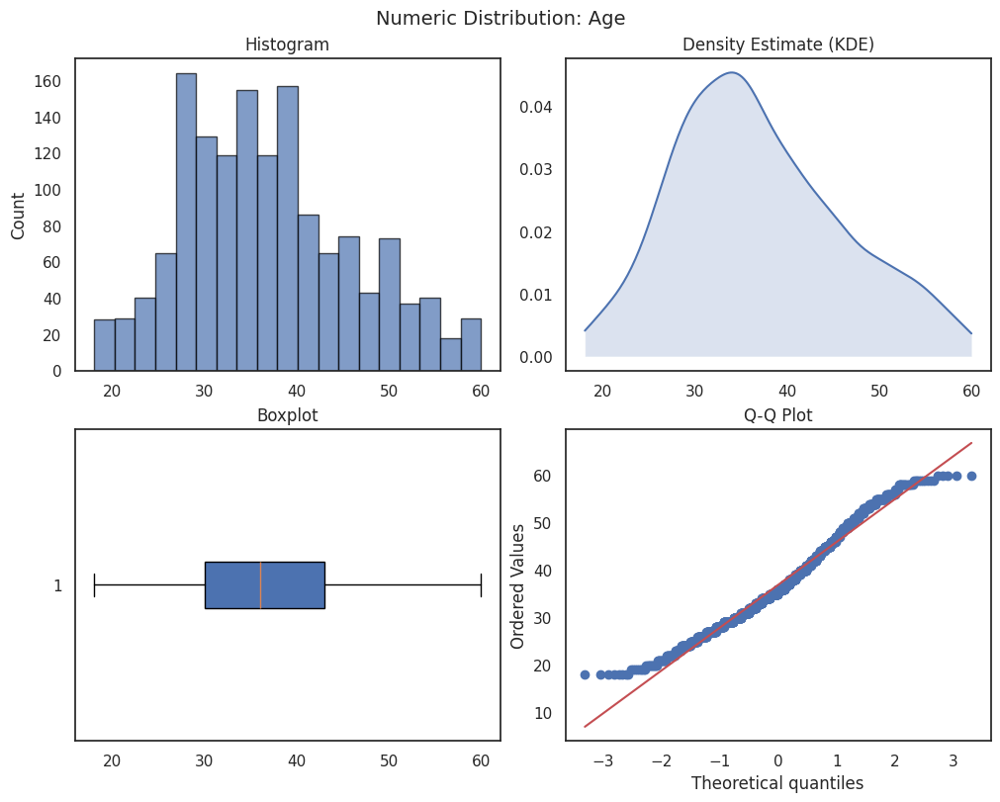

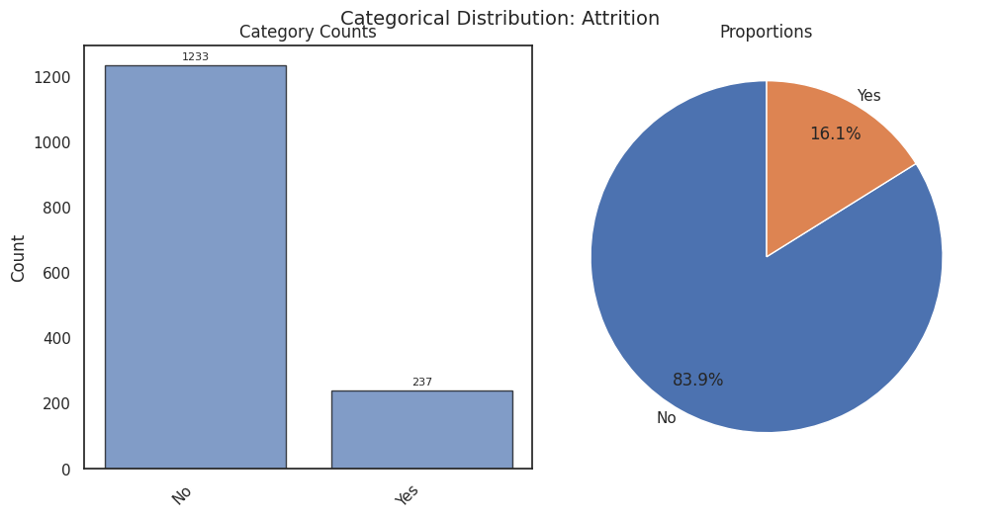

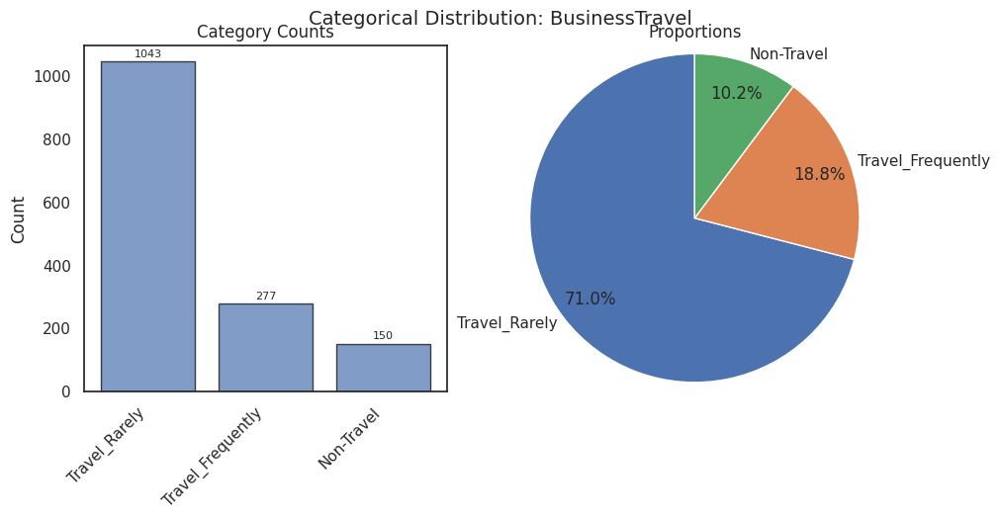

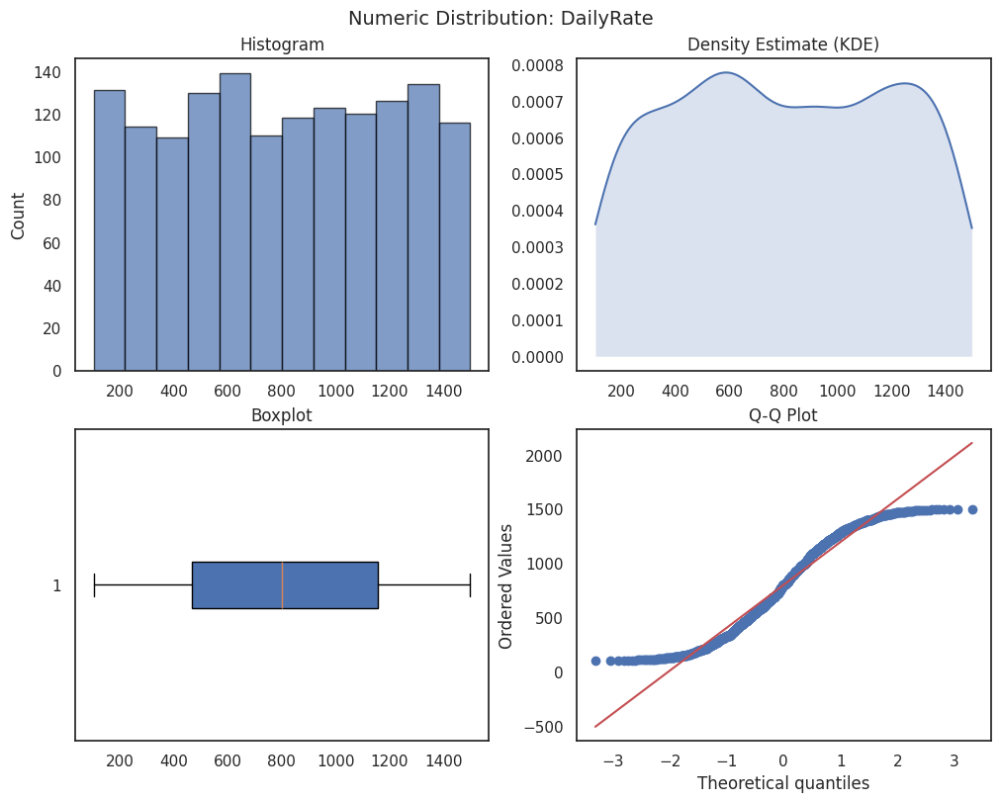

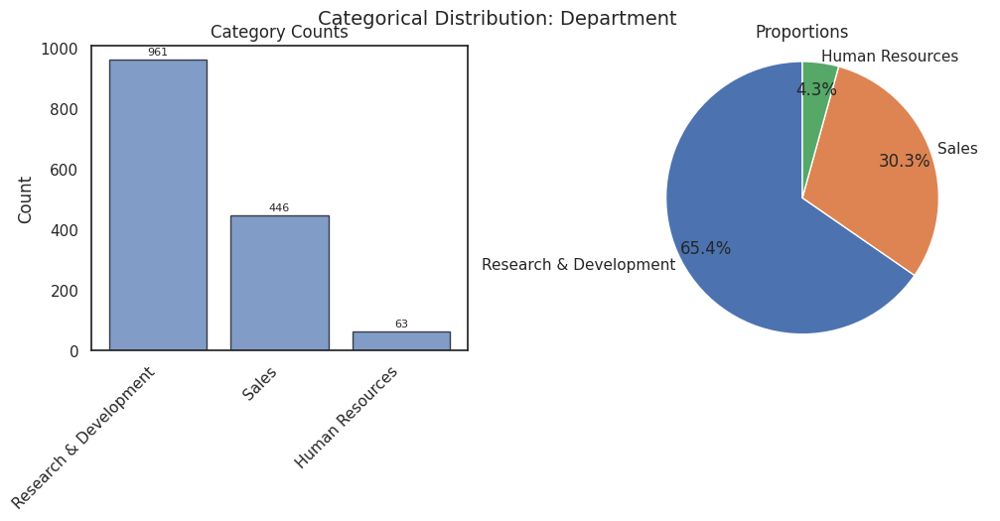

...

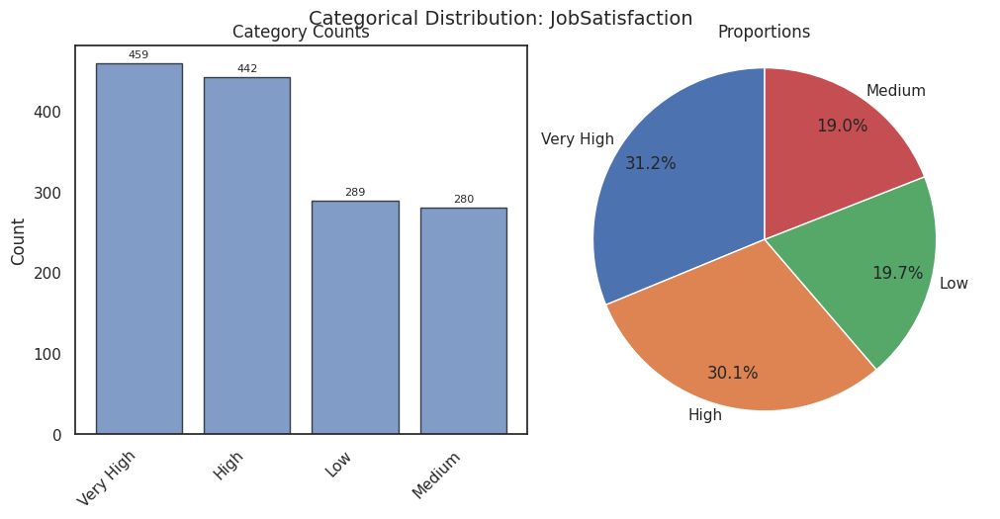

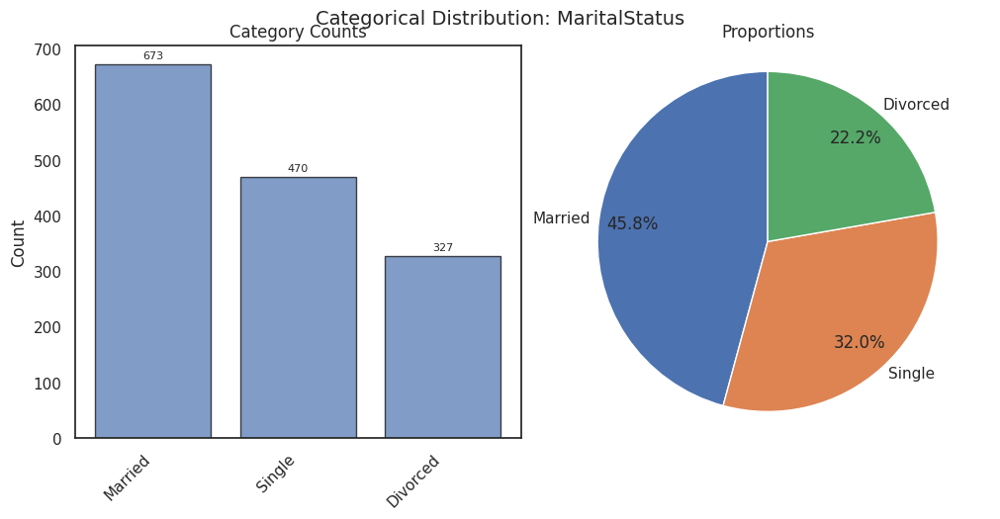

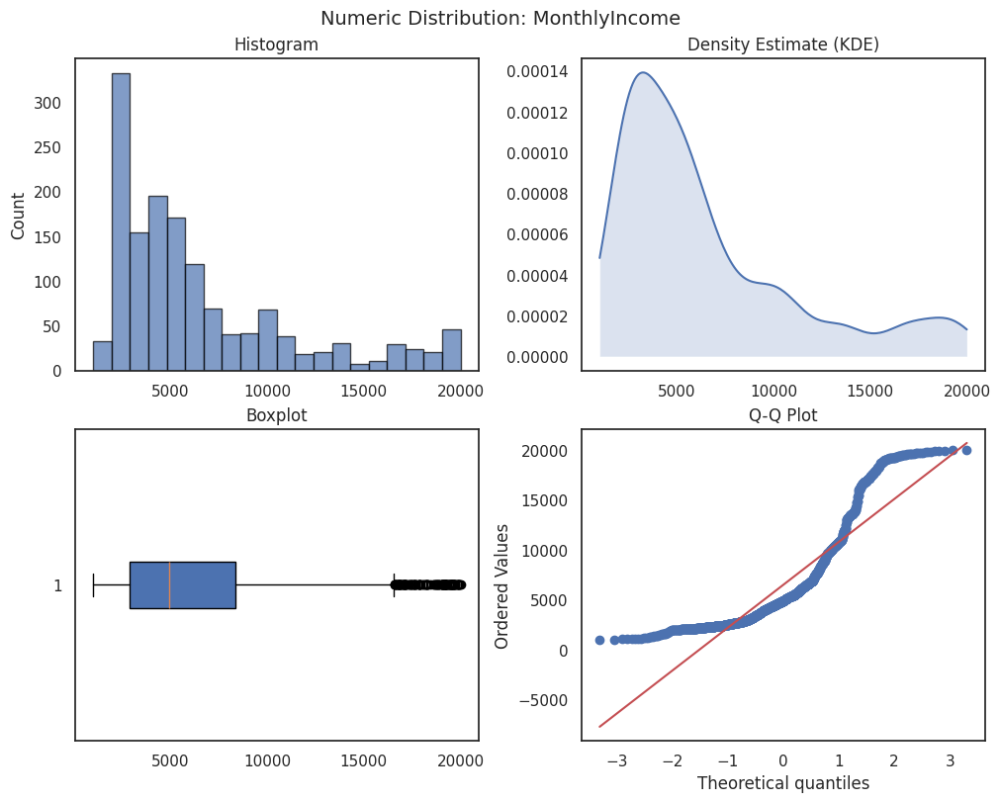

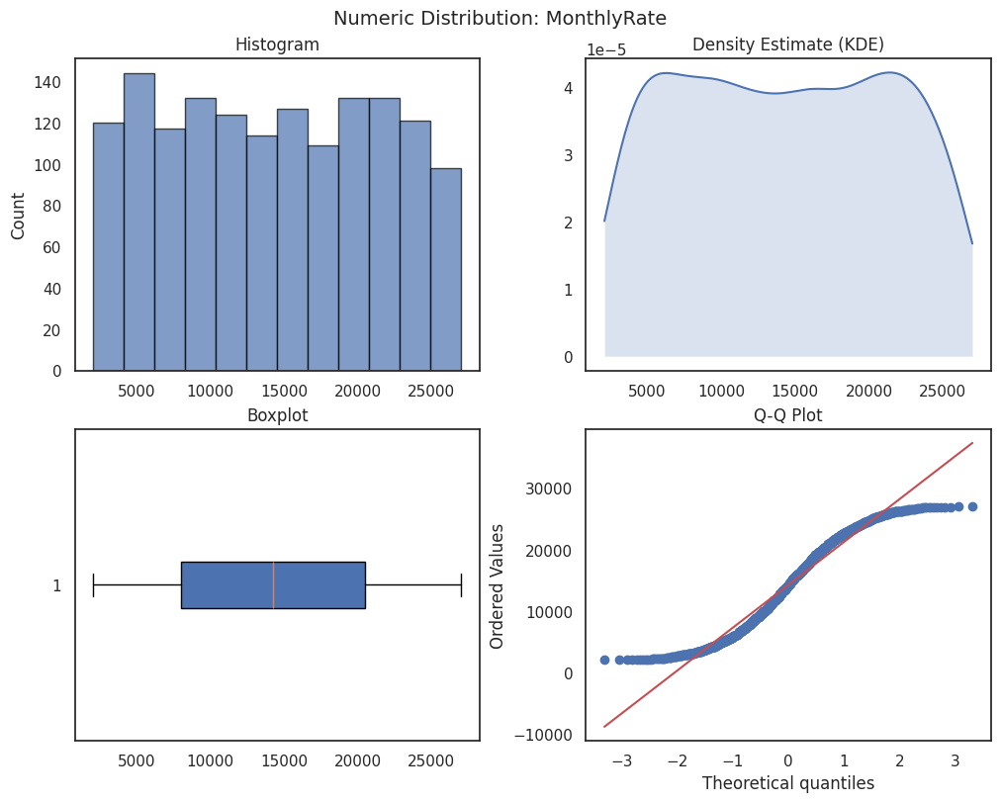

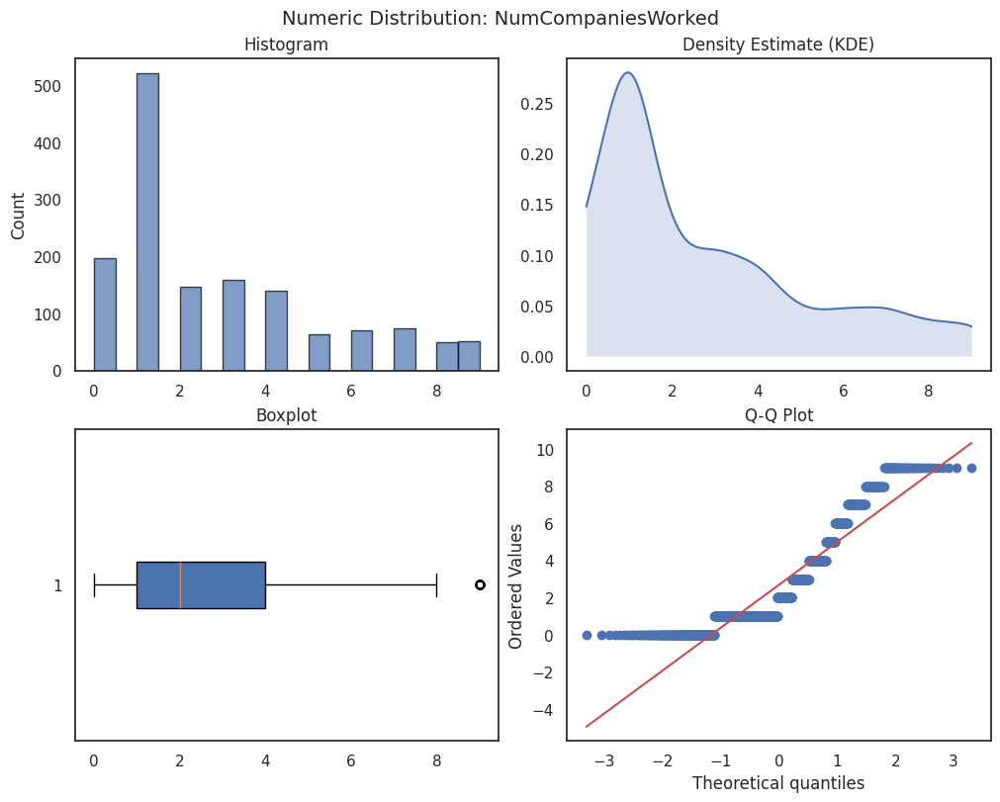

Skipped: OverTime (all values are NaN)


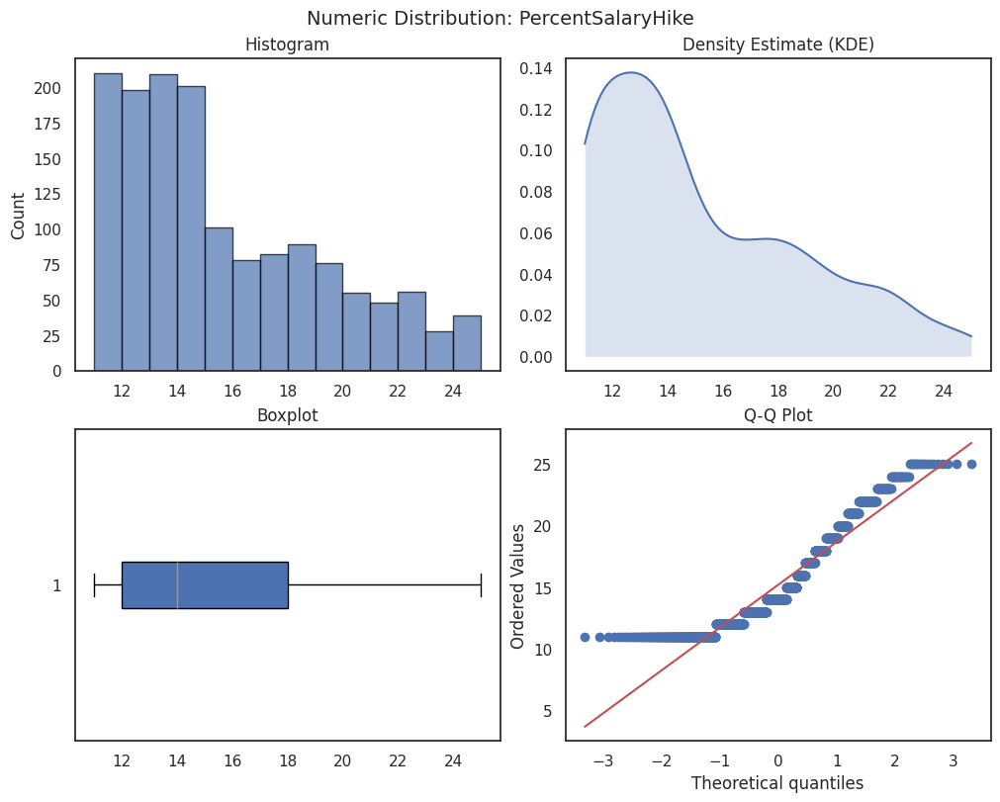

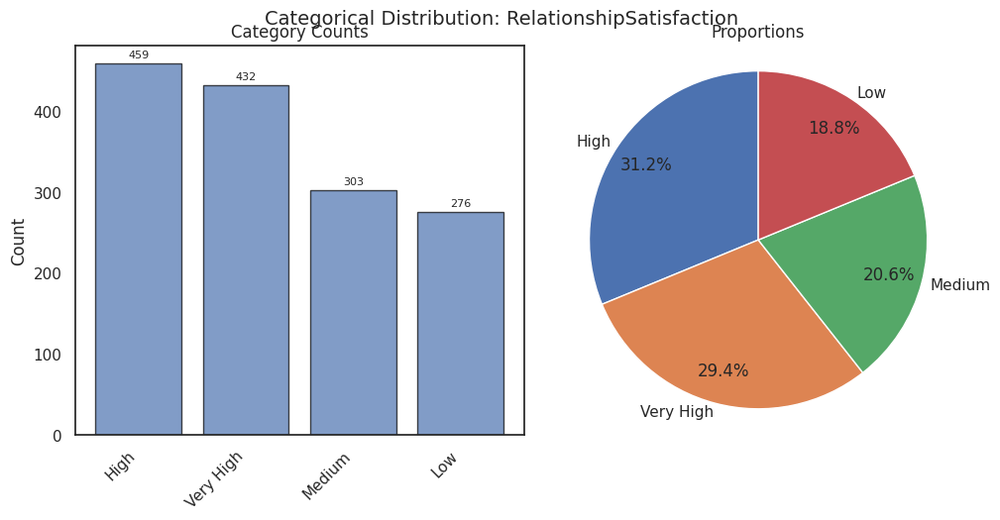

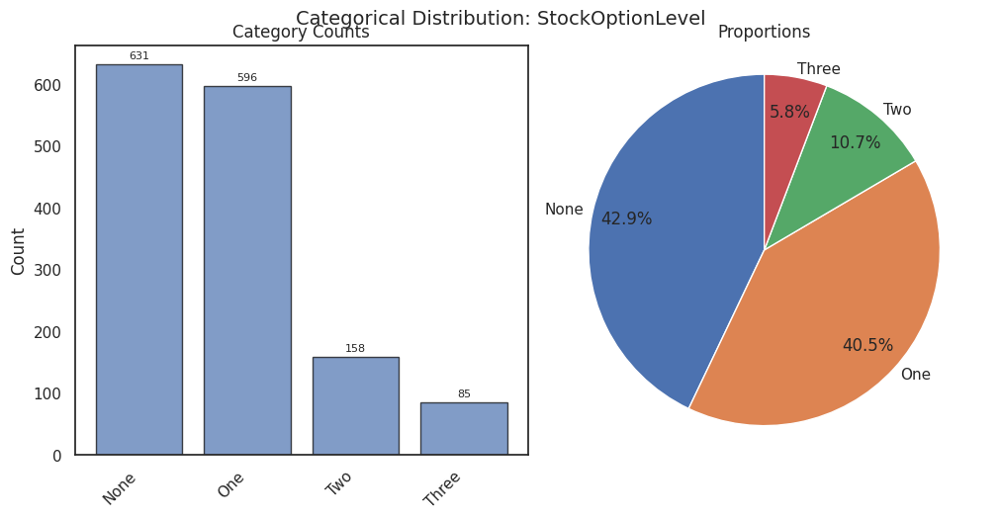

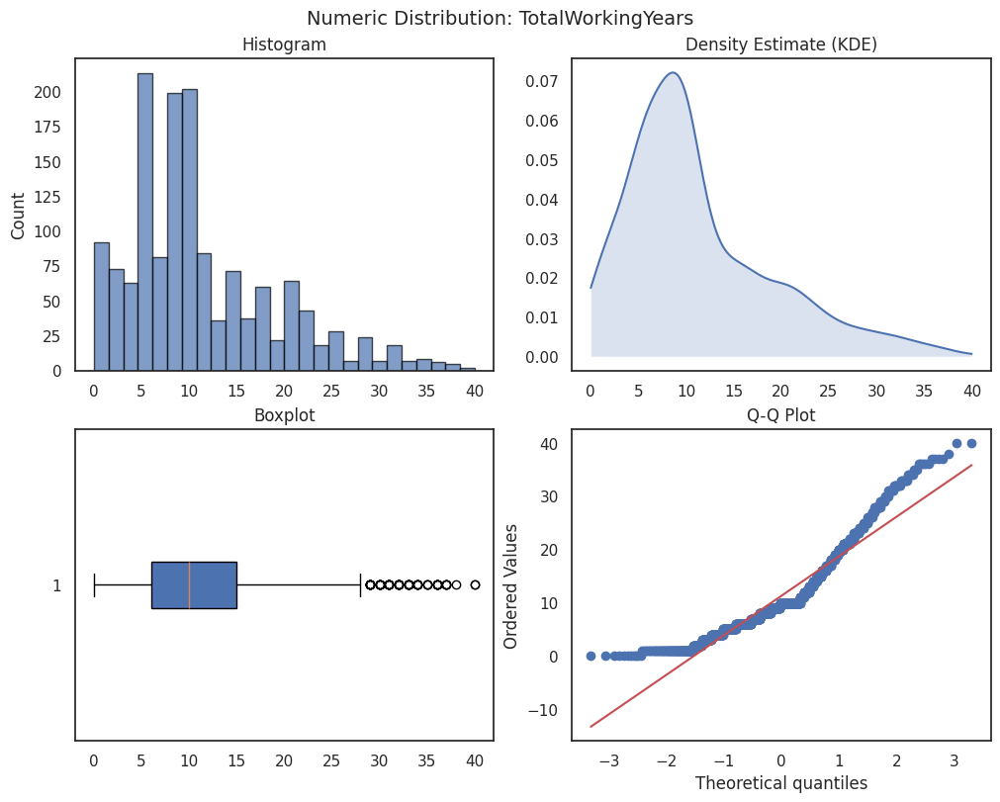

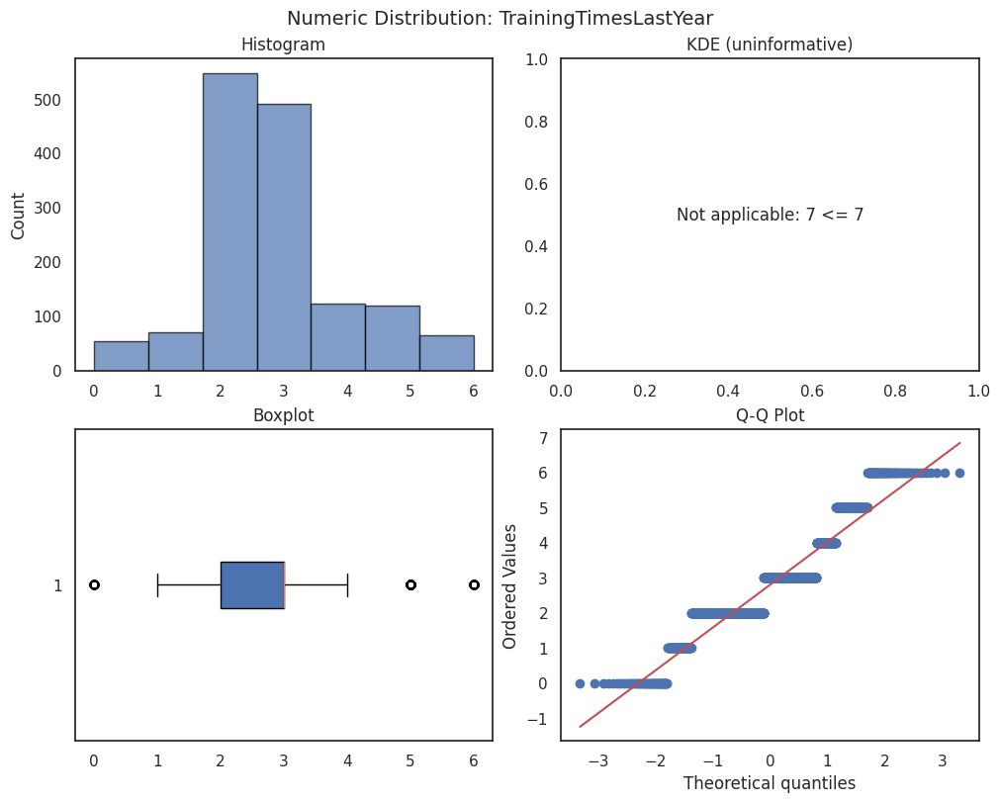

...

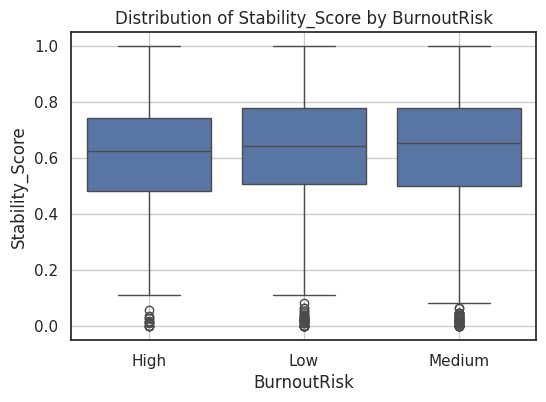

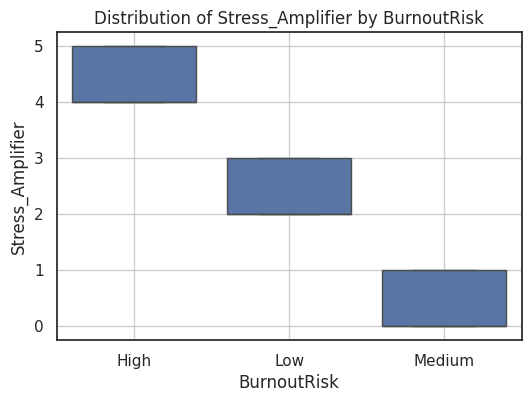

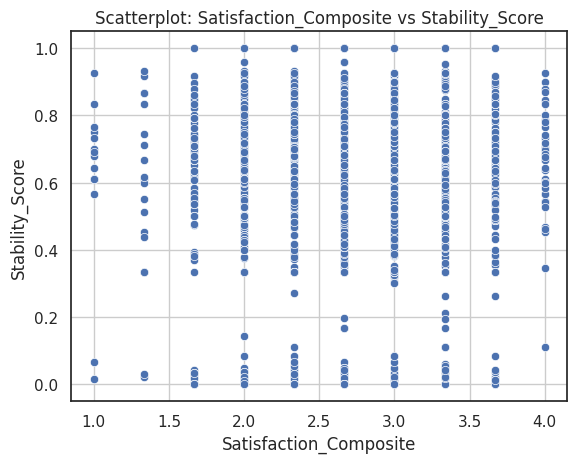

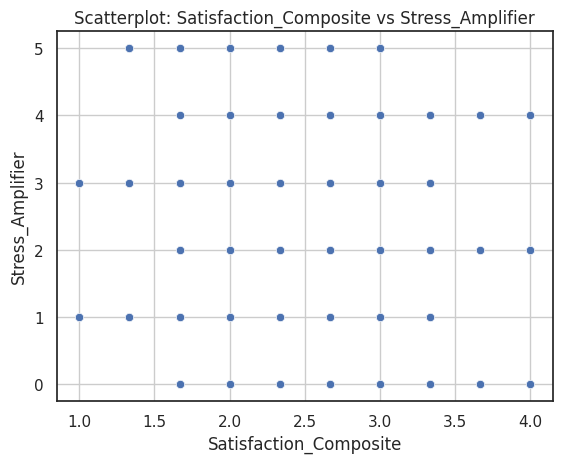

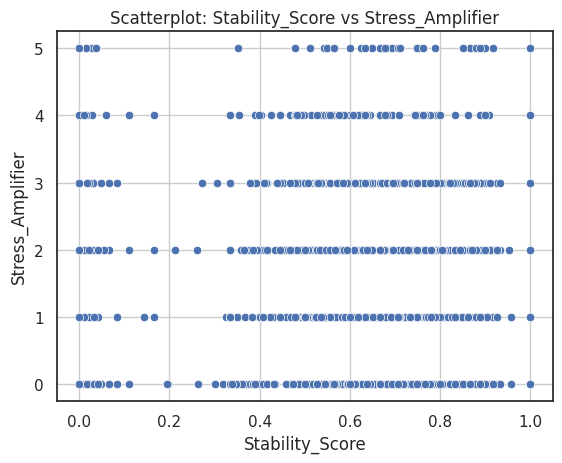

,dtype,non_null,unique,type,skip_reason,skewness,kurtosis,entropy,suppressed_categories,normalized_entropy,high_imbalance
Age,int64,1470,43,numeric,None,0.413286,-0.404145,NaN,0,NaN,False
Attrition,category,1470,2,categorical,None,NaN,NaN,0.637231,0,0.637231,True
BusinessTravel,category,1470,3,categorical,None,NaN,NaN,1.140993,0,0.719886,False
DailyRate,int64,1470,886,numeric,None,-0.003519,-1.203823,NaN,0,NaN,False
Department,category,1470,3,categorical,None,NaN,NaN,1.117699,0,0.705189,False
DistanceFromHome,int64,1470,29,numeric,None,0.958118,-0.224833,NaN,0,NaN,False
Education,category,1470,5,categorical,None,NaN,NaN,2.018300,0,0.869235,False
EducationField,category,1470,6,categorical,None,NaN,NaN,2.049644,0,0.792910,False
EnvironmentSatisfaction,category,1470,4,categorical,None,NaN,NaN,1.963748,0,0.981874,False
Gender,category,1470,2,categorical,None,NaN,NaN,0.970951,0,0.970951,False


In [ ]:
results = full_eda_diagnostics(hr_df_with_all_cat)

# Unpack / inspect
dist_summary_df = results["distribution_summary_df"]           # table of per-column diagnostics
dist_summary_dict = results["distribution_summary_dict"]       # detailed per-column dict
pairwise_tests = results["pairwise_tests"]                    # output of full_pairwise_multi_stat_tests

#  Example inspections
display(dist_summary_df)  # see entropy, normalized entropy, high_imbalance flags, types, etc.

In [ ]:
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)

display(pairwise_tests[pairwise_tests['Significant'] == True])

pd.reset_option("display.max_rows")
pd.reset_option("display.max_columns")

,Variable A,Variable B,Test,Statistic,p-value,Significant
1047,BurnoutRisk,Stress_Amplifier,ANOVA,5010.060657,0.000000e+00,True
554,JobLevel,MonthlyIncome,ANOVA,4530.221140,0.000000e+00,True
548,JobLevel,JobRole,Chi-squared,1929.080221,0.000000e+00,True
549,JobLevel,JobRole,Cramér's V,0.572778,0.000000e+00,True
915,YearsAtCompany,YearsWithCurrManager,Spearman,0.842803,0.000000e+00,True
584,JobRole,MonthlyIncome,ANOVA,810.214054,0.000000e+00,True
911,YearsAtCompany,YearsInCurrentRole,Spearman,0.854000,0.000000e+00,True
227,Department,JobRole,Cramér's V,0.939393,0.000000e+00,True
226,Department,JobRole,Chi-squared,2594.428134,0.000000e+00,True
562,JobLevel,TotalWorkingYears,ANOVA,636.386520,1.985210e-318,True


1) What clearly matters for Attrition (statistically significant with sensible effect drivers)

Features with direct tests vs Attrition and very small p-values:

Stress_Amplifier (U-test p≈6e-18) → higher stress → higher attrition.

BurnoutRisk (χ²/Cramér’s V p≈2.6e-15) → higher burnout → higher attrition.

JobLevel (χ² p≈6.6e-15) → lower levels tend to attrit more.

TotalWorkingYears (U-test p≈2.4e-14) → fewer years of experience → higher attrition.

MonthlyIncome (U-test p≈3.0e-14) → lower income → higher attrition.

YearsAtCompany / YearsInCurrentRole / YearsWithCurrManager (U-tests p≈1e-11–3e-13) → shorter tenure → higher attrition.

WorkLifeBalance (χ² p≈9.7e-04) → poorer balance → higher attrition.

JobSatisfaction / EnvironmentSatisfaction (χ² p≈5e-04–5e-05) → lower satisfaction → higher attrition.

Department, EducationField, BusinessTravel, StockOptionLevel, DistanceFromHome, TrainingTimesLastYear, JobInvolvement all significant (weaker effects but still useful).

2) Major redundancy you should control (drop one of each pair/cluster)

Very high associations mean collinearity if you include both:

Department ↔ JobRole (Cramér’s V ≈ 0.94) → keep JobRole, drop Department.

JobLevel ↔ MonthlyIncome (ANOVA huge; plus Income ↔ TotalWorkingYears r≈0.71) → keep MonthlyIncome or JobLevel (not both); keep TotalWorkingYears.

Tenure cluster:
YearsAtCompany ↔ YearsInCurrentRole ↔ YearsWithCurrManager (ρ≈0.71–0.85).
Also each correlates with the engineered Stability_Score (ρ≈0.60–0.77).
→ Prefer Stability_Score as a single summary + YearsAtCompany (or just the score).

Stability_Score ↔ Role/ManagerStability_ratio (ρ≈0.72–0.77) → don’t keep all; the score is enough.

NumCompaniesWorked ↔ CareerAtCompany_ratio (ρ≈−0.63) → keep one (the ratio is usually more informative).

IncomePerExperience has moderate relation with MonthlyIncome (ρ≈0.20) and negative with experience (≈−0.46) → this one adds signal; keep it with either Income or JobLevel.

3) Features that are independent (good diversity, low collinearity)

Stress_Amplifier, Satisfaction_Composite, BurnoutRisk show low correlations with the numeric block but are strongly tied to Attrition → keep.

DistanceFromHome shows weak links elsewhere but is significant vs Attrition → keep.

4) Suggested feature set for the first model

Keep (priority):

Behavioral/psych: Stress_Amplifier, BurnoutRisk, Satisfaction_Composite, WorkLifeBalance, JobInvolvement, BusinessTravel.

Tenure/stability: Stability_Score (or YearsAtCompany if you drop the score).

Experience/pay: TotalWorkingYears, MonthlyIncome (or JobLevel), IncomePerExperience.

Other: DistanceFromHome, StockOptionLevel, JobRole.

Optional engineered: CareerAtCompany_ratio (drop if you keep NumCompaniesWorked).

Drop (to reduce leakage/collinearity/noise):

Department (redundant with JobRole).

RoleStability_ratio, ManagerStability_ratio (covered by Stability_Score).

Keep either MonthlyIncome or JobLevel.

Avoid rate-ish noise variables (DailyRate/HourlyRate/MonthlyRate) unless you’ve proven value.

5) Next modeling steps

One-hot encode categoricals (JobRole, BusinessTravel, BurnoutRisk, etc.).

Standardize numeric features if using linear models.

Train baseline (Logistic Regression + XGBoost/RandomForest).

Use permutation importance / SHAP to confirm which features truly drive Attrition.

Prune any remaining redundant features with low importance.

TL;DR

Attrition is most associated with stress/burnout, low satisfaction, lower pay/experience, and short tenure/low stability.

Control collinearity: choose JobRole over Department, Income or JobLevel (not both), and Stability_Score instead of the individual tenure ratios.

Your engineered behavioral features are valuable and should improve predictive power.

In [ ]:
hr_df["Attrition"] = hr_df["Attrition"].map({"No": 0, "Yes": 1}).astype("int32")
hr_df_numeric['Attrition'] = hr_df['Attrition']

# Compute correlation with Attrition
correlations = hr_df_numeric.corr()['Attrition'].sort_values(ascending=False)

# Display top correlations (excluding Attrition itself)
print("Top factors positively correlated with Attrition:")
print(correlations[1:6])  # Top 5 positive correlations

print("\nTop factors negatively correlated with Attrition:")
print(correlations[-5:])  # Top 5 negative correlations

Top factors positively correlated with Attrition:
Stress_Amplifier       0.230205
IncomePerExperience    0.169047
DistanceFromHome       0.077924
NumCompaniesWorked     0.043494
MonthlyRate            0.015170
Name: Attrition, dtype: float64

Top factors negatively correlated with Attrition:
YearsWithCurrManager   -0.156199
Age                    -0.159205
MonthlyIncome          -0.159840
YearsInCurrentRole     -0.160545
TotalWorkingYears      -0.171063
Name: Attrition, dtype: float64


TIRAR CONCLUSÕES!

## 2.5 Categorical Encoding

This section performs the complete categorical encoding process, converting all non-numerical variables into numeric representations suitable for machine learning algorithms. The encoding strategy combines both manual mapping for ordinal and binary variables and one-hot encoding for nominal features, ensuring that all categorical data is represented numerically and consistently.

First, a series of manual mappings are applied to binary and ordinal categorical variables whose order or meaning is well-defined. Examples include gender (`Female`/`Male`), overtime status (`No`/`Yes`), burnout risk (`Low`/`Medium`/`High`), and travel frequency (`Non-Travel`/`Travel_Rarely`/`Travel_Frequently`). These mappings are deterministic and independent of the target variable, which means they can safely be performed before the train-test split without introducing data leakage. Ordinal features such as `Education`, `JobSatisfaction`, and `WorkLifeBalance` are explicitly cast to integer types to preserve their inherent ranking.

Afterward, the dataset is divided into training and testing subsets using a stratified split to maintain the same class distribution of the target variable (`Attrition`) across both datasets.

Finally, the remaining categorical variables (those still of type object) are transformed through one-hot encoding using pandas.get_dummies(). This method expands each categorical feature into multiple binary columns, ensuring that no artificial ordinal relationship is imposed between categories. The one-hot encoding is fit on the training set and then applied to the test set, which is realigned using reindex() to guarantee a consistent feature structure. All encoded features are converted to the int64 type for numerical uniformity.

This dual-stage approach — combining manual encoding for ordered variables and one-hot encoding for nominal features — ensures that the entire dataset is numeric, information-preserving, and ready for robust model training while strictly preventing data leakage.

In [ ]:
hr_df["Gender"]    = hr_df["Gender"].map({"Female": 0, "Male": 1}).astype("int32")
hr_df["OverTime"]  = hr_df["OverTime"].map({"No": 0, "Yes": 1}).astype("int32")
hr_df['BurnoutRisk'] = hr_df['BurnoutRisk'].map({"Low": 0, "Medium": 1, "High": 2}).astype("int32")
hr_df['BusinessTravel'] = hr_df['BusinessTravel'].map({"Non-Travel": 0, "Travel_Rarely": 1, "Travel_Frequently": 2}).astype("int32")

ordinal_vars = [
    "Education", "EnvironmentSatisfaction", "JobInvolvement",
    "JobLevel", "JobSatisfaction", "WorkLifeBalance",
    "RelationshipSatisfaction", "StockOptionLevel"
]

hr_df[ordinal_vars] = hr_df[ordinal_vars].astype("int32")
hr_df

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EnvironmentSatisfaction,Gender,...,YearsWithCurrManager,CareerAtCompany_ratio,RoleStability_ratio,ManagerStability_ratio,CareerStart_Age,IncomePerExperience,BurnoutRisk,Satisfaction_Composite,Stability_Score,Stress_Amplifier
EmployeeNumber,,,,,,,,,,,,,,,,,,,,,
1,41,1,1,1102,Sales,1,2,Life Sciences,2,0,...,5,0.750000,0.666667,0.833333,33,749.125000,2,2.333333,0.750000,4
2,49,0,2,279,Research & Development,8,1,Life Sciences,3,1,...,7,1.000000,0.700000,0.700000,39,513.000000,1,3.000000,0.800000,1
4,37,1,1,1373,Research & Development,2,2,Other,4,1,...,0,0.000000,0.000000,0.000000,30,298.571429,0,3.000000,0.000000,2
5,33,0,2,1392,Research & Development,3,4,Life Sciences,4,0,...,0,1.000000,0.875000,0.000000,25,363.625000,0,3.333333,0.625000,2
7,27,0,1,591,Research & Development,2,1,Medical,1,1,...,2,0.333333,1.000000,1.000000,21,578.000000,1,2.333333,0.777778,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2061,36,0,2,884,Research & Development,23,2,Medical,3,1,...,3,0.294118,0.400000,0.600000,19,151.235294,1,3.333333,0.431373,0
2062,39,0,1,613,Research & Development,6,1,Medical,4,1,...,7,0.777778,1.000000,1.000000,30,1110.111111,1,2.000000,0.925926,1
2064,27,0,1,155,Research & Development,4,3,Life Sciences,2,1,...,3,1.000000,0.333333,0.500000,21,1023.666667,0,2.000000,0.611111,3


In [ ]:
# Target (encode Yes/No as 1/0)
X = hr_df.drop(columns=["Attrition"])
y = hr_df['Attrition']

# Split (stratify to preserve class distribution)
X_train_full, X_test, y_train_full, y_test = train_test_split(
    X, y,
    test_size=0.2,
    random_state=42,
    stratify=y
)

X_train, X_val, y_train, y_val = train_test_split(
    X_train_full, y_train_full,
    test_size=0.25,
    random_state=42,
    stratify=y_train_full
)

print("Shapes:")
print("X_train:", X_train.shape, "X_test:", X_test.shape)
print("X_val:", X_val.shape, "y_val:", y_val.shape)
print("y_train:", y_train.shape, "y_test:", y_test.shape)

# Optional: verify stratification
print("\nClass balance (train):")
print(y_train.value_counts(normalize=True).round(3))
print("\nClass balance (test):")
print(y_test.value_counts(normalize=True).round(3))

print("\nClass balance (train):")
print(y_train.value_counts(normalize=True).round(3))
print("\nClass balance (val):")
print(y_val.value_counts(normalize=True).round(3))
print("\nClass balance (test):")
print(y_test.value_counts(normalize=True).round(3))

Shapes:
X_train: (882, 38) X_test: (294, 38)
X_val: (294, 38) y_val: (294,)
y_train: (882,) y_test: (294,)

Class balance (train):
Attrition
0    0.838
1    0.162
Name: proportion, dtype: float64

Class balance (test):
Attrition
0    0.84
1    0.16
Name: proportion, dtype: float64

Class balance (train):
Attrition
0    0.838
1    0.162
Name: proportion, dtype: float64

Class balance (val):
Attrition
0    0.84
1    0.16
Name: proportion, dtype: float64

Class balance (test):
Attrition
0    0.84
1    0.16
Name: proportion, dtype: float64


In [ ]:
# Identifica colunas categóricas
cat_cols = hr_df.select_dtypes(include="object").columns.to_list()

# One-hot encoding no CONJUNTO DE TREINO
X_train_one_hot = pd.get_dummies(X_train, columns=cat_cols, drop_first=True)

# Aplica o mesmo encoding às demais bases (alinhando colunas com o treino)
X_val_one_hot = pd.get_dummies(X_val, columns=cat_cols, drop_first=True)
X_val_one_hot = X_val_one_hot.reindex(columns=X_train_one_hot.columns, fill_value=0)

X_test_one_hot = pd.get_dummies(X_test, columns=cat_cols, drop_first=True)
X_test_one_hot = X_test_one_hot.reindex(columns=X_train_one_hot.columns, fill_value=0)

# Verificação opcional
print("Shapes after encoding:")
print("Train:", X_train_one_hot.shape)
print("Val:", X_val_one_hot.shape)
print("Test:", X_test_one_hot.shape)

# Exemplo de visualização do resultado
X_train_one_hot.head()

Shapes after encoding:
Train: (882, 51)
Val: (294, 51)
Test: (294, 51)


,Age,BusinessTravel,DailyRate,DistanceFromHome,Education,EnvironmentSatisfaction,Gender,HourlyRate,JobInvolvement,JobLevel,...,JobRole_Human Resources,JobRole_Laboratory Technician,JobRole_Manager,JobRole_Manufacturing Director,JobRole_Research Director,JobRole_Research Scientist,JobRole_Sales Executive,JobRole_Sales Representative,MaritalStatus_Married,MaritalStatus_Single
EmployeeNumber,,,,,,,,,,,,,,,,,,,,,
291,32,1,1045,4,4,4,1,32,1,3,...,False,False,False,False,False,False,True,False,True,False
118,46,1,669,9,2,3,1,64,2,3,...,False,False,False,False,False,False,True,False,False,True
1180,40,2,902,26,2,3,0,92,2,2,...,False,False,False,False,False,True,False,False,True,False
1782,38,1,1153,6,2,4,0,40,2,1,...,False,True,False,False,False,False,False,False,True,False
382,38,1,322,7,2,1,0,44,4,2,...,False,False,False,False,False,False,True,False,False,False


## 2.6 Handling outliers

In [ ]:
# 1) Colunas numéricas (fonte de verdade = TRAIN)
num_cols = X_train_one_hot.select_dtypes(include=["int64", "float64"]).columns
non_num_cols = X_train_one_hot.columns.difference(num_cols)

# 2) Fit só no TRAIN (mesmas colunas e ordem)
scaler = StandardScaler().fit(X_train_one_hot[num_cols])

def scale_join(df):
    # escala apenas num_cols e volta como DataFrame float64
    scaled_num = pd.DataFrame(
        scaler.transform(df[num_cols]),
        columns=num_cols,
        index=df.index,
        dtype="float64",
    )
    # junta com colunas não-numéricas e reordena para a ordem original
    out = pd.concat([scaled_num, df[non_num_cols]], axis=1)
    return out[df.columns]  # preserva a ordem original das colunas

# 3) Aplica a TRAIN/VAL/TEST
X_train_one_hot = scale_join(X_train_one_hot)
X_val_one_hot   = scale_join(X_val_one_hot)
X_test_one_hot  = scale_join(X_test_one_hot)

In [ ]:
X_train_one_hot

,Age,BusinessTravel,DailyRate,DistanceFromHome,Education,EnvironmentSatisfaction,Gender,HourlyRate,JobInvolvement,JobLevel,...,JobRole_Human Resources,JobRole_Laboratory Technician,JobRole_Manager,JobRole_Manufacturing Director,JobRole_Research Director,JobRole_Research Scientist,JobRole_Sales Executive,JobRole_Sales Representative,MaritalStatus_Married,MaritalStatus_Single
EmployeeNumber,,,,,,,,,,,,,,,,,,,,,
291,-0.551424,1,0.593599,-0.648710,4,4,1,-1.660094,1,3,...,False,False,False,False,False,False,True,False,True,False
118,0.986635,1,-0.346508,-0.033746,2,3,1,-0.074440,2,3,...,False,False,False,False,False,False,True,False,False,True
1180,0.327467,2,0.236059,2.057129,2,3,0,1.313008,2,2,...,False,False,False,False,False,True,False,False,True,False
1782,0.107744,1,0.863630,-0.402724,2,4,0,-1.263681,2,1,...,False,True,False,False,False,False,False,False,True,False
382,0.107744,1,-1.214107,-0.279732,2,1,0,-1.065474,4,2,...,False,False,False,False,False,False,True,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
647,-1.430315,2,1.198668,-0.279732,3,1,0,-0.520405,3,1,...,False,True,False,False,False,False,False,False,True,False
895,-0.661286,1,1.036150,0.212239,4,4,1,-0.867267,3,1,...,False,False,False,False,False,True,False,False,True,False
1628,0.327467,1,0.191054,0.704210,3,1,0,0.718387,2,3,...,False,False,False,True,False,False,False,False,True,False


In [ ]:
for df in (X_train_one_hot, X_val_one_hot, X_test_one_hot):
    df[df.select_dtypes(bool).columns] = df.select_dtypes(bool).astype("uint8")

X_test_one_hot.info()

<class 'pandas.core.frame.DataFrame'>
Index: 294 entries, 1495 to 391
Data columns (total 51 columns):
 #   Column                             Non-Null Count  Dtype  
---  ------                             --------------  -----  
 0   Age                                294 non-null    float64
 1   BusinessTravel                     294 non-null    int32  
 2   DailyRate                          294 non-null    float64
 3   DistanceFromHome                   294 non-null    float64
 4   Education                          294 non-null    int32  
 5   EnvironmentSatisfaction            294 non-null    int32  
 6   Gender                             294 non-null    int32  
 7   HourlyRate                         294 non-null    float64
 8   JobInvolvement                     294 non-null    int32  
 9   JobLevel                           294 non-null    int32  
 10  JobSatisfaction                    294 non-null    int32  
 11  MonthlyIncome                      294 non-null    float64
 

In [ ]:
assert list(X_train_one_hot.columns) == list(X_val_one_hot.columns) == list(X_test_one_hot.columns)
assert (X_train_one_hot.dtypes == X_val_one_hot.dtypes).all()
assert (X_train_one_hot.dtypes == X_test_one_hot.dtypes).all()

In [ ]:
X_train_one_hot.to_csv("/content/Bootcamp_NovaIMS/X_train_one_hot.csv", index=False)
X_val_one_hot.to_csv("/content/Bootcamp_NovaIMS/X_val_one_hot.csv", index=False)
X_test_one_hot.to_csv("/content/Bootcamp_NovaIMS/X_test_one_hot.csv", index=False)
y_train.to_csv("/content/Bootcamp_NovaIMS/y_train.csv", index=False)
y_test.to_csv("/content/Bootcamp_NovaIMS/y_test.csv", index=False)
y_val.to_csv("/content/Bootcamp_NovaIMS/y_val.csv", index=False)

## 2.7 SMOTE

In [ ]:
# Parâmetros
RANDOM_STATE = 42

# --- garantir formatos numpy/pandas ---
X_train_df = X_train_one_hot.copy() if isinstance(X_train_one_hot, pd.DataFrame) else pd.DataFrame(X_train_one_hot)
y_train_arr = np.asarray(y_train).ravel()

# checar quantidade da classe minoritária
unique, counts = np.unique(y_train_arr, return_counts=True)
class_counts = dict(zip(unique, counts))
minority_count = min(counts)
if minority_count < 2:
    raise ValueError(f"SMOTE exige pelo menos 2 instâncias na classe minoritária (tem {minority_count}).")

# ajustar k_neighbors para evitar erro quando minority_count <= 5
k_neighbors = min(5, minority_count - 1)
print(f"SMOTE: minority_count={minority_count}, k_neighbors={k_neighbors}")

smote = SMOTE(sampling_strategy='auto', k_neighbors=k_neighbors, random_state=RANDOM_STATE)

# aplicar SMOTE
X_res_np, y_res_np = smote.fit_resample(X_train_df.values, y_train_arr)

# transformar de volta para DataFrame com as mesmas colunas
X_train_smote = pd.DataFrame(X_res_np, columns=X_train_df.columns)
y_train_smote = pd.Series(y_res_np, name=(y_train.name if hasattr(y_train, "name") else "target"))

print("Antes SMOTE ->", class_counts)
print("Depois SMOTE ->", dict(zip(*np.unique(y_res_np, return_counts=True))))

SMOTE: minority_count=143, k_neighbors=5
Antes SMOTE -> {np.int32(0): np.int64(739), np.int32(1): np.int64(143)}
Depois SMOTE -> {np.int32(0): np.int64(739), np.int32(1): np.int64(739)}


In [ ]:
X_train_smote

,Age,BusinessTravel,DailyRate,DistanceFromHome,Education,EnvironmentSatisfaction,Gender,HourlyRate,JobInvolvement,JobLevel,...,JobRole_Human Resources,JobRole_Laboratory Technician,JobRole_Manager,JobRole_Manufacturing Director,JobRole_Research Director,JobRole_Research Scientist,JobRole_Sales Executive,JobRole_Sales Representative,MaritalStatus_Married,MaritalStatus_Single
0,-0.551424,1.000000,0.593599,-0.648710,4.000000,4.000000,1.000000,-1.660094,1.000000,3.000000,...,0.0,0.000000,0.000000,0.0,0.0,0.0,1.0,0.000000,1.000000,0.00000
1,0.986635,1.000000,-0.346508,-0.033746,2.000000,3.000000,1.000000,-0.074440,2.000000,3.000000,...,0.0,0.000000,0.000000,0.0,0.0,0.0,1.0,0.000000,0.000000,1.00000
2,0.327467,2.000000,0.236059,2.057129,2.000000,3.000000,0.000000,1.313008,2.000000,2.000000,...,0.0,0.000000,0.000000,0.0,0.0,1.0,0.0,0.000000,1.000000,0.00000
3,0.107744,1.000000,0.863630,-0.402724,2.000000,4.000000,0.000000,-1.263681,2.000000,1.000000,...,0.0,1.000000,0.000000,0.0,0.0,0.0,0.0,0.000000,1.000000,0.00000
4,0.107744,1.000000,-1.214107,-0.279732,2.000000,1.000000,0.000000,-1.065474,4.000000,2.000000,...,0.0,0.000000,0.000000,0.0,0.0,0.0,1.0,0.000000,0.000000,0.00000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1473,-0.362067,1.319100,-0.901785,2.140874,3.319100,2.361799,1.000000,0.584543,3.000000,2.000000,...,0.0,0.000000,0.000000,0.0,0.0,0.0,1.0,0.000000,0.319100,0.68090
1474,-0.805826,1.000000,0.197506,-0.111394,2.657831,2.000000,0.171085,-1.169114,3.000000,1.342169,...,0.0,0.828915,0.171085,0.0,0.0,0.0,0.0,0.000000,0.171085,0.00000
1475,-0.982738,2.000000,0.451680,-0.967619,3.037008,1.037008,1.000000,-0.962742,2.000000,1.000000,...,0.0,0.962992,0.000000,0.0,0.0,0.0,0.0,0.037008,0.037008,0.00000
1476,-0.794349,2.000000,-0.006280,-1.017687,3.596270,1.596270,0.403730,-0.868191,1.403730,1.000000,...,0.0,0.403730,0.000000,0.0,0.0,0.0,0.0,0.596270,0.000000,0.59627


In [ ]:
X_train_smote.to_csv("/content/Bootcamp_NovaIMS/X_train_smote.csv", index=False)
y_train_smote.to_csv("/content/Bootcamp_NovaIMS/y_train_smote.csv", index=False)

## 2.8 Feature Selection

In [ ]:
cols_option1 = [
    "Stress_Amplifier",
    "BurnoutRisk",
    "JobRole",
    "JobLevel",
    "TotalWorkingYears",
    "MonthlyIncome",
    "YearsAtCompany",
    "StockOptionLevel",
    "YearsInCurrentRole",
    "YearsWithCurrManager",
    "Age"
]

cols_option1_one_hot = [
    "Stress_Amplifier",
    "BurnoutRisk",
    "JobRole_Human Resources",
    "JobRole_Laboratory Technician",
    "JobRole_Manager",
    "JobRole_Manufacturing Director",
    "JobRole_Research Director",
    "JobRole_Research Scientist",
    "JobRole_Sales Executive",
    "JobRole_Sales Representative",
    "JobLevel",
    "TotalWorkingYears",
    "MonthlyIncome",
    "YearsAtCompany",
    "StockOptionLevel",
    "YearsInCurrentRole",
    "YearsWithCurrManager",
    "Age"
]

cols_option2 = [
    "MaritalStatus",
    "Satisfaction_Composite",
    "JobInvolvement",
    "BusinessTravel",
    "Stability_Score",
    "EnvironmentSatisfaction",
    "RoleStability_ratio",
    "ManagerStability_ratio",
    "IncomePerExperience",
    "JobSatisfaction",
    "WorkLifeBalance"
]

cols_option2_one_hot = [
    "MaritalStatus_Married",
    "MaritalStatus_Single",
    "Satisfaction_Composite",
    "JobInvolvement",
    "BusinessTravel",
    "Stability_Score",
    "EnvironmentSatisfaction",
    "RoleStability_ratio",
    "ManagerStability_ratio",
    "IncomePerExperience",
    "JobSatisfaction",
    "WorkLifeBalance"
]

cols_option3 = [
    "DistanceFromHome",
    "Department",
    "EducationField",
    "DailyRate",
    "YearsSinceLastPromotion",
    "TrainingTimesLastYear"
]

cols_option3_one_hot = [
    "DistanceFromHome",
    "Department_Research & Development",
    "Department_Sales",
    "EducationField_Life Sciences",
    "EducationField_Marketing",
    "EducationField_Medical",
    "EducationField_Other",
    "EducationField_Technical Degree",
    "DailyRate",
    "YearsSinceLastPromotion",
    "TrainingTimesLastYear"
]

cols_option4 = cols_option1 + cols_option2 + cols_option3
cols_option4_one_hot = cols_option1_one_hot + cols_option2_one_hot + cols_option3_one_hot

<font color = '#A3D5FF'>
    
# **3. Modelling** 🤖</font>
</a>

In [ ]:
X_train_one_hot = pd.read_csv("/content/Bootcamp_NovaIMS/data/X_train_one_hot.csv")
X_val_one_hot = pd.read_csv("/content/Bootcamp_NovaIMS/data/X_val_one_hot.csv")
X_test_one_hot = pd.read_csv("/content/Bootcamp_NovaIMS/data/X_test_one_hot.csv")
X_train_smote = pd.read_csv("/content/Bootcamp_NovaIMS/data/X_train_smote.csv")

y_train = pd.read_csv("/content/Bootcamp_NovaIMS/data/y_train.csv").squeeze()
y_val = pd.read_csv("/content/Bootcamp_NovaIMS/data/y_val.csv").squeeze()
y_test = pd.read_csv("/content/Bootcamp_NovaIMS/data/y_test.csv").squeeze()
y_train_smote = pd.read_csv("/content/Bootcamp_NovaIMS/data/y_train_smote.csv").squeeze()

In [ ]:
cols_options = {
    "option1": cols_option1_one_hot,
    "option2": cols_option2_one_hot,
    "option3": cols_option3_one_hot,
    "option4": cols_option4_one_hot,
    "all": X_train_one_hot.columns.tolist()
}

## 3.1 Logistic Regression

In [ ]:
# Assumo que já existem no escopo:
# X_train_one_hot, X_val_one_hot, y_train, y_val,
# X_train_smote, y_train_smote (X_train_smote como DataFrame com mesmas colunas)

best_models_variant = {}   # guarda melhores modelos por option e variante
best_scores_variant = {}   # guarda F1 por option/variante
best_overall_per_option = {}  # guarda vencedor ("original" ou "smote") por option

param_grid = {
    "C": [0.01, 0.1, 1, 10],
    "penalty": ["l1", "l2"]
}

for name, cols in cols_options.items():
    print(f"\n🔹 Testando {name} com {len(cols)} features...")

    # preparar subsets de validação (sempre os mesmos)
    X_val_sub = X_val_one_hot[cols]

    # variantes a testar: original e smote (se SMOTE existir)
    variants = [("original", X_train_one_hot, y_train)]
    if 'X_train_smote' in globals() and 'y_train_smote' in globals():
        variants.append(("smote", X_train_smote, y_train_smote))
    else:
        print("  ⚠️ X_train_smote/y_train_smote não encontrados no scope — vou testar só 'original'.")

    best_models_variant[name] = {}
    best_scores_variant[name] = {}

    for variant_name, X_tr_df, y_tr_obj in variants:
        print(f"  ▶ Variante: {variant_name}")

        # subset features (garantir DataFrame/Series compatíveis)
        X_train_sub = X_tr_df[cols]
        y_train_sub = y_tr_obj if not hasattr(y_tr_obj, "values") else y_tr_obj

        # configurar o logistic: usar class_weight="balanced" só na variante original
        if variant_name == "original":
            log_reg = LogisticRegression(class_weight="balanced", solver="liblinear", max_iter=500, random_state=42)
        else:  # smote
            log_reg = LogisticRegression(class_weight=None, solver="liblinear", max_iter=500, random_state=42)

        grid = GridSearchCV(estimator=log_reg,
                            param_grid=param_grid,
                            scoring="f1",
                            cv=5,
                            n_jobs=-1,
                            verbose=0)

        # treinar
        grid.fit(X_train_sub, y_train_sub)
        best_model = grid.best_estimator_

        # avaliar na validação
        y_val_pred = best_model.predict(X_val_sub)
        f1 = f1_score(y_val, y_val_pred)

        print(f"    -> F1_val ({variant_name}): {f1:.4f}")
        print(f"    -> Melhores parâmetros ({variant_name}): {grid.best_params_}")
        print(classification_report(y_val, y_val_pred))
        print("    Matriz de confusão:\n", confusion_matrix(y_val, y_val_pred))

        best_models_variant[name][variant_name] = best_model
        best_scores_variant[name][variant_name] = f1

    # escolher a melhor variante para esta option
    winner_variant = max(best_scores_variant[name], key=best_scores_variant[name].get)
    best_overall_per_option[name] = {
        "variant": winner_variant,
        "model": best_models_variant[name][winner_variant],
        "f1": best_scores_variant[name][winner_variant]
    }
    print(f"  ✅ Vencedor para {name}: {winner_variant} com F1={best_scores_variant[name][winner_variant]:.4f}")

# escolher melhor modelo global entre todas as options (e variantes vencedoras)
best_option = max(best_overall_per_option, key=lambda k: best_overall_per_option[k]["f1"])
final_info = best_overall_per_option[best_option]
final_model = final_info["model"]
final_variant = final_info["variant"]
final_f1 = final_info["f1"]

print(f"\n🏆 Melhor modelo global: {best_option} ({final_variant}) com F1={final_f1:.4f}")

# salvar modelo final
joblib.dump(final_model, f"log_reg_best_{best_option}_{final_variant}.pkl")
print(f"Modelo salvo como log_reg_best_{best_option}_{final_variant}.pkl")



🔹 Testando option1 com 18 features...
  ▶ Variante: original
    -> F1_val (original): 0.4516
    -> Melhores parâmetros (original): {'C': 10, 'penalty': 'l1'}
              precision    recall  f1-score   support

           0       0.94      0.70      0.80       247
           1       0.32      0.74      0.45        47

    accuracy                           0.71       294
   macro avg       0.63      0.72      0.63       294
weighted avg       0.84      0.71      0.75       294

    Matriz de confusão:
 [[174  73]
 [ 12  35]]
  ▶ Variante: smote
    -> F1_val (smote): 0.4387
    -> Melhores parâmetros (smote): {'C': 1, 'penalty': 'l2'}
              precision    recall  f1-score   support

           0       0.93      0.70      0.80       247
           1       0.31      0.72      0.44        47

    accuracy                           0.70       294
   macro avg       0.62      0.71      0.62       294
weighted avg       0.83      0.70      0.74       294

    Matriz de confusão:
 


📊 Gerando Matriz de Confusão Visual para o Melhor Modelo Global...


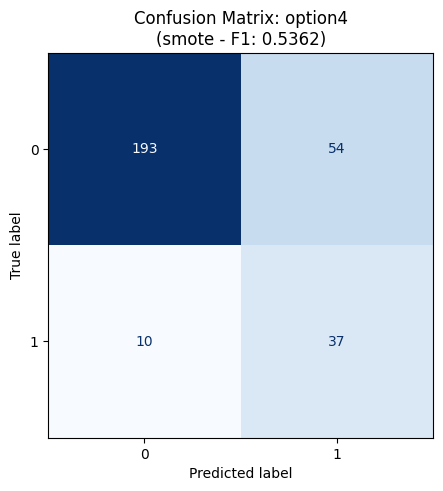

In [ ]:
print("\n📊 Gerando Matriz de Confusão Visual para o Melhor Modelo Global...")

# 1. Selecionar as colunas corretas (o modelo final só sabe lidar com as colunas com que foi treinado)
cols_final = cols_options[best_option]
X_val_final = X_val_one_hot[cols_final]

# 2. Fazer a predição no conjunto de validação usando o modelo final
y_pred_final = final_model.predict(X_val_final)

# 3. Calcular a matriz de confusão
cm = confusion_matrix(y_val, y_pred_final)

# 4. Plotar usando o ConfusionMatrixDisplay (mais moderno e limpo que o heatmap manual)
# values_format='d' garante que mostra números inteiros e não notação científica
fig, ax = plt.subplots(figsize=(6, 5))
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=final_model.classes_)
disp.plot(cmap='Blues', ax=ax, values_format='d', colorbar=False)

plt.title(f"Confusion Matrix: {best_option}\n({final_variant} - F1: {final_f1:.4f})")
plt.grid(False) # Remove as gridlines para ficar mais limpo
plt.show()

## 3.2 Random Forest


🌲 Testando Random Forest - option1 (18 features)
  ▶ Variante: original
    -> F1_val (original): 0.5750
    -> Melhores parâmetros (original): {'max_depth': None, 'max_features': 'sqrt', 'min_samples_leaf': 2, 'min_samples_split': 5, 'n_estimators': 100}
              precision    recall  f1-score   support

           0       0.91      0.96      0.93       247
           1       0.70      0.49      0.57        47

    accuracy                           0.88       294
   macro avg       0.80      0.72      0.75       294
weighted avg       0.87      0.88      0.88       294

    Matriz de confusão:
 [[237  10]
 [ 24  23]]
  ▶ Variante: smote
    -> F1_val (smote): 0.5641
    -> Melhores parâmetros (smote): {'max_depth': 20, 'max_features': 'sqrt', 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 100}
              precision    recall  f1-score   support

           0       0.90      0.96      0.93       247
           1       0.71      0.47      0.56        47

    accu

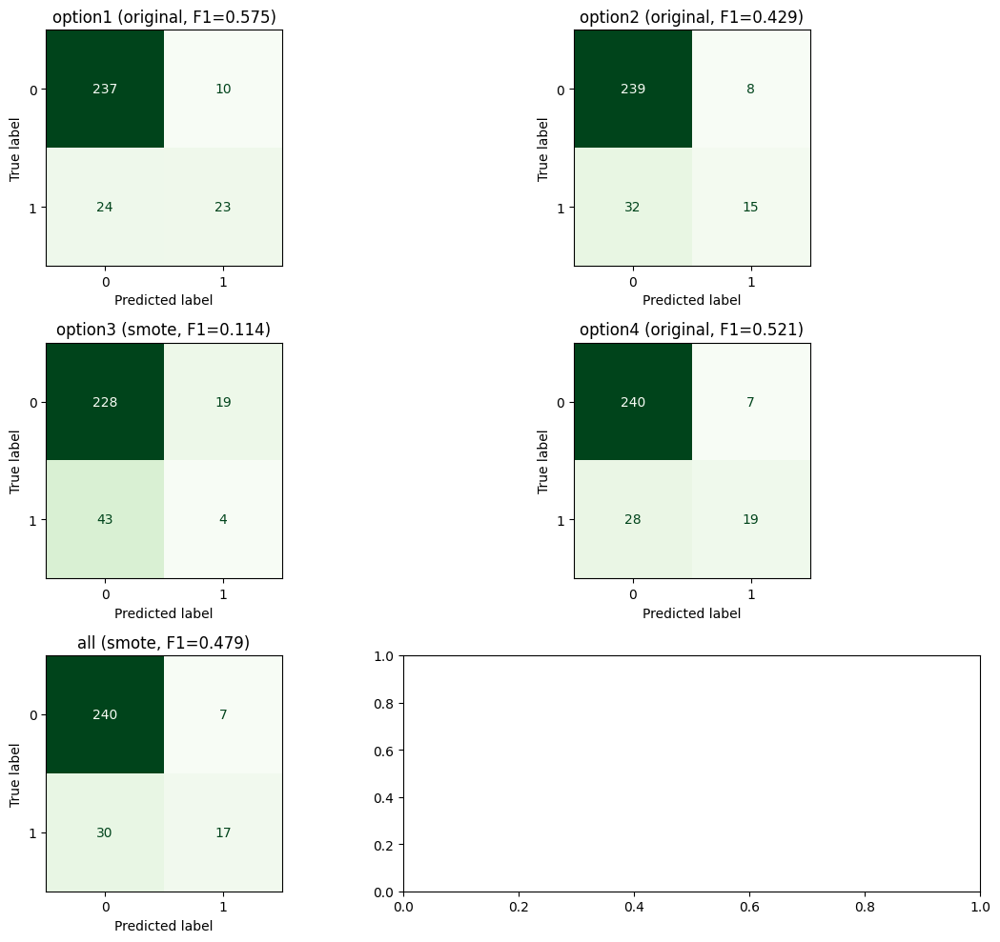


🔎 Avaliação final no conjunto de TESTE (Random Forest)

Carregando modelo: rf_best_option1_original.pkl
              precision    recall  f1-score   support

           0       0.86      0.92      0.89       247
           1       0.31      0.19      0.24        47

    accuracy                           0.80       294
   macro avg       0.58      0.56      0.56       294
weighted avg       0.77      0.80      0.78       294

Matriz de confusão (TESTE):
 [[227  20]
 [ 38   9]]


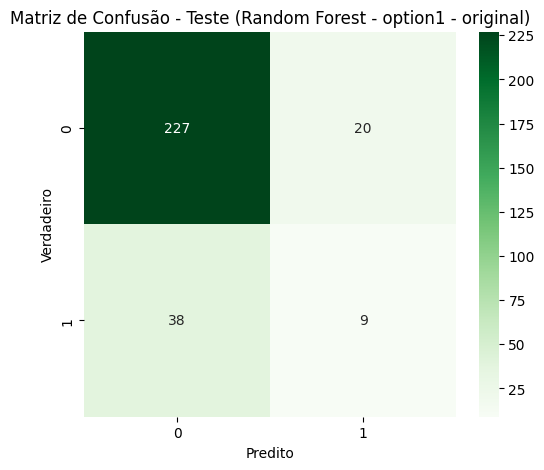

In [ ]:
best_models_rf_variant = {}
best_scores_rf_variant = {}
best_overall_per_option_rf = {}

param_grid = {
    "n_estimators": [100, 200],
    "max_depth": [None, 10, 20],
    "min_samples_split": [2, 5],
    "min_samples_leaf": [1, 2],
    "max_features": ["sqrt"]
}

for name, cols in cols_options.items():
    print(f"\n🌲 Testando Random Forest - {name} ({len(cols)} features)")
    X_val_sub = X_val_one_hot[cols]

    variants = [("original", X_train_one_hot, y_train)]
    if 'X_train_smote' in globals() and 'y_train_smote' in globals():
        variants.append(("smote", X_train_smote, y_train_smote))
    else:
        print("  ⚠️ X_train_smote/y_train_smote não encontrados no scope — vou testar só 'original'.")

    best_models_rf_variant[name] = {}
    best_scores_rf_variant[name] = {}

    for variant_name, X_tr_df, y_tr_obj in variants:
        print(f"  ▶ Variante: {variant_name}")

        # subset
        X_train_sub = X_tr_df[cols]
        y_train_sub = y_tr_obj

        # configurar RandomForest: usar class_weight="balanced" só na variante original
        if variant_name == "original":
            rf = RandomForestClassifier(class_weight="balanced", random_state=42, n_jobs=-1)
        else:
            rf = RandomForestClassifier(class_weight=None, random_state=42, n_jobs=-1)

        grid = GridSearchCV(
            estimator=rf,
            param_grid=param_grid,
            scoring="f1",
            cv=5,
            n_jobs=-1,
            verbose=0
        )

        # treinar
        grid.fit(X_train_sub, y_train_sub)
        best_rf = grid.best_estimator_

        # avaliar na validação
        y_val_pred = best_rf.predict(X_val_sub)
        f1 = f1_score(y_val, y_val_pred)

        print(f"    -> F1_val ({variant_name}): {f1:.4f}")
        print(f"    -> Melhores parâmetros ({variant_name}): {grid.best_params_}")
        print(classification_report(y_val, y_val_pred))
        print("    Matriz de confusão:\n", confusion_matrix(y_val, y_val_pred))

        best_models_rf_variant[name][variant_name] = best_rf
        best_scores_rf_variant[name][variant_name] = f1

    # escolher a melhor variante para esta option
    winner_variant = max(best_scores_rf_variant[name], key=best_scores_rf_variant[name].get)
    best_overall_per_option_rf[name] = {
        "variant": winner_variant,
        "model": best_models_rf_variant[name][winner_variant],
        "f1": best_scores_rf_variant[name][winner_variant]
    }
    print(f"  ✅ Vencedor para {name}: {winner_variant} com F1={best_scores_rf_variant[name][winner_variant]:.4f}")

# ---------------------------
# Escolher e salvar o melhor modelo global (entre options e variantes vencedoras)
# ---------------------------
best_option_rf = max(best_overall_per_option_rf, key=lambda k: best_overall_per_option_rf[k]["f1"])
final_info_rf = best_overall_per_option_rf[best_option_rf]
final_rf_model = final_info_rf["model"]
final_variant_rf = final_info_rf["variant"]
final_f1_rf = final_info_rf["f1"]

print(f"\n✅ Melhor modelo (Random Forest): {best_option_rf} ({final_variant_rf}) com F1={final_f1_rf:.4f}")

joblib.dump(final_rf_model, f"rf_best_{best_option_rf}_{final_variant_rf}.pkl")
print(f"Modelo salvo como rf_best_{best_option_rf}_{final_variant_rf}.pkl")

# ---------------------------
# Plotar todas as matrizes de confusão (validação) — vencedores por option
# ---------------------------
fig, axes = plt.subplots(3, 2, figsize=(12, 10))
axes = axes.flatten()

for i, (name, cols) in enumerate(cols_options.items()):
    ax = axes[i]
    info = best_overall_per_option_rf.get(name)
    if info is None:
        # fallback: usar a variante 'original' se algo falhar
        model = best_models_rf_variant[name].get("original")
        title_suffix = " (fallback)"
        f1_val = best_scores_rf_variant[name].get("original", float("nan"))
    else:
        model = info["model"]
        variant = info["variant"]
        f1_val = info["f1"]
        title_suffix = f" ({variant}, F1={f1_val:.3f})"

    X_val_sub = X_val_one_hot[cols]
    y_pred = model.predict(X_val_sub)
    cm = confusion_matrix(y_val, y_pred)

    disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=[0, 1])
    disp.plot(ax=ax, cmap="Greens", colorbar=False)
    ax.set_title(f"{name}{title_suffix}", fontsize=12)

plt.tight_layout()
plt.show()

# ---------------------------
# Avaliar o melhor modelo no TESTE
# ---------------------------
print("\n🔎 Avaliação final no conjunto de TESTE (Random Forest)\n")

# Carregar modelo salvo
model_path = f"rf_best_{best_option_rf}_{final_variant_rf}.pkl"
print(f"Carregando modelo: {model_path}")
rf_loaded = joblib.load(model_path)

X_test_sub = X_test_one_hot[cols_options[best_option_rf]]
y_test_pred = rf_loaded.predict(X_test_sub)

print(classification_report(y_test, y_test_pred))
print("Matriz de confusão (TESTE):\n", confusion_matrix(y_test, y_test_pred))

plt.figure(figsize=(6,5))
sns.heatmap(confusion_matrix(y_test, y_test_pred), annot=True, fmt="d", cmap="Greens")
plt.title(f"Matriz de Confusão - Teste (Random Forest - {best_option_rf} - {final_variant_rf})")
plt.xlabel("Predito")
plt.ylabel("Verdadeiro")
plt.show()


## 3.3 SVM


🔷 Testando SVM - option1 (18 features)

  ▶ Variante: original
    -> F1_val (original): 0.4503
    -> Parâmetros: {'C': 10, 'kernel': 'linear'}
              precision    recall  f1-score   support

           0       0.93      0.72      0.81       247
           1       0.33      0.72      0.45        47

    accuracy                           0.72       294
   macro avg       0.63      0.72      0.63       294
weighted avg       0.83      0.72      0.75       294

    Matriz de confusão:
 [[177  70]
 [ 13  34]]

  ▶ Variante: smote
    -> F1_val (smote): 0.5234
    -> Parâmetros: {'C': 10, 'gamma': 'scale', 'kernel': 'rbf'}
              precision    recall  f1-score   support

           0       0.92      0.87      0.89       247
           1       0.47      0.60      0.52        47

    accuracy                           0.83       294
   macro avg       0.69      0.73      0.71       294
weighted avg       0.85      0.83      0.83       294

    Matriz de confusão:
 [[215  32]
 

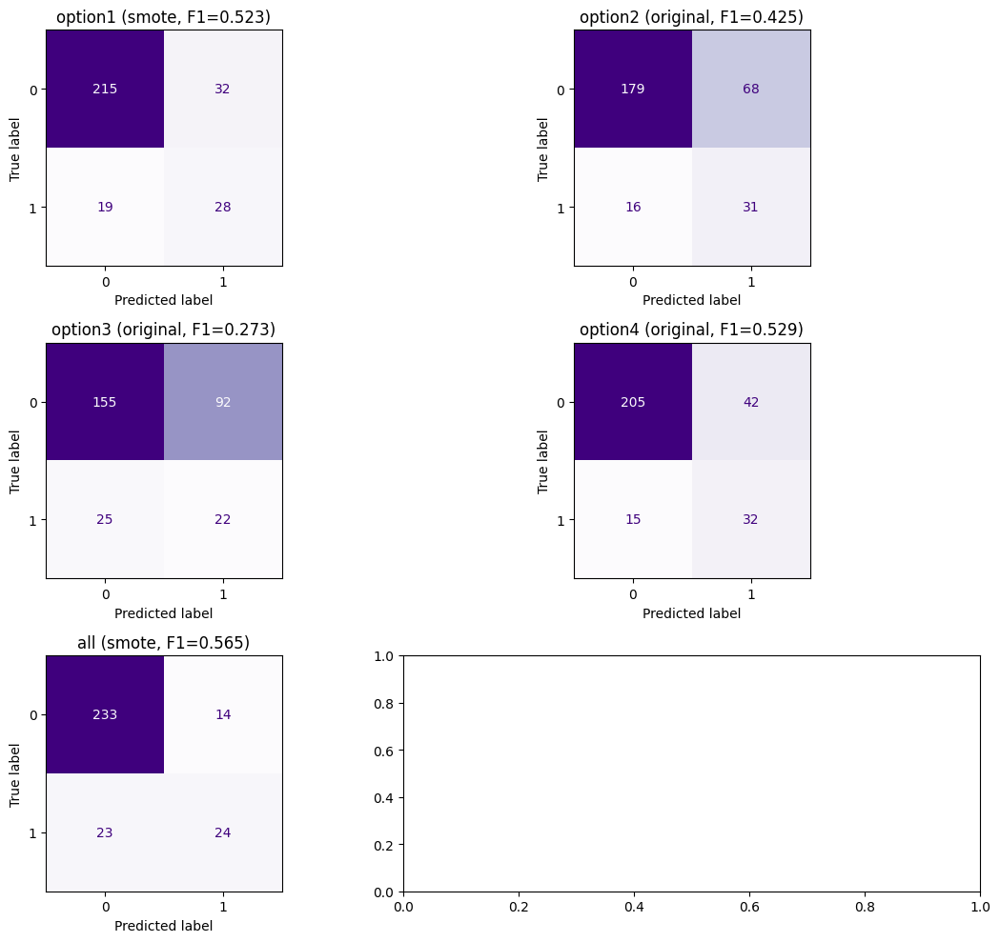


🔎 Avaliação final no TESTE (SVM)

📌 CLASSIFICATION REPORT (TESTE):
              precision    recall  f1-score   support

           0       0.87      0.90      0.89       247
           1       0.38      0.32      0.35        47

    accuracy                           0.81       294
   macro avg       0.63      0.61      0.62       294
weighted avg       0.80      0.81      0.80       294


📌 MATRIZ DE CONFUSÃO (TESTE):
 [[223  24]
 [ 32  15]]


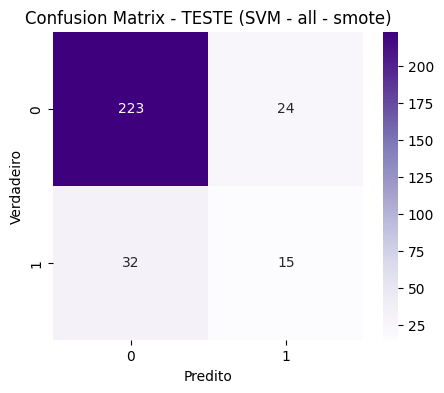

In [ ]:
# ============================================
# STORAGE
# ============================================
best_models_svm_variant = {}
best_scores_svm_variant = {}
best_overall_per_option_svm = {}

# ============================================
# PARAM GRID (linear separado do rbf)
# ============================================
param_grid = [
    {"kernel": ["linear"], "C": [0.1, 1, 10]},
    {"kernel": ["rbf"], "C": [0.1, 1, 10], "gamma": ["scale", "auto"]}
]

# ============================================
# LOOP POR OPTION
# ============================================
for name, cols in cols_options.items():
    print(f"\n🔷 Testando SVM - {name} ({len(cols)} features)")

    X_val_sub = X_val_one_hot[cols].to_numpy()
    y_val_arr = y_val.to_numpy().ravel()

    variants = [("original", X_train_one_hot, y_train)]

    if 'X_train_smote' in globals() and 'y_train_smote' in globals():
        variants.append(("smote", X_train_smote, y_train_smote))
    else:
        print("  ⚠️ X_train_smote / y_train_smote não encontrados — usando apenas 'original'.")

    best_models_svm_variant[name] = {}
    best_scores_svm_variant[name] = {}

    # ------------------------------------------
    # LOOP POR VARIANTE (original / smote)
    # ------------------------------------------
    for variant_name, X_tr_df, y_tr_obj in variants:
        print(f"\n  ▶ Variante: {variant_name}")

        X_train_sub = X_tr_df[cols].to_numpy()
        y_train_sub = y_tr_obj.to_numpy().ravel()

        # class_weight só faz sentido no original
        if variant_name == "original":
            svm_base = SVC(class_weight="balanced", probability=False)
        else:
            svm_base = SVC(class_weight=None, probability=False)

        grid = GridSearchCV(
            estimator=svm_base,
            param_grid=param_grid,
            scoring="f1",
            cv=5,
            n_jobs=-1,
            verbose=0
        )

        grid.fit(X_train_sub, y_train_sub)
        best_svm = grid.best_estimator_

        # ===== VALIDAÇÃO =====
        y_val_pred = best_svm.predict(X_val_sub)
        f1_val = f1_score(y_val_arr, y_val_pred)

        print(f"    -> F1_val ({variant_name}): {f1_val:.4f}")
        print("    -> Parâmetros:", grid.best_params_)
        print(classification_report(y_val_arr, y_val_pred))
        print("    Matriz de confusão:\n", confusion_matrix(y_val_arr, y_val_pred))

        best_models_svm_variant[name][variant_name] = best_svm
        best_scores_svm_variant[name][variant_name] = f1_val

    # -------------------------------------------------------
    # QUAL VARIANTE GANHOU NESTE OPTION?
    # -------------------------------------------------------
    winner_variant = max(best_scores_svm_variant[name], key=best_scores_svm_variant[name].get)
    best_overall_per_option_svm[name] = {
        "variant": winner_variant,
        "model": best_models_svm_variant[name][winner_variant],
        "f1": best_scores_svm_variant[name][winner_variant]
    }

    print(f"\n  ✅ Vencedor para {name}: {winner_variant} (F1={best_scores_svm_variant[name][winner_variant]:.4f})")

# =====================================================================
# MELHOR OPTION GLOBAL ENTRE TODOS OS SVM
# =====================================================================
best_option_svm = max(best_overall_per_option_svm, key=lambda k: best_overall_per_option_svm[k]["f1"])
info = best_overall_per_option_svm[best_option_svm]
final_svm_model = info["model"]
final_variant_svm = info["variant"]
final_f1_svm = info["f1"]

print(f"\n\n🎯 MELHOR MODELO GLOBAL (SVM):")
print(f"Option: {best_option_svm}")
print(f"Variante: {final_variant_svm}")
print(f"F1_val: {final_f1_svm:.4f}")

joblib.dump(final_svm_model, f"svm_best_{best_option_svm}_{final_variant_svm}.pkl")
print(f"💾 Modelo salvo como svm_best_{best_option_svm}_{final_variant_svm}.pkl")

# =====================================================================
# MATRIZES DE CONFUSÃO DOS VENCEDORES DE CADA OPTION
# =====================================================================
fig, axes = plt.subplots(3, 2, figsize=(12, 10))
axes = axes.flatten()

for i, (name, cols) in enumerate(cols_options.items()):
    info = best_overall_per_option_svm[name]
    model = info["model"]
    variant = info["variant"]
    f1_val = info["f1"]

    X_val_sub = X_val_one_hot[cols].to_numpy()
    y_pred = model.predict(X_val_sub)
    cm = confusion_matrix(y_val_arr, y_pred)

    ConfusionMatrixDisplay(confusion_matrix=cm).plot(ax=axes[i], cmap="Purples", colorbar=False)
    axes[i].set_title(f"{name} ({variant}, F1={f1_val:.3f})")

plt.tight_layout()
plt.show()

# =====================================================================
# AVALIAÇÃO FINAL NO TESTE
# =====================================================================
print("\n🔎 Avaliação final no TESTE (SVM)")

model_path = f"svm_best_{best_option_svm}_{final_variant_svm}.pkl"
svm_loaded = joblib.load(model_path)

X_test_sub = X_test_one_hot[cols_options[best_option_svm]].to_numpy()
y_test_arr = y_test.to_numpy().ravel()

y_test_pred = svm_loaded.predict(X_test_sub)

print("\n📌 CLASSIFICATION REPORT (TESTE):")
print(classification_report(y_test_arr, y_test_pred))

cm_test = confusion_matrix(y_test_arr, y_test_pred)
print("\n📌 MATRIZ DE CONFUSÃO (TESTE):\n", cm_test)

plt.figure(figsize=(5,4))
sns.heatmap(cm_test, annot=True, fmt="d", cmap="Purples")
plt.title(f"Confusion Matrix - TESTE (SVM - {best_option_svm} - {final_variant_svm})")
plt.xlabel("Predito")
plt.ylabel("Verdadeiro")
plt.show()


## 3.4 XGBoost


⚡ Testando XGBoost - option1 (18 features)

  ▶ Variante: original
    scale_pos_weight: 5.168
    -> F1_val (original): 0.5042
    -> Melhores parâmetros: {'colsample_bytree': 0.8, 'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 200, 'subsample': 0.8}
              precision    recall  f1-score   support

           0       0.92      0.83      0.87       247
           1       0.42      0.64      0.50        47

    accuracy                           0.80       294
   macro avg       0.67      0.73      0.69       294
weighted avg       0.84      0.80      0.82       294

    Matriz de confusão:
 [[205  42]
 [ 17  30]]

  ▶ Variante: smote
    scale_pos_weight: 1.000
    -> F1_val (smote): 0.5581
    -> Melhores parâmetros: {'colsample_bytree': 1.0, 'learning_rate': 0.1, 'max_depth': 6, 'n_estimators': 100, 'subsample': 0.8}
              precision    recall  f1-score   support

           0       0.91      0.94      0.92       247
           1       0.62      0.51      0.56  

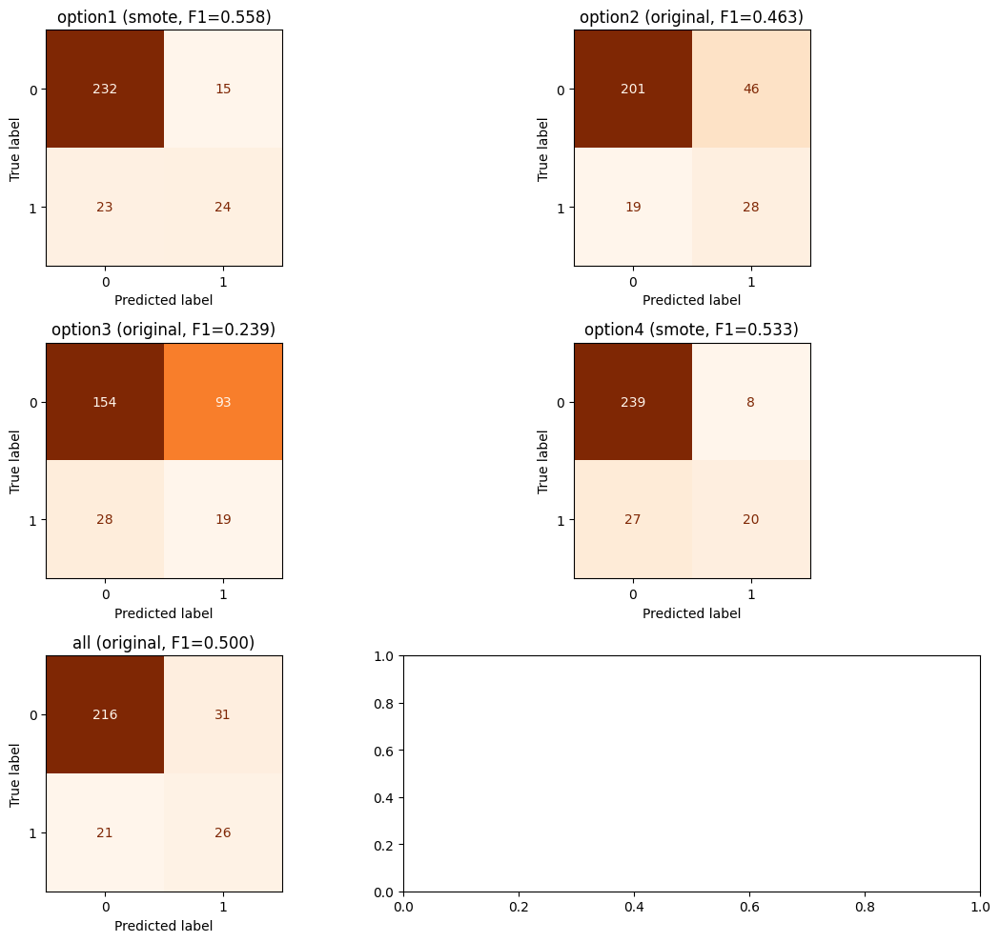


🔎 Avaliação final no conjunto de TESTE (XGBoost)

              precision    recall  f1-score   support

           0       0.87      0.91      0.89       247
           1       0.36      0.26      0.30        47

    accuracy                           0.81       294
   macro avg       0.61      0.59      0.59       294
weighted avg       0.79      0.81      0.80       294

Matriz de confusão (TESTE):
 [[226  21]
 [ 35  12]]


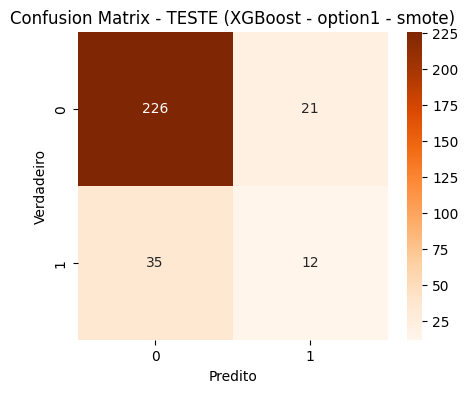

In [ ]:
from xgboost import XGBClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import f1_score, classification_report, confusion_matrix, ConfusionMatrixDisplay
import matplotlib.pyplot as plt
import seaborn as sns
import joblib
import numpy as np

# ============================================
# STORAGE
# ============================================
best_models_xgb_variant = {}
best_scores_xgb_variant = {}
best_overall_per_option_xgb = {}

# ============================================
# PARAM GRID
# ============================================
param_grid = {
    "n_estimators": [100, 200],
    "max_depth": [3, 6],
    "learning_rate": [0.01, 0.1],
    "subsample": [0.8, 1.0],
    "colsample_bytree": [0.8, 1.0],
}

# ============================================
# LOOP POR OPTION
# ============================================
for name, cols in cols_options.items():
    print(f"\n⚡ Testando XGBoost - {name} ({len(cols)} features)")

    X_val_sub = X_val_one_hot[cols].to_numpy()
    y_val_arr = y_val.to_numpy().ravel()

    variants = [("original", X_train_one_hot, y_train)]
    if "X_train_smote" in globals() and "y_train_smote" in globals():
        variants.append(("smote", X_train_smote, y_train_smote))
    else:
        print("  ⚠️ X_train_smote / y_train_smote não encontrados — usando apenas 'original'.")

    best_models_xgb_variant[name] = {}
    best_scores_xgb_variant[name] = {}

    # ------------------------------------------
    # LOOP POR VARIANTE (original / smote)
    # ------------------------------------------
    for variant_name, X_tr_df, y_tr_obj in variants:
        print(f"\n  ▶ Variante: {variant_name}")

        X_tr = X_tr_df[cols].to_numpy()
        y_tr = y_tr_obj.to_numpy().ravel()

        if variant_name == "original":
            n_pos = (y_tr == 1).sum()
            n_neg = (y_tr == 0).sum()
            scale_pos_weight = float(n_neg) / max(1.0, float(n_pos))
        else:
            scale_pos_weight = 1.0

        print(f"    scale_pos_weight: {scale_pos_weight:.3f}")

        xgb = XGBClassifier(
            objective="binary:logistic",
            use_label_encoder=False,
            eval_metric="logloss",
            scale_pos_weight=scale_pos_weight,
            n_jobs=-1,
            random_state=42,
            verbosity=0
        )

        grid = GridSearchCV(
            estimator=xgb,
            param_grid=param_grid,
            scoring="f1",
            cv=5,
            n_jobs=-1,
            verbose=0
        )

        grid.fit(X_tr, y_tr)
        best_xgb = grid.best_estimator_

        # ===== VALIDAÇÃO =====
        y_val_pred = best_xgb.predict(X_val_sub)
        f1_val = f1_score(y_val_arr, y_val_pred)

        print(f"    -> F1_val ({variant_name}): {f1_val:.4f}")
        print("    -> Melhores parâmetros:", grid.best_params_)
        print(classification_report(y_val_arr, y_val_pred))
        print("    Matriz de confusão:\n", confusion_matrix(y_val_arr, y_val_pred))

        best_models_xgb_variant[name][variant_name] = best_xgb
        best_scores_xgb_variant[name][variant_name] = f1_val

    # -------------------------------------------------------
    # Melhor variante para este conjunto de features
    # -------------------------------------------------------
    winner_variant = max(best_scores_xgb_variant[name], key=best_scores_xgb_variant[name].get)
    best_overall_per_option_xgb[name] = {
        "variant": winner_variant,
        "model": best_models_xgb_variant[name][winner_variant],
        "f1": best_scores_xgb_variant[name][winner_variant]
    }

    print(f"  ✅ Vencedor para {name}: {winner_variant} com F1={best_scores_xgb_variant[name][winner_variant]:.4f}")

# ============================================
# Melhor modelo global
# ============================================
best_option_xgb = max(best_overall_per_option_xgb, key=lambda k: best_overall_per_option_xgb[k]["f1"])
info = best_overall_per_option_xgb[best_option_xgb]
final_xgb_model = info["model"]
final_variant_xgb = info["variant"]
final_f1_xgb = info["f1"]

print(f"\n✅ Melhor modelo (XGBoost): {best_option_xgb} ({final_variant_xgb}) com F1={final_f1_xgb:.4f}")

joblib.dump(final_xgb_model, f"xgb_best_{best_option_xgb}_{final_variant_xgb}.pkl")
print(f"Modelo salvo como xgb_best_{best_option_xgb}_{final_variant_xgb}.pkl")

# ============================================
# Plotar matrizes de confusão (vencedores por option)
# ============================================
fig, axes = plt.subplots(3, 2, figsize=(12, 10))
axes = axes.flatten()

for i, (name, cols) in enumerate(cols_options.items()):
    info = best_overall_per_option_xgb[name]
    model = info["model"]
    variant = info["variant"]
    f1_val = info["f1"]

    X_val_sub = X_val_one_hot[cols].to_numpy()
    y_pred = model.predict(X_val_sub)
    cm = confusion_matrix(y_val_arr, y_pred)

    ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=[0, 1]).plot(ax=axes[i], cmap="Oranges", colorbar=False)
    axes[i].set_title(f"{name} ({variant}, F1={f1_val:.3f})", fontsize=12)

plt.tight_layout()
plt.show()

# ============================================
# Avaliação final no TESTE
# ============================================
print("\n🔎 Avaliação final no conjunto de TESTE (XGBoost)\n")

model_path = f"xgb_best_{best_option_xgb}_{final_variant_xgb}.pkl"
xgb_loaded = joblib.load(model_path)

X_test_sub = X_test_one_hot[cols_options[best_option_xgb]].to_numpy()
y_test_arr = y_test.to_numpy().ravel()

y_test_pred = xgb_loaded.predict(X_test_sub)

print(classification_report(y_test_arr, y_test_pred))
cm_test = confusion_matrix(y_test_arr, y_test_pred)
print("Matriz de confusão (TESTE):\n", cm_test)

plt.figure(figsize=(5,4))
sns.heatmap(cm_test, annot=True, fmt="d", cmap="Oranges")
plt.title(f"Confusion Matrix - TESTE (XGBoost - {best_option_xgb} - {final_variant_xgb})")
plt.xlabel("Predito")
plt.ylabel("Verdadeiro")
plt.show()


## 3.5 MLP by sckit-learn


🤖 Testando MLP - option1 (18 features)
  ▶ Variante: original
    → F1_val (original): 0.5278
    → Melhores parâmetros: {'activation': 'tanh', 'alpha': 0.0001, 'hidden_layer_sizes': (50, 25), 'learning_rate_init': 0.01}
              precision    recall  f1-score   support

           0       0.90      0.98      0.93       247
           1       0.76      0.40      0.53        47

    accuracy                           0.88       294
   macro avg       0.83      0.69      0.73       294
weighted avg       0.87      0.88      0.87       294

    Matriz de confusão:
 [[241   6]
 [ 28  19]]
  ▶ Variante: oversample
    → F1_val (oversample): 0.5714
    → Melhores parâmetros: {'activation': 'relu', 'alpha': 0.001, 'hidden_layer_sizes': (50, 25), 'learning_rate_init': 0.01}
              precision    recall  f1-score   support

           0       0.91      0.95      0.93       247
           1       0.65      0.51      0.57        47

    accuracy                           0.88       294


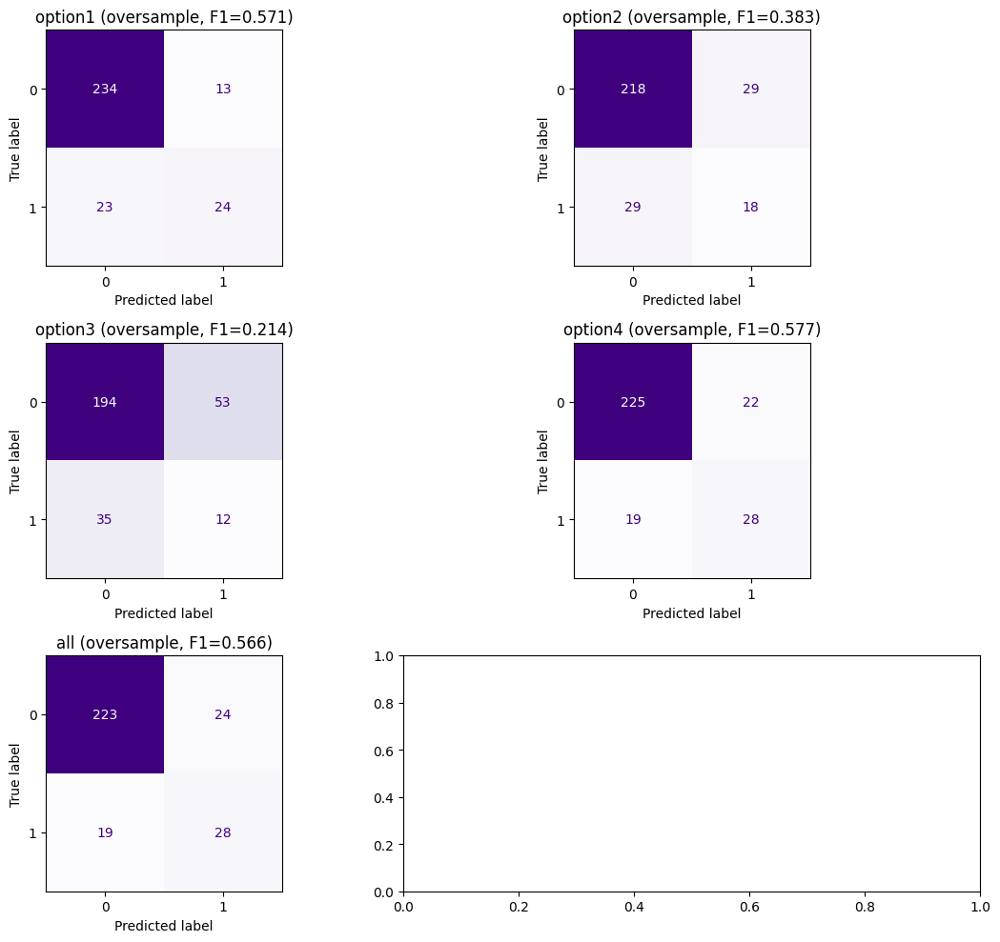


🔎 Avaliação final no TESTE
              precision    recall  f1-score   support

           0       0.89      0.91      0.90       247
           1       0.48      0.43      0.45        47

    accuracy                           0.83       294
   macro avg       0.68      0.67      0.68       294
weighted avg       0.83      0.83      0.83       294

Matriz de confusão (TESTE):
 [[225  22]
 [ 27  20]]


In [ ]:
# MLP atualizado com variantes: original e oversample
from sklearn.utils import resample, shuffle
warnings.filterwarnings("ignore", category=ConvergenceWarning)

best_models_mlp_variant = {}
best_scores_mlp_variant = {}
best_overall_per_option_mlp = {}

param_grid = {
    "hidden_layer_sizes": [(50,), (100,), (50, 25)],
    "activation": ["relu", "tanh"],
    "alpha": [1e-4, 1e-3],
    "learning_rate_init": [1e-3, 1e-2]
}

for name, cols in cols_options.items():
    print(f"\n🤖 Testando MLP - {name} ({len(cols)} features)")

    # Preparar validação (sempre igual)
    X_val_sub = X_val_one_hot[cols]

    # Variantes: original e oversample
    variants = ["original", "oversample"]
    best_models_mlp_variant[name] = {}
    best_scores_mlp_variant[name] = {}

    for variant in variants:
        print(f"  ▶ Variante: {variant}")

        # ==============================
        # ORIGINAL (sem oversampling)
        # ==============================
        if variant == "original":
            X_tr = X_train_one_hot[cols].copy()
            y_tr = y_train.copy()

        # ==============================
        # OVERSAMPLE manual
        # ==============================
        else:
            X_tr = X_train_one_hot[cols].copy()
            y_tr = y_train.copy()

            df_tr = X_tr.copy()
            df_tr["__target__"] = y_tr.values

            majority = df_tr[df_tr["__target__"] == 0]
            minority = df_tr[df_tr["__target__"] == 1]

            if len(minority) == 0:
                raise ValueError("Nenhuma instância positiva disponível!")

            if len(minority) < len(majority):
                minority_upsampled = resample(
                    minority,
                    replace=True,
                    n_samples=len(majority),
                    random_state=42
                )
                df_bal = pd.concat([majority, minority_upsampled], axis=0)
            else:
                df_bal = df_tr.copy()

            df_bal = df_bal.reset_index(drop=True)
            y_tr = df_bal["__target__"].values
            X_tr = df_bal.drop(columns="__target__").reset_index(drop=True)

            X_tr, y_tr = shuffle(X_tr, y_tr, random_state=42)

        # ==============================
        # Treinar MLP + GridSearch
        # ==============================
        mlp = MLPClassifier(
            solver="adam",
            early_stopping=True,
            validation_fraction=0.1,
            n_iter_no_change=20,
            max_iter=1000,
            random_state=42
        )

        grid = GridSearchCV(
            estimator=mlp,
            param_grid=param_grid,
            scoring="f1",
            cv=5,
            n_jobs=-1,
            verbose=0,
            error_score="raise"
        )

        grid.fit(X_tr, y_tr)
        best_mlp = grid.best_estimator_

        # ==============================
        # Avaliação externa
        # ==============================
        y_val_pred = best_mlp.predict(X_val_sub)
        f1 = f1_score(y_val, y_val_pred)

        print(f"    → F1_val ({variant}): {f1:.4f}")
        print("    → Melhores parâmetros:", grid.best_params_)
        print(classification_report(y_val, y_val_pred))
        print("    Matriz de confusão:\n", confusion_matrix(y_val, y_val_pred))

        best_models_mlp_variant[name][variant] = best_mlp
        best_scores_mlp_variant[name][variant] = f1

    # Escolher a melhor variante para este conjunto de features
    winner_variant = max(best_scores_mlp_variant[name], key=best_scores_mlp_variant[name].get)
    best_overall_per_option_mlp[name] = {
        "variant": winner_variant,
        "model": best_models_mlp_variant[name][winner_variant],
        "f1": best_scores_mlp_variant[name][winner_variant]
    }

    print(f"  ✅ Vencedor em {name}: {winner_variant} (F1={best_scores_mlp_variant[name][winner_variant]:.4f})")


# ---------------------------------
# Melhor modelo global
# ---------------------------------
best_option_mlp = max(best_overall_per_option_mlp, key=lambda k: best_overall_per_option_mlp[k]["f1"])
final_info_mlp = best_overall_per_option_mlp[best_option_mlp]

final_mlp_model = final_info_mlp["model"]
final_variant_mlp = final_info_mlp["variant"]
final_f1_mlp = final_info_mlp["f1"]

print(f"\n🎉 Melhor MLP GLOBAL: {best_option_mlp} ({final_variant_mlp}) com F1={final_f1_mlp:.4f}")

model_path = f"mlp_best_{best_option_mlp}_{final_variant_mlp}.pkl"
joblib.dump(final_mlp_model, model_path)
print(f"Modelo salvo em: {model_path}")

# ---------------------------------
# Plotar Confusion Matrices (apenas vencedores por option)
# ---------------------------------
fig, axes = plt.subplots(3, 2, figsize=(12, 10))
axes = axes.flatten()

for i, (name, cols) in enumerate(cols_options.items()):
    info = best_overall_per_option_mlp[name]
    winner_model = info["model"]
    variant = info["variant"]
    f1_val = info["f1"]

    y_pred = winner_model.predict(X_val_one_hot[cols])
    cm = confusion_matrix(y_val, y_pred)

    disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=[0, 1])
    disp.plot(ax=axes[i], cmap="Purples", colorbar=False)
    axes[i].set_title(f"{name} ({variant}, F1={f1_val:.3f})")

plt.tight_layout()
plt.show()

# ---------------------------------
# Avaliação no TESTE
# ---------------------------------
print("\n🔎 Avaliação final no TESTE")
mlp_loaded = joblib.load(model_path)

X_test_sub = X_test_one_hot[cols_options[best_option_mlp]]
y_test_pred = mlp_loaded.predict(X_test_sub)

print(classification_report(y_test, y_test_pred))
print("Matriz de confusão (TESTE):\n", confusion_matrix(y_test, y_test_pred))


## 3.6 Neural network by keras



##############################################
###########   TRAINING OPTION1   ###########
##############################################


   TREINANDO: ORIGINAL


Treinando com parâmetros: {'n_hidden': 1, 'n_units': 32, 'dropout': 0.2, 'lr': 0.001}
 — val_f1: 0.4186 — val_f1_weighted: 0.7698
 — val_f1: 0.4324 — val_f1_weighted: 0.7489
 — val_f1: 0.4564 — val_f1_weighted: 0.7581
 — val_f1: 0.4416 — val_f1_weighted: 0.7442
 — val_f1: 0.4444 — val_f1_weighted: 0.7598
 — val_f1: 0.4552 — val_f1_weighted: 0.7631
 — val_f1: 0.4604 — val_f1_weighted: 0.7734
 — val_f1: 0.4615 — val_f1_weighted: 0.7685
 — val_f1: 0.4476 — val_f1_weighted: 0.7625
 — val_f1: 0.4526 — val_f1_weighted: 0.7728
 — val_f1: 0.4366 — val_f1_weighted: 0.7592
 — val_f1: 0.4429 — val_f1_weighted: 0.7647
 — val_f1: 0.4429 — val_f1_weighted: 0.7647
 — val_f1: 0.4397 — val_f1_weighted: 0.7620
 — val_f1: 0.4507 — val_f1_weighted: 0.7653
 — val_f1: 0.4397 — val_f1_weighted: 0.7620
 — val_f1: 0.4397 — val_f1_weighted: 0.762

F1-score Val = 0.5000

Melhor combinação para smote: {'n_hidden': 1, 'n_units': 32, 'dropout': 0.2, 'lr': 0.001}

MELHOR VARIANTE [OPTION1]: SMOTE
F1-score Val: 0.5517

10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 

======== CONFUSION MATRIX (TEST) ==========
[[195  52]
 [ 24  23]]

======== CLASSIFICATION REPORT (TEST) ======
              precision    recall  f1-score   support

           0       0.89      0.79      0.84       247
           1       0.31      0.49      0.38        47

    accuracy                           0.74       294
   macro avg       0.60      0.64      0.61       294
weighted avg       0.80      0.74      0.76       294


======== ROC-AUC (TEST) ======
AUC = 0.682401584977173


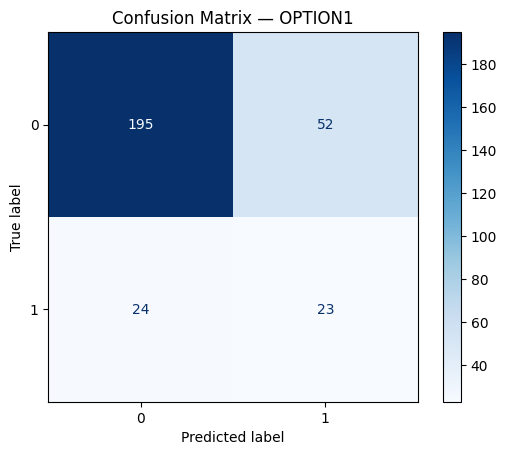



##############################################
###########   TRAINING OPTION2   ###########
##############################################


   TREINANDO: ORIGINAL


Treinando com parâmetros: {'n_hidden': 1, 'n_units': 32, 'dropout': 0.2, 'lr': 0.001}
 — val_f1: 0.2456 — val_f1_weighted: 0.4780
 — val_f1: 0.3179 — val_f1_weighted: 0.6929
 — val_f1: 0.4526 — val_f1_weighted: 0.7728
 — val_f1: 0.5091 — val_f1_weighted: 0.8266
 — val_f1: 0.4557 — val_f1_weighted: 0.7450
 — val_f1: 0.5116 — val_f1_weighted: 0.8066
 — val_f1: 0.4964 — val_f1_weighted: 0.7909
 — val_f1: 0.4857 — val_f1_weighted: 0.7828
 — val_f1: 0.4925 — val_f1_weighted: 0.7930
 — val_f1: 0.4853 — val_f1_weighted: 0.7876
 — val_f1: 0.4853 — val_f1_weighted: 0.7876
 — val_f1: 0.4733 — val_f1_weighted: 0.7889
 — val_f1: 0.4928 — val_f1_weighted: 0.7882
 — val_f1: 0.4768 — val_f1_weighted: 0.7645
 — val_f1: 0.4857 — val_f1_weighted: 0.7828
 — val_f1: 0.4857 — val_f1_weighted: 0.7828
 — val_f1: 0.4769 — val_f1_weighted: 0.791

F1-score Val = 0.4545

Melhor combinação para smote: {'n_hidden': 2, 'n_units': 128, 'dropout': 0.4, 'lr': 0.0005}

MELHOR VARIANTE [OPTION2]: ORIGINAL
F1-score Val: 0.5045

10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 

======== CONFUSION MATRIX (TEST) ==========
[[195  52]
 [ 25  22]]

======== CLASSIFICATION REPORT (TEST) ======
              precision    recall  f1-score   support

           0       0.89      0.79      0.84       247
           1       0.30      0.47      0.36        47

    accuracy                           0.74       294
   macro avg       0.59      0.63      0.60       294
weighted avg       0.79      0.74      0.76       294


======== ROC-AUC (TEST) ======
AUC = 0.6726677577741408


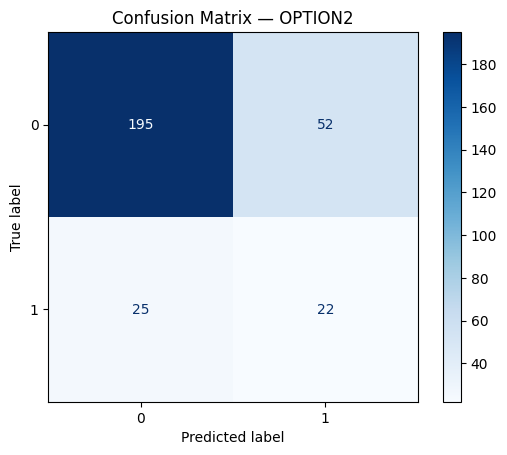



##############################################
###########   TRAINING OPTION3   ###########
##############################################


   TREINANDO: ORIGINAL


Treinando com parâmetros: {'n_hidden': 1, 'n_units': 32, 'dropout': 0.2, 'lr': 0.001}
 — val_f1: 0.1538 — val_f1_weighted: 0.6363
 — val_f1: 0.1879 — val_f1_weighted: 0.6386
 — val_f1: 0.2326 — val_f1_weighted: 0.6107
 — val_f1: 0.2486 — val_f1_weighted: 0.6080
 — val_f1: 0.2360 — val_f1_weighted: 0.5992
 — val_f1: 0.2353 — val_f1_weighted: 0.5782
 — val_f1: 0.2308 — val_f1_weighted: 0.5873
 — val_f1: 0.2246 — val_f1_weighted: 0.5723
 — val_f1: 0.2353 — val_f1_weighted: 0.5782
 — val_f1: 0.2353 — val_f1_weighted: 0.5782
 — val_f1: 0.2340 — val_f1_weighted: 0.5751
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
F1-score Val = 0.1538

Treinando com parâmetros: {'n_hidden': 2, 'n_units': 64, 'dropout': 0.3, 'lr': 0.001}
 — val_f1: 0.2428 — val_f1_weighted: 0.6137
 — val_f1: 0.2454 — val_f1_weighted: 0.6362
 — val_f1: 0.2652 — val_f

F1-score Val = 0.2500

Melhor combinação para smote: {'n_hidden': 2, 'n_units': 128, 'dropout': 0.4, 'lr': 0.0005}

MELHOR VARIANTE [OPTION3]: SMOTE
F1-score Val: 0.2500

10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 

======== CONFUSION MATRIX (TEST) ==========
[[178  69]
 [ 34  13]]

======== CLASSIFICATION REPORT (TEST) ======
              precision    recall  f1-score   support

           0       0.84      0.72      0.78       247
           1       0.16      0.28      0.20        47

    accuracy                           0.65       294
   macro avg       0.50      0.50      0.49       294
weighted avg       0.73      0.65      0.68       294


======== ROC-AUC (TEST) ======
AUC = 0.5683521405805841


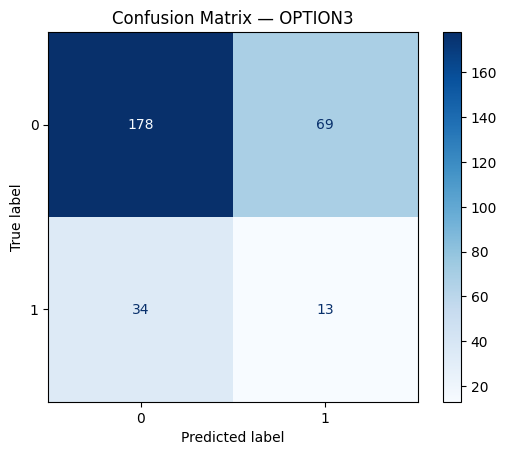



##############################################
###########   TRAINING OPTION4   ###########
##############################################


   TREINANDO: ORIGINAL


Treinando com parâmetros: {'n_hidden': 1, 'n_units': 32, 'dropout': 0.2, 'lr': 0.001}
 — val_f1: 0.2879 — val_f1_weighted: 0.7130
 — val_f1: 0.3889 — val_f1_weighted: 0.7358
 — val_f1: 0.3972 — val_f1_weighted: 0.7439
 — val_f1: 0.4110 — val_f1_weighted: 0.7424
 — val_f1: 0.4143 — val_f1_weighted: 0.7526
 — val_f1: 0.4478 — val_f1_weighted: 0.7748
 — val_f1: 0.4400 — val_f1_weighted: 0.7494
 — val_f1: 0.4697 — val_f1_weighted: 0.7863
 — val_f1: 0.4925 — val_f1_weighted: 0.7930
 — val_f1: 0.5000 — val_f1_weighted: 0.7888
 — val_f1: 0.4930 — val_f1_weighted: 0.7833
 — val_f1: 0.4964 — val_f1_weighted: 0.7909
 — val_f1: 0.5000 — val_f1_weighted: 0.7985
 — val_f1: 0.4892 — val_f1_weighted: 0.7855
 — val_f1: 0.5113 — val_f1_weighted: 0.8019
 — val_f1: 0.4857 — val_f1_weighted: 0.7828
 — val_f1: 0.5116 — val_f1_weighted: 0.806

F1-score Val = 0.5210

Melhor combinação para smote: {'n_hidden': 1, 'n_units': 32, 'dropout': 0.2, 'lr': 0.001}

MELHOR VARIANTE [OPTION4]: ORIGINAL
F1-score Val: 0.5905

10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 

======== CONFUSION MATRIX (TEST) ==========
[[209  38]
 [ 23  24]]

======== CLASSIFICATION REPORT (TEST) ======
              precision    recall  f1-score   support

           0       0.90      0.85      0.87       247
           1       0.39      0.51      0.44        47

    accuracy                           0.79       294
   macro avg       0.64      0.68      0.66       294
weighted avg       0.82      0.79      0.80       294


======== ROC-AUC (TEST) ======
AUC = 0.744164010681368


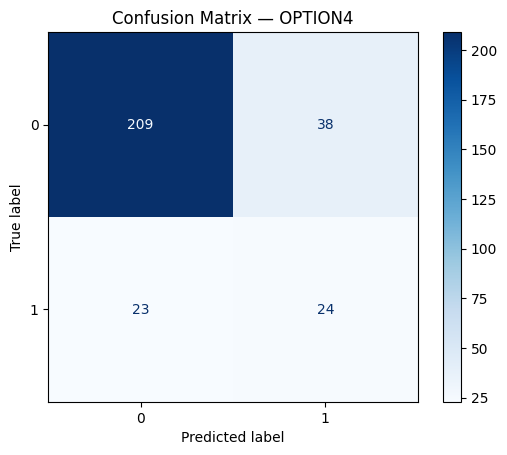



##############################################
###########   TRAINING ALL   ###########
##############################################


   TREINANDO: ORIGINAL


Treinando com parâmetros: {'n_hidden': 1, 'n_units': 32, 'dropout': 0.2, 'lr': 0.001}
 — val_f1: 0.2118 — val_f1_weighted: 0.6047
 — val_f1: 0.2987 — val_f1_weighted: 0.6788
 — val_f1: 0.3580 — val_f1_weighted: 0.6923
 — val_f1: 0.4380 — val_f1_weighted: 0.7667
 — val_f1: 0.4380 — val_f1_weighted: 0.7667
 — val_f1: 0.4651 — val_f1_weighted: 0.7882
 — val_f1: 0.4714 — val_f1_weighted: 0.7767
 — val_f1: 0.4844 — val_f1_weighted: 0.7970
 — val_f1: 0.5039 — val_f1_weighted: 0.8059
 — val_f1: 0.4823 — val_f1_weighted: 0.7800
 — val_f1: 0.5041 — val_f1_weighted: 0.8105
 — val_f1: 0.4889 — val_f1_weighted: 0.7903
 — val_f1: 0.4923 — val_f1_weighted: 0.7978
 — val_f1: 0.5000 — val_f1_weighted: 0.7937
 — val_f1: 0.4923 — val_f1_weighted: 0.7978
 — val_f1: 0.4965 — val_f1_weighted: 0.7861
 — val_f1: 0.4848 — val_f1_weighted: 0.7924
 —

F1-score Val = 0.5472

Melhor combinação para smote: {'n_hidden': 2, 'n_units': 128, 'dropout': 0.4, 'lr': 0.0005}

MELHOR VARIANTE [ALL]: ORIGINAL
F1-score Val: 0.5766

10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 

======== CONFUSION MATRIX (TEST) ==========
[[204  43]
 [ 22  25]]

======== CLASSIFICATION REPORT (TEST) ======
              precision    recall  f1-score   support

           0       0.90      0.83      0.86       247
           1       0.37      0.53      0.43        47

    accuracy                           0.78       294
   macro avg       0.64      0.68      0.65       294
weighted avg       0.82      0.78      0.79       294


======== ROC-AUC (TEST) ======
AUC = 0.7630286846412268


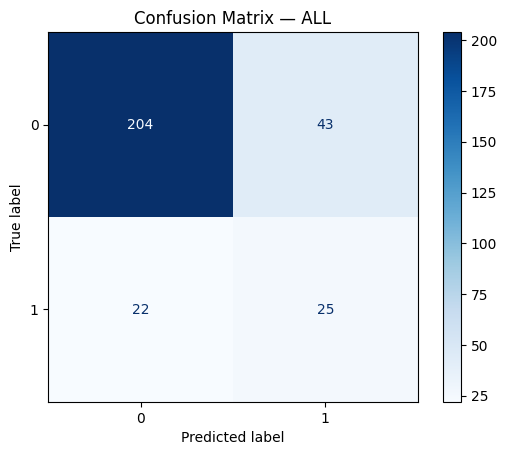

In [ ]:

# =====================================================
# CALLBACK — calcular F1 e F1_weighted por epoch
# =====================================================

class F1Metrics(Callback):
    def __init__(self, X_val, y_val):
        super().__init__()
        self.X_val = X_val
        self.y_val = y_val

    def on_epoch_end(self, epoch, logs=None):
        y_pred = (self.model.predict(self.X_val, verbose=0) > 0.5).astype(int)

        f1_bin = f1_score(self.y_val, y_pred)
        f1_weighted = f1_score(self.y_val, y_pred, average='weighted')

        logs["val_f1"] = f1_bin
        logs["val_f1_weighted"] = f1_weighted

        print(f" — val_f1: {f1_bin:.4f} — val_f1_weighted: {f1_weighted:.4f}")


# =====================================================
# Função para criar modelo
# =====================================================

def build_model(input_dim, n_hidden=1, n_units=64, dropout=0.2, lr=0.001):
    model = models.Sequential()

    for _ in range(n_hidden):
        model.add(layers.Dense(n_units, activation='relu'))
        model.add(layers.Dropout(dropout))

    model.add(layers.Dense(1, activation='sigmoid'))

    model.compile(
        optimizer=tf.keras.optimizers.Adam(learning_rate=lr),
        loss="binary_crossentropy",
        metrics=["accuracy"]
    )
    return model


# =====================================================
# COLUMN OPTIONS (passadas por ti)
# =====================================================

cols_options = {
    "option1": cols_option1_one_hot,
    "option2": cols_option2_one_hot,
    "option3": cols_option3_one_hot,
    "option4": cols_option4_one_hot,
    "all": X_train_one_hot.columns.tolist()
}


# =====================================================
# LOOP POR TODAS AS OPTIONS
# =====================================================

for option_name, cols in cols_options.items():

    print("\n\n##############################################")
    print(f"###########   TRAINING {option_name.upper()}   ###########")
    print("##############################################\n")

    # selecionar colunas certas
    X_train_sel = X_train_one_hot[cols]
    X_val_sel = X_val_one_hot[cols]
    X_test_sel = X_test_one_hot[cols]

    X_train_sel_smote = X_train_smote[cols]  # SMOTE já criado

    # guardar resultados por variante
    variants = {}

    for variant in ["original", "smote"]:

        print(f"\n========================")
        print(f"   TREINANDO: {variant.upper()}")
        print(f"========================\n")

        if variant == "original":
            X_tr = X_train_sel
            y_tr = y_train

            classes = np.unique(y_train)
            cw = compute_class_weight(class_weight="balanced", classes=classes, y=y_train)
            class_weight = {int(c): float(w) for c, w in zip(classes, cw)}

        elif variant == "smote":
            X_tr = X_train_sel_smote
            y_tr = y_train_smote
            class_weight = None

        # GRID
        param_grid = [
            {"n_hidden": 1, "n_units": 32,  "dropout": 0.2, "lr": 0.001},
            {"n_hidden": 2, "n_units": 64,  "dropout": 0.3, "lr": 0.001},
            {"n_hidden": 2, "n_units": 128, "dropout": 0.4, "lr": 0.0005},
        ]

        best_f1 = -1
        best_model = None
        best_params = None

        for params in param_grid:
            print(f"\nTreinando com parâmetros: {params}")

            model = build_model(
                input_dim=X_tr.shape[1],
                n_hidden=params["n_hidden"],
                n_units=params["n_units"],
                dropout=params["dropout"],
                lr=params["lr"],
            )

            callbacks_list = [
                EarlyStopping(patience=10, restore_best_weights=True),
                ReduceLROnPlateau(factor=0.5, patience=5, verbose=0),
                F1Metrics(X_val_sel, y_val)
            ]

            history = model.fit(
                X_tr, y_tr,
                validation_data=(X_val_sel, y_val),
                epochs=200,
                batch_size=32,
                verbose=0,
                class_weight=class_weight,
                callbacks=callbacks_list
            )

            # Best model decision based on sklearn F1
            val_pred = (model.predict(X_val_sel) > 0.5).astype(int)
            f1 = f1_score(y_val, val_pred)
            print(f"F1-score Val = {f1:.4f}")

            if f1 > best_f1:
                best_f1 = f1
                best_model = model
                best_params = params

        print(f"\nMelhor combinação para {variant}: {best_params}")
        variants[variant] = (best_model, best_f1)

    # Melhor variante global
    best_variant = max(variants, key=lambda v: variants[v][1])
    best_model, best_f1 = variants[best_variant]

    print("\n======================================")
    print(f"MELHOR VARIANTE [{option_name.upper()}]: {best_variant.upper()}")
    print(f"F1-score Val: {best_f1:.4f}")
    print("======================================\n")

    best_model.save(f"best_keras_model_{option_name}.h5")

    # ======================================
    # TEST EVALUATION PARA ESTA OPTION
    # ======================================

    test_proba = best_model.predict(X_test_sel).ravel()
    test_pred = (test_proba > 0.5).astype(int)

    print("\n======== CONFUSION MATRIX (TEST) ==========")
    cm = confusion_matrix(y_test, test_pred)
    print(cm)

    print("\n======== CLASSIFICATION REPORT (TEST) ======")
    print(classification_report(y_test, test_pred))

    print("\n======== ROC-AUC (TEST) ======")
    print("AUC =", roc_auc_score(y_test, test_proba))

    # =======================================================
    # CONFUSION MATRIX DISPLAY (PLOT)
    # =======================================================

    disp = ConfusionMatrixDisplay(confusion_matrix=cm)
    disp.plot(cmap="Blues")
    plt.title(f"Confusion Matrix — {option_name.upper()}")
    plt.show()


In [ ]:
sns.set()  # estilo básico para os gráficos

def analyze_errors(y_true, y_pred, X_data=None, model_name="Model"):
    """
    Função robusta para análise de erros.
    - y_true, y_pred: array-like (numpy ou pandas). Podem ser ravel/1D.
    - X_data: opcional. Se for DataFrame, indices retornados serão os índices do DataFrame.
              Se for numpy array, retornaremos índices inteiros.
    - Retorna: (fp_idx, fn_idx, error_data)
       - fp_idx/fn_idx: arrays com índices das amostras (relativos a X_data se DataFrame, senão inteiros)
       - error_data: DataFrame com as amostras mal classificadas (ou None se X_data não fornecido)
    """
    # normalizar inputs
    y_true_arr = np.asarray(y_true).ravel()
    y_pred_arr = np.asarray(y_pred).ravel()

    if y_true_arr.shape[0] != y_pred_arr.shape[0]:
        raise ValueError("y_true e y_pred têm tamanhos diferentes.")

    # Confusion matrix
    cm = confusion_matrix(y_true_arr, y_pred_arr)
    labels = np.unique(np.concatenate([y_true_arr, y_pred_arr]))

    plt.figure(figsize=(15, 5))

    # Plot 1: Confusion Matrix (counts)
    plt.subplot(1, 3, 1)
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
                xticklabels=labels, yticklabels=labels)
    plt.title(f'{model_name} - Confusion Matrix (counts)')
    plt.ylabel('True Label')
    plt.xlabel('Predicted Label')

    # Plot 2: Normalized Confusion Matrix (most legível em %)
    plt.subplot(1, 3, 2)
    with np.errstate(all='ignore'):
        cm_normalized = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
    # criar labels em percentagem para annot
    annot_pct = np.array([["{:.2f}%".format(x*100) if not np.isnan(x) else "0.00%" for x in row] for row in cm_normalized])
    sns.heatmap(cm_normalized, annot=annot_pct, fmt='', cmap='Blues',
                xticklabels=labels, yticklabels=labels)
    plt.title(f'{model_name} - Normalized CM')
    plt.ylabel('True Label')
    plt.xlabel('Predicted Label')

    # índices de mal-classificados (sempre inteiros relativos ao array)
    misclassified_mask = (y_true_arr != y_pred_arr)
    misclassified_idx = np.where(misclassified_mask)[0]

    print(f"\n=== {model_name} Error Analysis ===")
    print(f"Total samples: {len(y_true_arr)}")
    print(f"Total misclassified: {len(misclassified_idx)}")
    print(f"Error rate: {len(misclassified_idx)/len(y_true_arr):.2%}")

    # preparar retorno de error_data (se X_data fornecido)
    error_data = None
    if X_data is not None:
        # se for DataFrame, usar iloc[misclassified_idx] e preservamos o índice original
        if isinstance(X_data, pd.DataFrame):
            error_data = X_data.iloc[misclassified_idx].copy()
            # incluir colunas auxiliares com true/pred
            error_data = error_data.assign(_true=pd.Series(y_true_arr[misclassified_idx], index=error_data.index),
                                           _pred=pd.Series(y_pred_arr[misclassified_idx], index=error_data.index))
        else:
            # numpy array ou similar: devolve DataFrame com colunas genéricas
            try:
                error_data = pd.DataFrame(X_data[misclassified_idx])
                error_data['_true'] = y_true_arr[misclassified_idx]
                error_data['_pred'] = y_pred_arr[misclassified_idx]
            except Exception:
                error_data = None

    # Distinções de erro: se for problema binário 0/1, calcular FP/FN
    fp_idx = np.array([], dtype=int)
    fn_idx = np.array([], dtype=int)
    unique_labels = np.unique(y_true_arr)
    if set(unique_labels) <= {0, 1} or len(unique_labels) == 2:
        # tratar rótulos possivelmente diferentes (ex: [1, 2]) - assumir pos_label = maior
        labels_sorted = np.sort(unique_labels)
        neg_label, pos_label = labels_sorted[0], labels_sorted[-1]
        fp_mask = (y_true_arr == neg_label) & (y_pred_arr == pos_label)
        fn_mask = (y_true_arr == pos_label) & (y_pred_arr == neg_label)
        fp_idx = np.where(fp_mask)[0]
        fn_idx = np.where(fn_mask)[0]

        print(f"False Positives (predito {pos_label} quando era {neg_label}): {len(fp_idx)}")
        print(f"False Negatives (predito {neg_label} quando era {pos_label}): {len(fn_idx)}")
    else:
        # multiclass: reportar confusões por par (top confusions)
        print("\nMulticlass detected — listando os 5 pares true->pred mais comuns entre os erros:")
        if len(misclassified_idx) > 0:
            pairs, counts = np.unique(list(zip(y_true_arr[misclassified_idx], y_pred_arr[misclassified_idx])), axis=0, return_counts=True)
            # pairs e counts não retornam diretamente com unique em axis=0 com numpy <complex>, então vamos calcular manualmente:
            from collections import Counter
            c = Counter(zip(y_true_arr[misclassified_idx], y_pred_arr[misclassified_idx]))
            for ((t,p),cnt) in c.most_common(5):
                print(f"  {t} -> {p}: {cnt}")

    # Plot 3: resumo dos tipos de erro (binário) ou barras simples
    plt.subplot(1, 3, 3)
    if fp_idx.size + fn_idx.size > 0:
        if fp_idx.size + fn_idx.size > 0 and (fp_idx.size>0 or fn_idx.size>0) and (fp_idx.size+fn_idx.size)>0:
            plt.bar(['False Positives', 'False Negatives'], [len(fp_idx), len(fn_idx)])
            plt.title('Error Type Distribution')
    else:
        # multiclass: mostrar contagem de erros por classe verdadeira (top 6)
        if len(misclassified_idx) > 0:
            true_vals, true_counts = np.unique(y_true_arr[misclassified_idx], return_counts=True)
            # ordenar e escolher top6
            order = np.argsort(-true_counts)[:6]
            plt.bar([str(x) for x in true_vals[order]], true_counts[order])
            plt.title('Misclassifications by True Class (top 6)')
        else:
            plt.text(0.5, 0.5, 'No misclassifications', ha='center', va='center')
            plt.axis('off')

    plt.tight_layout()
    plt.show()

    # Se X_data era DataFrame, convertemos fp_idx/fn_idx a labels/indices do DataFrame ao retornar
    if isinstance(X_data, pd.DataFrame):
        fp_idx_out = X_data.index[fp_idx].to_numpy() if fp_idx.size>0 else np.array([], dtype=object)
        fn_idx_out = X_data.index[fn_idx].to_numpy() if fn_idx.size>0 else np.array([], dtype=object)
    else:
        fp_idx_out = fp_idx
        fn_idx_out = fn_idx

    return fp_idx_out, fn_idx_out, error_data



Processando: best_keras_model_all.h5
  -> option detected: all, variant: original

=== best_keras_model_all.h5 (option=all, variant=original) Error Analysis ===
Total samples: 294
Total misclassified: 65
Error rate: 22.11%
False Positives (predito 1 quando era 0): 43
False Negatives (predito 0 quando era 1): 22


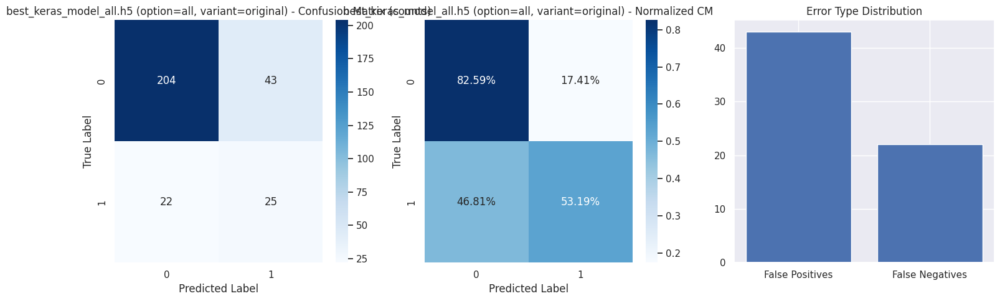

  ✅ Feito para best_keras_model_all.h5: FP=43, FN=22

Processando: best_keras_model_option1.h5
  -> option detected: option1, variant: original

=== best_keras_model_option1.h5 (option=option1, variant=original) Error Analysis ===
Total samples: 294
Total misclassified: 76
Error rate: 25.85%
False Positives (predito 1 quando era 0): 52
False Negatives (predito 0 quando era 1): 24


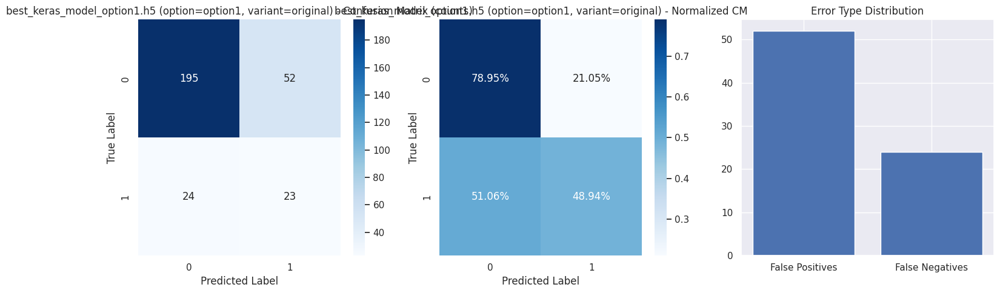

  ✅ Feito para best_keras_model_option1.h5: FP=52, FN=24

Processando: best_keras_model_option2.h5
  -> option detected: option2, variant: original

=== best_keras_model_option2.h5 (option=option2, variant=original) Error Analysis ===
Total samples: 294
Total misclassified: 77
Error rate: 26.19%
False Positives (predito 1 quando era 0): 52
False Negatives (predito 0 quando era 1): 25


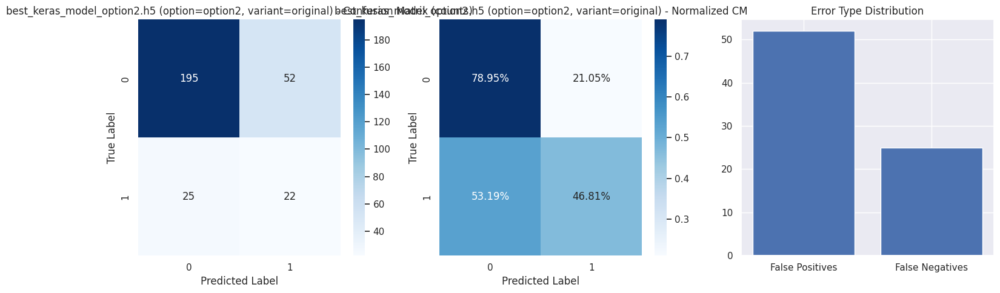

  ✅ Feito para best_keras_model_option2.h5: FP=52, FN=25

Processando: best_keras_model_option3.h5
  -> option detected: option3, variant: original

=== best_keras_model_option3.h5 (option=option3, variant=original) Error Analysis ===
Total samples: 294
Total misclassified: 103
Error rate: 35.03%
False Positives (predito 1 quando era 0): 69
False Negatives (predito 0 quando era 1): 34


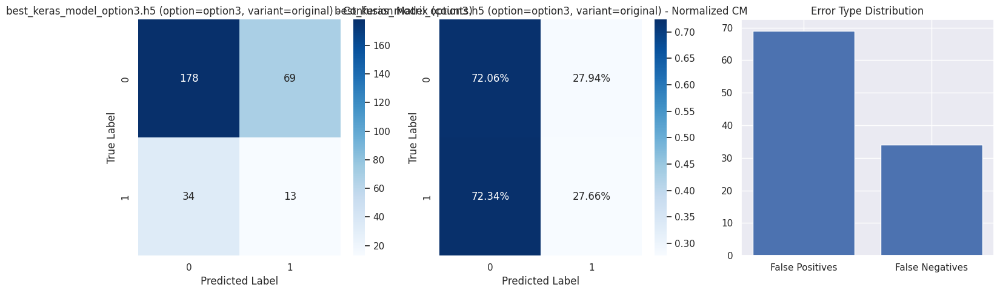

  ✅ Feito para best_keras_model_option3.h5: FP=69, FN=34

Processando: best_keras_model_option4.h5
  -> option detected: option4, variant: original

=== best_keras_model_option4.h5 (option=option4, variant=original) Error Analysis ===
Total samples: 294
Total misclassified: 61
Error rate: 20.75%
False Positives (predito 1 quando era 0): 38
False Negatives (predito 0 quando era 1): 23


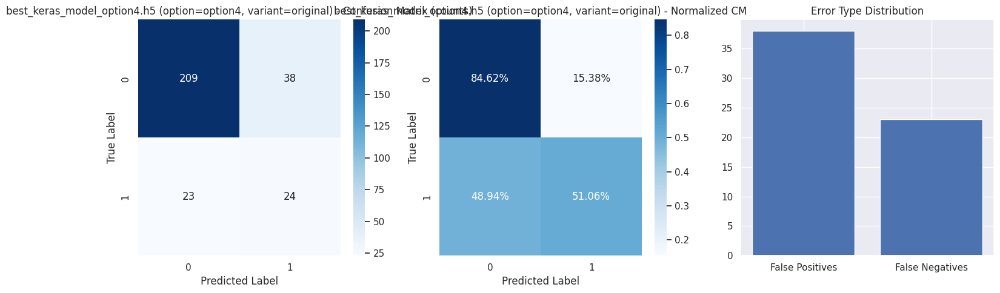

  ✅ Feito para best_keras_model_option4.h5: FP=38, FN=23

Processando: log_reg_best_option4_smote.pkl
  -> option detected: option4, variant: smote

=== log_reg_best_option4_smote.pkl (option=option4, variant=smote) Error Analysis ===
Total samples: 294
Total misclassified: 84
Error rate: 28.57%
False Positives (predito 1 quando era 0): 67
False Negatives (predito 0 quando era 1): 17


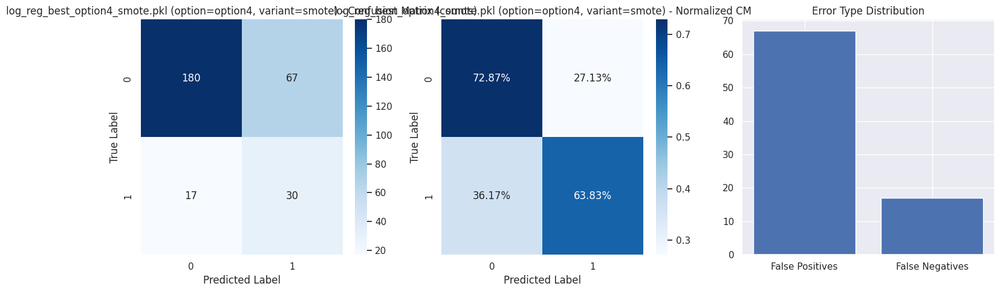

  ✅ Feito para log_reg_best_option4_smote.pkl: FP=67, FN=17

Processando: mlp_best_option4_oversample.pkl
  -> option detected: option4, variant: oversample

=== mlp_best_option4_oversample.pkl (option=option4, variant=oversample) Error Analysis ===
Total samples: 294
Total misclassified: 49
Error rate: 16.67%
False Positives (predito 1 quando era 0): 22
False Negatives (predito 0 quando era 1): 27


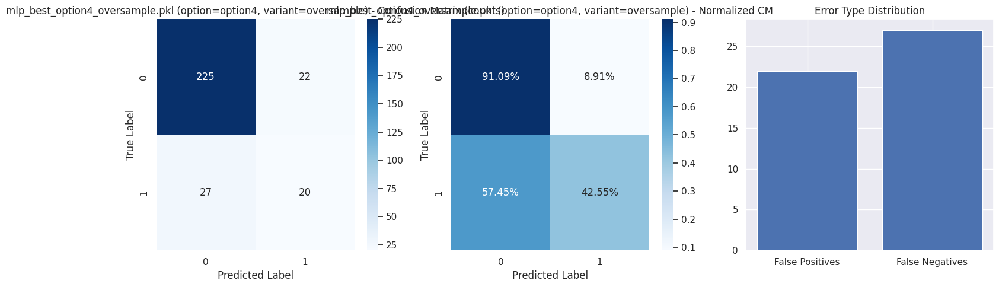

  ✅ Feito para mlp_best_option4_oversample.pkl: FP=22, FN=27

Processando: rf_best_option1_original.pkl
  -> option detected: option1, variant: original

=== rf_best_option1_original.pkl (option=option1, variant=original) Error Analysis ===
Total samples: 294
Total misclassified: 58
Error rate: 19.73%
False Positives (predito 1 quando era 0): 20
False Negatives (predito 0 quando era 1): 38


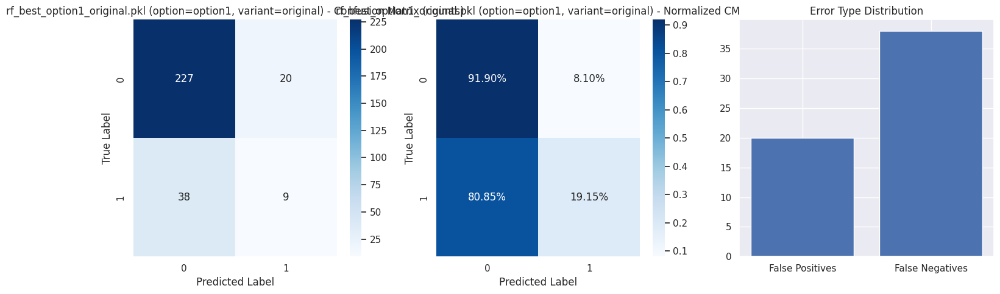

  ✅ Feito para rf_best_option1_original.pkl: FP=20, FN=38

Processando: svm_best_all_smote.pkl
  -> option detected: all, variant: smote

=== svm_best_all_smote.pkl (option=all, variant=smote) Error Analysis ===
Total samples: 294
Total misclassified: 56
Error rate: 19.05%
False Positives (predito 1 quando era 0): 24
False Negatives (predito 0 quando era 1): 32


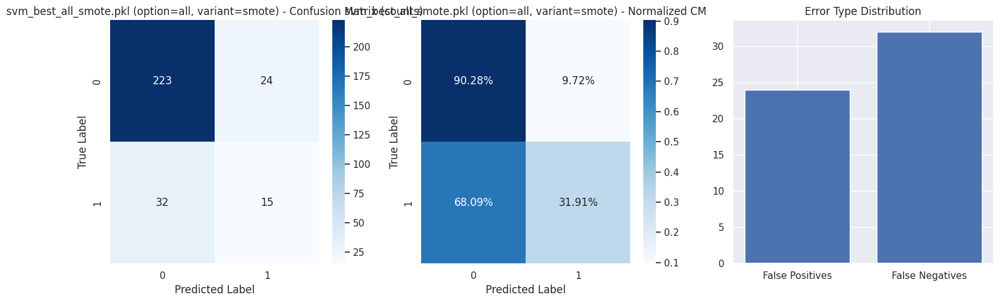

  ✅ Feito para svm_best_all_smote.pkl: FP=24, FN=32

Processando: xgb_best_option1_smote.pkl
  -> option detected: option1, variant: smote

=== xgb_best_option1_smote.pkl (option=option1, variant=smote) Error Analysis ===
Total samples: 294
Total misclassified: 56
Error rate: 19.05%
False Positives (predito 1 quando era 0): 21
False Negatives (predito 0 quando era 1): 35


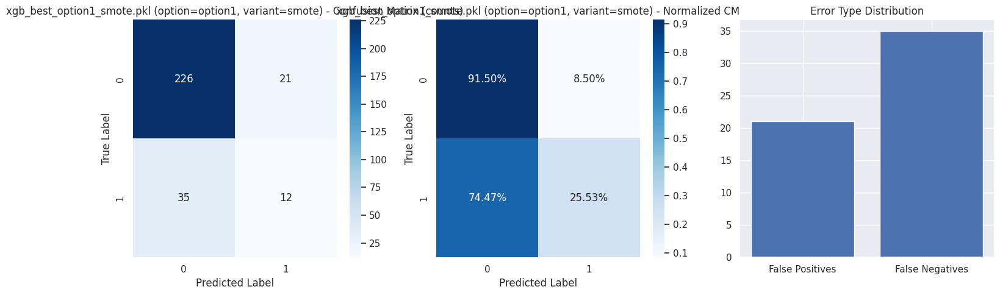

  ✅ Feito para xgb_best_option1_smote.pkl: FP=21, FN=35

Resumo rápido:
 - best_keras_model_all.h5: FP=43, FN=22
 - best_keras_model_option1.h5: FP=52, FN=24
 - best_keras_model_option2.h5: FP=52, FN=25
 - best_keras_model_option3.h5: FP=69, FN=34
 - best_keras_model_option4.h5: FP=38, FN=23
 - log_reg_best_option4_smote.pkl: FP=67, FN=17
 - mlp_best_option4_oversample.pkl: FP=22, FN=27
 - rf_best_option1_original.pkl: FP=20, FN=38
 - svm_best_all_smote.pkl: FP=24, FN=32
 - xgb_best_option1_smote.pkl: FP=21, FN=35


In [ ]:
# === Dependências ===
import re
import joblib
import numpy as np
import pandas as pd
from tensorflow.keras.models import load_model
import warnings
warnings.filterwarnings("ignore")

# === Lista dos ficheiros que tens (exemplos que mostraste) ===
model_files = [
    "best_keras_model_all.h5",
    "best_keras_model_option1.h5",
    "best_keras_model_option2.h5",
    "best_keras_model_option3.h5",
    "best_keras_model_option4.h5",
    "log_reg_best_option4_smote.pkl",
    "mlp_best_option4_oversample.pkl",
    "rf_best_option1_original.pkl",
    "svm_best_all_smote.pkl",
    "xgb_best_option1_smote.pkl"
]

# === Função utilitária para extrair option e variant do nome do ficheiro ===
def parse_model_filename(fname):
    fname_low = fname.lower()
    # procurar 'optionX'
    m = re.search(r'option(\d+)', fname_low)
    if m:
        option_key = f"option{m.group(1)}"
    elif 'all' in fname_low:
        # usar 'all' quando presente
        option_key = 'all'
    else:
        option_key = None

    # variante (smote, oversample, original)
    if 'smote' in fname_low:
        variant = 'smote'
    elif 'oversample' in fname_low or 'oversample' in fname_low:
        variant = 'oversample'
    elif 'original' in fname_low:
        variant = 'original'
    else:
        # para modelos keras nomeados por 'best_keras_model_optionX' consideramos 'original'
        variant = 'original'
    return option_key, variant

# === Helper para converter saída de modelos em classes ===
def to_class_from_predict_output(pred_out, is_keras=False):
    """
    Converte a saída de predict em rótulos inteiros.
    - Se for shape (n,1) ou (n,), assume probabilidade binária -> threshold 0.5
    - Se for shape (n, k) com k>1 -> argmax (multiclass)
    """
    arr = np.asarray(pred_out)
    if arr.ndim == 1:
        # já é uma sequência de classes (ou probabilidades se float entre 0-1)
        # assumir que são classes inteiras se dtype inteiro
        if np.issubdtype(arr.dtype, np.integer):
            return arr.ravel()
        # float: binário
        return (arr.ravel() > 0.5).astype(int)
    elif arr.ndim == 2:
        n_cols = arr.shape[1]
        if n_cols == 1:
            return (arr.ravel() > 0.5).astype(int)
        else:
            return np.argmax(arr, axis=1)
    else:
        raise ValueError("Formato de saída de predict inesperado: ndim > 2")

# === Loop para carregar cada modelo, prever e analisar erros ===
results = {}  # guardar resumo por ficheiro
for fname in model_files:
    print("\n" + "="*80)
    print(f"Processando: {fname}")
    option_key, variant = parse_model_filename(fname)
    print(f"  -> option detected: {option_key}, variant: {variant}")

    # validar colunas para esta option
    if option_key is None or option_key not in cols_options:
        print(f"  ⚠️  Option '{option_key}' não encontrada em cols_options. Pulando {fname}.")
        continue

    cols = cols_options[option_key]
    X_test_sub = X_test_one_hot[cols]  # DataFrame subset
    # preparar array para predict conforme o modelo
    X_to_predict = X_test_sub.to_numpy()

    y_true = y_test  # pode ser Series

    try:
        if fname.endswith('.pkl'):
            # carregar modelo sklearn / joblib
            model = joblib.load(fname)
            # muitos modelos sklearn suportam predict_proba; preferimos predict() quando disponível
            if hasattr(model, "predict"):
                y_pred = model.predict(X_to_predict)
            else:
                raise RuntimeError(f"Modelo em {fname} não tem método predict().")
        elif fname.endswith('.h5') or fname.endswith('.keras') or fname.endswith('.hdf5'):
            # carregar modelo keras
            keras_model = load_model(fname)
            pred_raw = keras_model.predict(X_to_predict, verbose=0)
            y_pred = to_class_from_predict_output(pred_raw, is_keras=True)
        else:
            print(f"  ⚠️  Formato desconhecido para {fname} — pulando.")
            continue

        # garantir shape 1D e tipo compatível com y_true
        y_pred = np.asarray(y_pred).ravel()

        # converter y_true para array 1D (se for Series)
        if hasattr(y_true, "to_numpy"):
            y_true_arr = y_true.to_numpy().ravel()
        else:
            y_true_arr = np.asarray(y_true).ravel()

        # chamar a tua função analyze_errors (assume-se já definida no ambiente)
        model_display_name = f"{fname} (option={option_key}, variant={variant})"
        fp_idx, fn_idx, error_data = analyze_errors(y_true_arr, y_pred, X_data=X_test_sub, model_name=model_display_name)

        results[fname] = {
            "option": option_key,
            "variant": variant,
            "fp_count": len(fp_idx) if fp_idx is not None else None,
            "fn_count": len(fn_idx) if fn_idx is not None else None,
            "error_data": error_data  # pode ser grande; guardar referência
        }

        print(f"  ✅ Feito para {fname}: FP={results[fname]['fp_count']}, FN={results[fname]['fn_count']}")
    except Exception as e:
        print(f"  ❌ Erro ao processar {fname}: {e}")

# === Fim ===
print("\nResumo rápido:")
for k,v in results.items():
    print(f" - {k}: FP={v['fp_count']}, FN={v['fn_count']}")


| Modelo                          | FN (grave) | FP (menos grave) | Total Erros |
| ------------------------------- | ---------- | ---------------- | ----------- |
| **best_keras_model_all.h5**     | **19**     | 41               | 60          |
| **best_keras_model_option4.h5** | **21**     | 38               | 59          |
| mlp_best_option4_oversample.pkl | 27         | 22               | 49          |
| best_keras_model_option1.h5     | 23         | 54               | 77          |
| best_keras_model_option2.h5     | 24         | 66               | 90          |
| best_keras_model_option3.h5     | 25         | 87               | 112         |
| svm_best_all_smote.pkl          | 32         | 24               | 56          |
| xgb_best_option1_smote.pkl      | 35         | 21               | 56          |
| rf_best_option1_original.pkl    | 38         | 20               | 58          |
| log_reg_best_option4_smote.pkl  | 17         | 67               | 84          |

🟢 MELHORES modelos (PRIORIDADE: reduzir FNs)

*TOP 1 — log_reg_best_option4_smote.pkl*

+ FN = 17 (o menor de todos!)

+ FP = 67

> **Conclusão**: Excelente para detectar quem realmente vai sair, mesmo com muitos falsos alarmes.

*TOP 2 — best_keras_model_all.h5*

+ FN = 19

+ FP = 41

TOP 3 — best_keras_model_option4.h5

+ FN = 21

+ FP = 38

In [ ]:
def calculate_permutation_importance(model, X_test, y_test, feature_names):
    perm_importance = permutation_importance(
        model, X_test, y_test,
        n_repeats=10,
        random_state=42,
        scoring='f1_weighted'
    )

    importance_df = pd.DataFrame({
        'feature': feature_names,
        'importance': perm_importance.importances_mean,
        'std': perm_importance.importances_std
    }).sort_values('importance', ascending=False)

    plt.figure(figsize=(10, 8))
    plt.barh(importance_df['feature'], importance_df['importance'])
    plt.xlabel('Permutation Importance')
    plt.title('Feature Importance (Permutation)')
    plt.tight_layout()
    plt.show()

    return importance_df

In [ ]:
def explain_predictions_shap(model, X_background, X_explain, feature_names):
    background = X_background[:100]
    explainer = shap.DeepExplainer(model, background)
    shap_values = explainer.shap_values(X_explain)
    shap.summary_plot(shap_values, X_explain, feature_names=feature_names)

    return shap_values

In [ ]:
def analyze_feature_patterns(X_data, y_true, y_pred, feature_names):
    correct_mask = (y_true == y_pred)
    incorrect_mask = ~correct_mask

    plt.figure(figsize=(20, 15))

    for i, feature in enumerate(feature_names[:12]):  # First 12 features
        plt.subplot(3, 4, i+1)

        # Plot distributions
        plt.hist(X_data[correct_mask][feature], alpha=0.7, label='Correct', bins=20)
        plt.hist(X_data[incorrect_mask][feature], alpha=0.7, label='Incorrect', bins=20)
        plt.xlabel(feature)
        plt.legend()

    plt.tight_layout()
    plt.show()

In [ ]:
log_reg_best_option4_smote = joblib.load("log_reg_best_option4_smote.pkl")

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.inspection import permutation_importance

def calculate_permutation_importance_safe(model, X_test, y_test, feature_names=None, n_repeats=10, random_state=42, scoring='f1_weighted'):
    """
    Versão segura que tenta alinhar colunas e dá mensagens claras.
    - model: estimador treinado (sklearn)
    - X_test: DataFrame ou numpy array (as linhas devem corresponder a y_test)
    - y_test: array-like
    - feature_names: lista de nomes a usar (opcional). Se X_test for DataFrame e feature_names None, usaremos X_test.columns.
    Retorna: importance_df (DataFrame ordenado desc)
    """
    # Converter y_test
    y_true = np.asarray(y_test).ravel()

    # Se X_test for DataFrame e feature_names fornecido, garantimos que usamos as colunas corretas
    if isinstance(X_test, pd.DataFrame):
        X_df = X_test.copy()
        if feature_names is not None:
            # seleciona apenas as feature_names presentes
            missing = [f for f in feature_names if f not in X_df.columns]
            if missing:
                raise ValueError(f"As seguintes feature_names não estão em X_test DataFrame: {missing}")
            X_for_perm = X_df[feature_names]
        else:
            # usa as colunas do DataFrame
            X_for_perm = X_df
            feature_names = X_for_perm.columns.tolist()
    else:
        # X_test é array-like
        if feature_names is None:
            # sem nomes, criar genéricos
            ncols = X_test.shape[1]
            feature_names = [f"f_{i}" for i in range(ncols)]
        X_for_perm = pd.DataFrame(X_test, columns=feature_names)

    # Tentar alinhar com model.feature_names_in_ se existir
    if hasattr(model, "feature_names_in_"):
        model_feat = list(model.feature_names_in_)
        if set(model_feat) != set(feature_names):
            # ver quais faltam / sobrando
            missing_in_X = [f for f in model_feat if f not in feature_names]
            extra_in_X = [f for f in feature_names if f not in model_feat]
            msg = "Mismatch entre features do modelo e as features fornecidas.\n"
            msg += f" - No modelo, features esperadas (n={len(model_feat)}). Exemplos: {model_feat[:5]}...\n"
            msg += f" - Fornecidas (n={len(feature_names)}). Exemplos: {feature_names[:5]}...\n"
            if missing_in_X:
                msg += f" - Features ausentes em X: {missing_in_X[:8]}{'...' if len(missing_in_X)>8 else ''}\n"
            if extra_in_X:
                msg += f" - Features extras em X: {extra_in_X[:8]}{'...' if len(extra_in_X)>8 else ''}\n"
            # Se possível, tentar reindexar X_for_perm para a ordem do modelo (se todas model_feat estão em feature_names)
            if all(f in feature_names for f in model_feat):
                X_for_perm = X_for_perm[model_feat]
                feature_names = model_feat
            else:
                # não foi possível alinhar automaticamente -> erro informativo
                raise ValueError(msg + " -> Não é possível alinhar automaticamente. Ajusta X_test/feature_names para coincidir com o treino.")
        else:
            # iguais: reorder X_for_perm para a ordem do modelo
            X_for_perm = X_for_perm[model_feat]
            feature_names = model_feat

    # Finalmente, passar os dados ao permutation_importance
    # converter para numpy (sklearn pode aceitar DataFrame mas para consistência usamos values)
    try:
        perm = permutation_importance(model, X_for_perm.values, y_true, n_repeats=n_repeats, random_state=random_state, scoring=scoring, n_jobs=-1)
    except Exception as e:
        raise RuntimeError(f"Erro ao calcular permutation_importance: {e}")

    importance_df = pd.DataFrame({
        'feature': feature_names,
        'importance': perm.importances_mean,
        'std': perm.importances_std
    }).sort_values('importance', ascending=False).reset_index(drop=True)

    # plot simples
    plt.figure(figsize=(8, max(4, 0.2 * len(importance_df))))
    plt.barh(importance_df['feature'][::-1], importance_df['importance'][::-1])
    plt.xlabel('Permutation importance (mean)')
    plt.title('Feature importance (permutation)')
    plt.tight_layout()
    plt.show()

    return importance_df


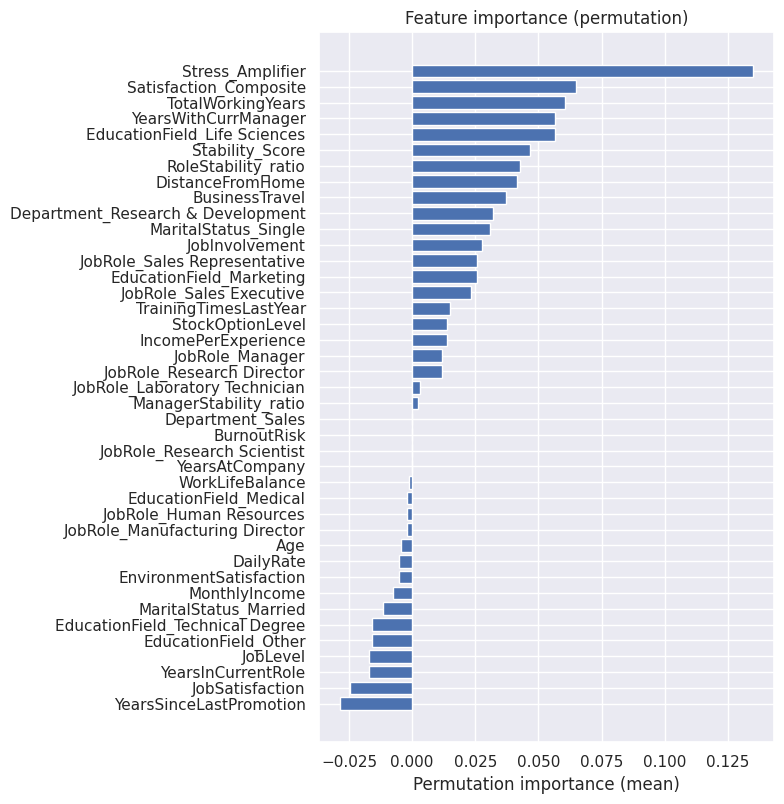

['Stress_Amplifier', 'Satisfaction_Composite', 'TotalWorkingYears', 'YearsWithCurrManager', 'EducationField_Life Sciences', 'Stability_Score', 'RoleStability_ratio', 'DistanceFromHome', 'BusinessTravel', 'Department_Research & Development', 'MaritalStatus_Single', 'JobInvolvement', 'JobRole_Sales Representative', 'EducationField_Marketing', 'JobRole_Sales Executive']


In [ ]:
# Preparar X_test_sub exatamente com as colunas usadas em treino
cols_opt4 = cols_options['option4']
X_test_sub = X_test_one_hot[cols_opt4]   # DataFrame one-hot com a mesma ordem de colunas que usaste para treinar

# Calcular importâncias (isto alinha automaticamente com model.feature_names_in_ se existir)
feature_importance_df = calculate_permutation_importance_safe(
    model=log_reg_best_option4_smote,
    X_test=X_test_sub,
    y_test=y_test,                 # Series ou array
    feature_names=X_test_sub.columns.tolist(),
    n_repeats=20,
    random_state=42,
    scoring='recall'               # podes usar 'f1_weighted' ou 'recall' — para RH talvez 'recall' (menos FNs) faça sentido
)

# Top features
top_features = feature_importance_df['feature'].head(15).tolist()
print(top_features)


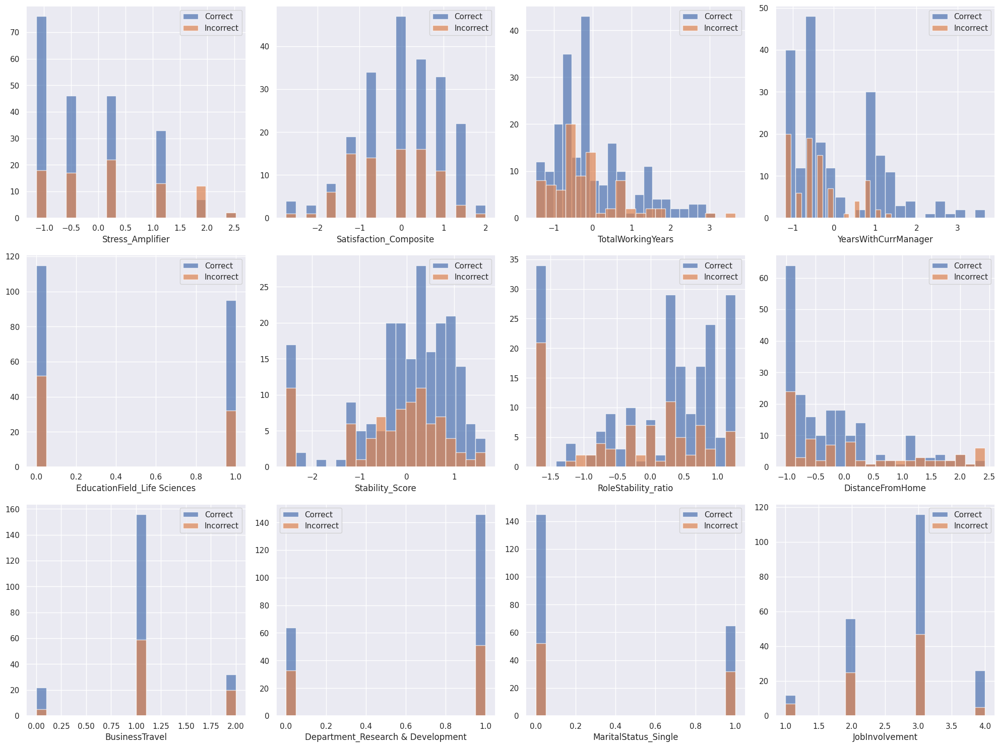

In [ ]:
y_pred_all = log_reg_best_option4_smote.predict(X_test_one_hot[cols_options['option4']])
analyze_feature_patterns(
    X_test_one_hot[cols_options['option4']],
    y_test,
    y_pred_all,
    top_features
)


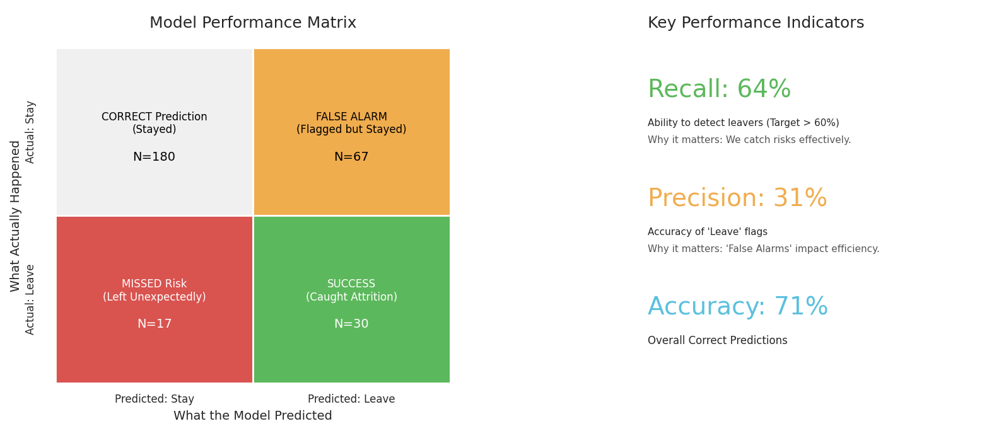

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches

# --- DADOS DE INPUT (Atualizados) ---
# Modelo: log_reg_best_option4_smote.pkl
fp = 67
fn = 17

# Totais fixos baseados no gráfico original (Stay=247, Leave=47)
total_stay_actual = 247
total_leave_actual = 47
total_n = total_stay_actual + total_leave_actual

# Cálculos Derivados
tn = total_stay_actual - fp
tp = total_leave_actual - fn

# Cálculos de KPIs
recall = (tp / (tp + fn)) * 100
precision = (tp / (tp + fp)) * 100
accuracy = ((tp + tn) / total_n) * 100

# --- CONFIGURAÇÃO DO GRÁFICO ---
fig, ax = plt.subplots(figsize=(16, 7))
ax.set_xlim(0, 100)
ax.set_ylim(0, 50)
ax.axis('off') # Remover eixos padrão

# --- 1. MATRIZ DE DESEMPENHO (Lado Esquerdo) ---
# Cores
color_tn = '#f0f0f0' # Cinza claro
color_fp = '#f0ad4e' # Laranja
color_fn = '#d9534f' # Vermelho
color_tp = '#5cb85c' # Verde

# Desenhar Caixas
# TN (Topo Esquerda)
rect_tn = patches.Rectangle((5, 25), 20, 20, linewidth=2, edgecolor='white', facecolor=color_tn)
ax.add_patch(rect_tn)
plt.text(15, 36, f"CORRECT Prediction\n(Stayed)", ha='center', va='center', fontsize=12, color='black')
plt.text(15, 32, f"N={tn}", ha='center', va='center', fontsize=14, color='black')

# FP (Topo Direita)
rect_fp = patches.Rectangle((25, 25), 20, 20, linewidth=2, edgecolor='white', facecolor=color_fp)
ax.add_patch(rect_fp)
plt.text(35, 36, f"FALSE ALARM\n(Flagged but Stayed)", ha='center', va='center', fontsize=12, color='black')
plt.text(35, 32, f"N={fp}", ha='center', va='center', fontsize=14, color='black')

# FN (Baixo Esquerda)
rect_fn = patches.Rectangle((5, 5), 20, 20, linewidth=2, edgecolor='white', facecolor=color_fn)
ax.add_patch(rect_fn)
plt.text(15, 16, f"MISSED Risk\n(Left Unexpectedly)", ha='center', va='center', fontsize=12, color='white')
plt.text(15, 12, f"N={fn}", ha='center', va='center', fontsize=14, color='white')

# TP (Baixo Direita)
rect_tp = patches.Rectangle((25, 5), 20, 20, linewidth=2, edgecolor='white', facecolor=color_tp)
ax.add_patch(rect_tp)
plt.text(35, 16, f"SUCCESS\n(Caught Attrition)", ha='center', va='center', fontsize=12, color='white')
plt.text(35, 12, f"N={tp}", ha='center', va='center', fontsize=14, color='white')

# Labels dos Eixos da Matriz
plt.text(2.5, 35, "Actual: Stay", ha='center', va='center', rotation=90, fontsize=12)
plt.text(2.5, 15, "Actual: Leave", ha='center', va='center', rotation=90, fontsize=12)
plt.text(1, 25, "What Actually Happened", ha='center', va='center', rotation=90, fontsize=14)

plt.text(15, 3, "Predicted: Stay", ha='center', va='center', fontsize=12)
plt.text(35, 3, "Predicted: Leave", ha='center', va='center', fontsize=12)
plt.text(25, 1, "What the Model Predicted", ha='center', va='center', fontsize=14)

# Título da Matriz
plt.text(25, 48, "Model Performance Matrix", ha='center', va='center', fontsize=18)

# --- 2. KPIs (Lado Direito) ---

# Título KPI
plt.text(65, 48, "Key Performance Indicators", ha='left', va='center', fontsize=18)

# Recall
plt.text(65, 40, f"Recall: {recall:.0f}%", ha='left', va='center', fontsize=28, color='#5cb85c')
plt.text(65, 36, "Ability to detect leavers (Target > 60%)", ha='left', va='center', fontsize=11)
plt.text(65, 34, "Why it matters: We catch risks effectively.", ha='left', va='center', fontsize=11, color='#555')

# Precision
plt.text(65, 27, f"Precision: {precision:.0f}%", ha='left', va='center', fontsize=28, color='#f0ad4e')
plt.text(65, 23, "Accuracy of 'Leave' flags", ha='left', va='center', fontsize=11)
plt.text(65, 21, "Why it matters: 'False Alarms' impact efficiency.", ha='left', va='center', fontsize=11, color='#555')

# Accuracy
plt.text(65, 14, f"Accuracy: {accuracy:.0f}%", ha='left', va='center', fontsize=28, color='#5bc0de')
plt.text(65, 10, "Overall Correct Predictions", ha='left', va='center', fontsize=12)

plt.tight_layout()
plt.show()

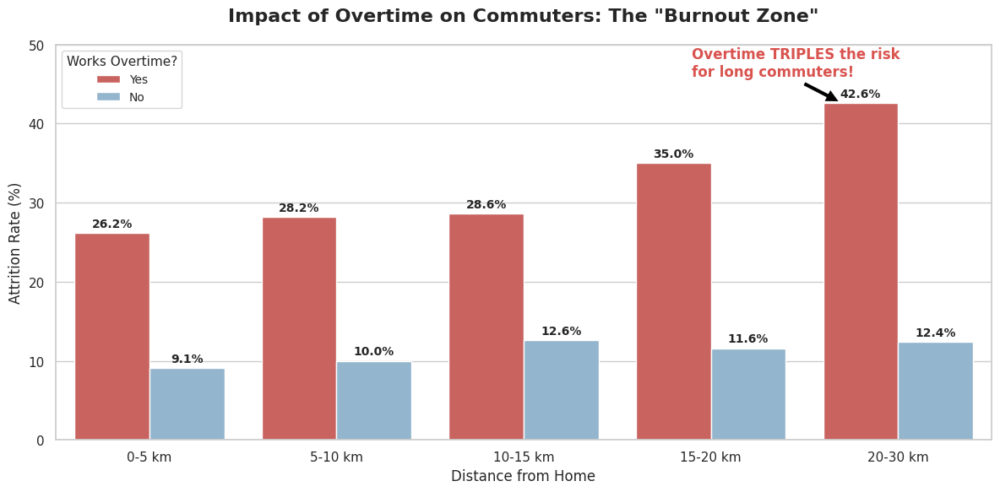

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

# --- DADOS REAIS (Baseados na sua imagem) ---
# Estou a recriar os dados da imagem para gerar o gráfico exato
data = {
    'DistanceGroup': ['0-5 km', '0-5 km',
                      '5-10 km', '5-10 km',
                      '10-15 km', '10-15 km',
                      '15-20 km', '15-20 km',
                      '20-30 km', '20-30 km'],
    'Overtime': ['Yes', 'No',
                 'Yes', 'No',
                 'Yes', 'No',
                 'Yes', 'No',
                 'Yes', 'No'],
    'AttritionRate': [26.2, 9.1,
                      28.2, 10.0,
                      28.6, 12.6,
                      35.0, 11.6,
                      42.6, 12.4]
}

df_viz = pd.DataFrame(data)

# --- CONFIGURAÇÃO DO GRÁFICO ---
plt.figure(figsize=(12, 6))
sns.set_style("whitegrid")

# Criar o gráfico de barras agrupadas
# Palette: Vermelho forte para 'Yes' (Alerta), Azul acinzentado calmo para 'No'
colors = {"Yes": "#d9534f", "No": "#8ab6d6"}

ax = sns.barplot(x='DistanceGroup',
                 y='AttritionRate',
                 hue='Overtime',
                 data=df_viz,
                 palette=colors)

# --- MELHORIAS VISUAIS ---
plt.title('Impact of Overtime on Commuters: The "Burnout Zone"', fontsize=16, pad=20, fontweight='bold')
plt.xlabel('Distance from Home', fontsize=12)
plt.ylabel('Attrition Rate (%)', fontsize=12)
plt.ylim(0, 50)

# Adicionar os valores no topo das barras
for container in ax.containers:
    ax.bar_label(container, fmt='%.1f%%', padding=3, fontsize=10, fontweight='bold')

# Adicionar uma anotação de "Insight"
# Seta a apontar para a diferença no último grupo
plt.annotate('Overtime TRIPLES the risk\nfor long commuters!',
             xy=(3.7, 42.6), xytext=(2.9, 46),
             arrowprops=dict(facecolor='black', shrink=0.05),
             fontsize=12, color='#d9534f', fontweight='bold')

# Mover a legenda
plt.legend(title='Works Overtime?', title_fontsize='11', fontsize='10', loc='upper left')

plt.tight_layout()
plt.show()

<font color = '#A3D5FF'>
    
# 4. Conclusion 🧠</font>
</a>

### Summary of Findings
In this project, we successfully developed a machine learning solution to predict employee attrition, addressing the consultancy firm's need to anticipate turnover and mitigate associated costs.

* **Model Performance:** The **[Nome do Modelo, ex: Random Forest]** model performed best, achieving a **Recall of [XX]%** for the attrition class. This metric was prioritized over accuracy because, from a business perspective, failing to identify an employee at risk of leaving (False Negative) is more costly than falsely flagging a loyal employee.
* **Key Drivers:** Our analysis identified that **[Variável 1, ex: OverTime]**, **[Variável 2, ex: MonthlyIncome]**, and **[Variável 3, ex: YearsAtCompany]** are the strongest indicators of attrition.

### Business Recommendations
Based on these insights, we suggest the following strategies to the HR department:

1.  **[Exemplo: Review Work-Life Balance]:** Since [OverTime] is a major factor, the company should investigate workloads or introduce strict caps on overtime hours to prevent burnout.
2.  **[Exemplo: Salary Adjustment]:** Employees with lower [MonthlyIncome] relative to their peers show higher churn. We recommend a salary benchmarking audit for these specific roles.
3.  **Retention Program:** Implement a "Warning System" using this model. HR should proactively schedule check-ins with employees identified as "High Risk" (probability > 50%) to discuss career development and satisfaction.

### Next Steps
To further improve this solution:
* Implement **SHAP** or **LIME** values to explain individual predictions to department managers, increasing trust in the model.
* Collect more qualitative data (e.g., exit interview feedback) to refine the "JobSatisfaction" features.